# A reinforcement learning approach to improve the performance of the Avellaneda-Stoikov market making algorithm

This paper presents a new approach to market making using deep reinforcement learning that is able to perform better than the benchmarks on different metrics of performance and inventory management.
Our main contributions will be a different approach to the agent actions that will configure the agent behavior based on the Avellaneda-Stoikov algorithm.
Another contribution is going to be how our benchmark is being genetically optimized on the test periods.
The last one will be how we reduce the number of states of the reinforcement learning algorithm using Feature importance.
Our high frequency trading simulator using L2 tick data and algorithms are openly accessible on a GitHub repository [1].
We are going to use real data to simulate and test our strategies on 30 days period.
The first day will be reserved for initial training and parameter tuning on the benchmark, the next 30 days will be used to show results.
During testing every 5 complete days , one of the benchmark algorithms is going to be optimized.


In [1]:
%matplotlib inline
!git pull
# import os;os.environ['LAMBDA_PARQUET_TICK_DB']=rf'X:\\'
session_name='CryptoMM'
import time
import datetime
import tqdm
import seaborn as sns
sns.set_theme()

Already up to date.


# Index:
* [Algorithm configuration](#algo_configuration)
* [Backtest configuration](#backtest_configuration)
* [Genetic Algorithm Parameter Tuning Benchmarks](#parameter_tuning)
* [Train DQN](#train)
    * [Memory Replay](#memory)
* [Test](#test)
* [Results](#results)
  * [Ratios](#ratios)
    * [Sharpe](#sharpe)
    * [Sortino](#sortino)
    * [Pnl Map](#pnl_map)
    * [Max Drawdown](#dd)

## Algorithm configuration <a class="anchor" id="algo_configuration)"></a>

In [2]:
start=time.time()
start_notebook=time.time()
from notebooks.lambda_imports import *
plt.style.use('seaborn')

# dill.load_session(session_name)


TRAIN_DQN=False
TRAIN_DQN_LSTM=False

clean_initial_experience=False
clean_initial_experience_LSTM=False

#experiments configuration
INCLUDE_RNN=False
VS_MULTIPLES_AS=False

DEBUG=False
PLOT_CANDLES=False
PARAMETER_TUNING_BENCHMARK_INITIAL=False
PARAMETER_TUNING_BENCHMARK_INITIAL_WITH_BEST=False#small fine tuning
PARAMETER_TUNING_BENCHMARK=False


CALCULATE_Tt=False
TEST_EXPLORE_PROB=0.01
TEST_ITERATION_PREDICT_PERIOD_TRAIN = IterationsPeriodTime.FOUR_HOURS#train at the end of session to avoid losing testing time
TEST_ITERATION_TARGET_PERIOD_TRAIN = IterationsPeriodTime.END_OF_SESSION#train at the end of session to avoid losing testing time

elapsed = time.time()-start

PROJECT_PATH=E:\javif\Coding\Python\market_making_fw\python_lambda
BACKTEST_OUTPUT_PATH(LAMBDA_OUTPUT_PATH)=X:\output_models
BACKTEST_TEMP_PATH(LAMBDA_TEMP_PATH)=E:\javif\Coding\Python\market_making_fw\java\temp
BACKTEST_JAR_PATH(LAMBDA_JAR_PATH)=E:\javif\Coding\Python\market_making_fw\java\executables\Backtest\target\Backtest.jar
log_path(LAMBDA_LOGS_PATH)=E:\javif\Coding\Python\market_making_fw\python_lambda\logs
PARQUET_PATH_DB(LAMBDA_PARQUET_TICK_DB)=X:\


In [3]:
seed_number=28220
np.random.seed(seed_number)
import random
random.seed(seed_number)

In [4]:
DEBUG

False

In [5]:
FIRST_HOUR=7.0
LAST_HOUR=19.0

QUANTITY=0.0001
POSITION_MULITPLIER_BASE=1.0
timeHorizonSecondsDQN=15

In [6]:
testing_days=30


start_date_experiment=datetime.datetime(year=2022,month=1,day=24)#datetime.datetime.today()
start_date_experiment = start_date_experiment.replace(hour=0, minute=0,second=0,microsecond=0)
start_date_experiment

datetime.datetime(2022, 1, 24, 0, 0)

In [7]:
def get_time(reference_date,business_days,hour):
    from pandas.tseries.offsets import BDay
#     date=(reference_date-BDay(business_days))
    date=reference_date-datetime.timedelta(days = business_days)
    return datetime.datetime.fromtimestamp(date.timestamp()).replace(hour=hour, minute=0,second=0,microsecond=0)


In [8]:
if not CALCULATE_Tt:
    calculateTt=0
else:
    calculateTt=1

AS_parameters_min = {"risk_aversion":0.01,'window_tick':5,'minutes_change_k': 1.0,'spread_multiplier':0.75,'position_multiplier':0.75,'k_default':-1,'calculateTt':calculateTt}
AS_parameters_max = {"risk_aversion":0.9, 'window_tick':25,'minutes_change_k': 10.0,'spread_multiplier':5.0,'position_multiplier':500.0,'k_default':-1 ,'calculateTt':calculateTt}
#    parameters_min = {"risk_aversion":0.01,'window_tick':5,'k_default':0.01 ,'spread_multiplier':0.75}
#     parameters_max = {"risk_aversion":0.9, 'window_tick':25,'k_default':2. ,'spread_multiplier':2.}

In [9]:
#from feature importance
# most_significant_state_columns=[
# 'ask_price_0',
#  'ask_price_7',
#  'ask_price_9',
#  'ask_qty_0',
#  'ask_qty_6',
#  'ask_qty_9',
#  'bid_price_0',
#  'bid_price_7',
#  'bid_price_9',
#  'bid_qty_0',
#  'bid_qty_7',
#  'high_1',
#  'last_close_price_1',
#  'last_close_price_2',
#  'last_close_price_5',
#  'last_close_price_6',
#  'last_close_price_9',
#  'last_close_qty_0',
#  'microprice_0',
#  'microprice_5',
#  'microprice_6',
#  'microprice_9',
#  'midprice_0',
#  'midprice_2',
#  'midprice_3',
#  'midprice_4',
#  'midprice_5',
#  'midprice_7',
#  'midprice_8',
#  'spread_0',
#  'spread_7',
#  'spread_9'
# ]
most_significant_state_columns=[]

## Backtest Configuration<a class="anchor" id="backtest_configuration"></a>

In [10]:
instrument_pk='btcusdt_binance'

# start_date_train=datetime.datetime(year=2022, day=8, month=1,hour=int(FIRST_HOUR-1))#datetime.datetime(year=2020, day=8, month=12,hour=int(FIRST_HOUR-1))
# end_date_train=datetime.datetime(year=2022, day=8, month=1,hour=int(LAST_HOUR+1))

start_date_train=get_time(start_date_experiment,testing_days+2,int(FIRST_HOUR-1))#datetime.datetime(year=2021, day=6, month=9,hour=0)
end_date_train=get_time(start_date_experiment,testing_days+2,int(LAST_HOUR+1))#datetime.datetime(year=2021, day=6, month=9,hour=23)
start_date_train

datetime.datetime(2021, 12, 23, 6, 0)

In [11]:
def parameter_tuning_benchmark(benchmark_algorithm,start_date,end_date,best_parameter_tuning_dict=None):
    parameters_min = AS_parameters_min
    parameters_max = AS_parameters_max
    
    
    ga_configuration = GAConfiguration
#     ga_configuration.score_column=ScoreEnum.falcma_ratio#falces marin ratio
    
    if DEBUG:
        ga_configuration.population = 15
        ga_configuration_generations=3
        ga_configuration_simultaneous=15
    else:
        ga_configuration.population = 30
        ga_configuration_generations=15
        ga_configuration_simultaneous=15
        
    if best_parameter_tuning_dict is not None:
        ga_configuration.population = 25
        ga_configuration_generations=5
        ga_configuration_simultaneous=25
#         pct_moving=0.2
#         min_pct=1-pct_moving
#         max_pct=1+pct_moving
#         parameters_min = {"risk_aversion":best_parameter_tuning_dict["risk_aversion"]*min_pct,'window_tick':int(best_parameter_tuning_dict["window_tick"]*min_pct),'k_default':best_parameter_tuning_dict["k_default"]*min_pct ,'spread_multiplier':best_parameter_tuning_dict["spread_multiplier"]*min_pct}
#         parameters_max = {"risk_aversion":best_parameter_tuning_dict["risk_aversion"]*max_pct,'window_tick':int(best_parameter_tuning_dict["window_tick"]*max_pct),'k_default':best_parameter_tuning_dict["k_default"]*max_pct ,'spread_multiplier':best_parameter_tuning_dict["spread_multiplier"]*max_pct}
        
        
#     ga_configuration.decay is going to be exponential sigma
    ga_configuration.crossover_prob=0.6
    
    best_param_dict, summary_df =benchmark_algorithm.parameter_tuning(
        instrument_pk=instrument_pk,
        start_date=start_date,
        end_date=end_date,
        parameters_min=parameters_min,
        parameters_max=parameters_max,
        generations=ga_configuration_generations,
        ga_configuration=ga_configuration,
        max_simultaneous=ga_configuration_simultaneous
    )
    benchmark_algorithm.set_parameters(best_param_dict)
    return benchmark_algorithm,best_param_dict

def get_final_metrics(output_test,ratios_column='historicalRealizedPnl')->dict:
    key=list(output_test.keys())[0]
    df = output_test[key]
    
    open_pnl=df['historicalTotalPnl'].iloc[-1]
    close_pnl=df['historicalRealizedPnl'].iloc[-1]
    trades=df['numberTrades'].iloc[-1]
    
    #ratios
#     ratios_column = 'historicalTotalPnl'
    sharpe = get_sharpe(df[ratios_column])
    sortino = get_sortino(df[ratios_column])
    max_dd = get_max_drawdown(df[ratios_column])
    pnl_map = get_pnl_to_map(df['historicalTotalPnl'],df['netPosition'])
    
    
    results_dict = {
        "open_pnl":open_pnl,
        "close_pnl":close_pnl,
        "number_trades":trades,
        
        "sharpe":sharpe,
        "sortino":sortino,
        "max_drawdown":max_dd,
        "pnl_map":pnl_map
    }
    print(f'{key}  -> open_pnl:{open_pnl}  close_pnl:{close_pnl}  number_trades:{trades}  sharpe:{sharpe}   sortino:{sortino}  max_dd:{max_dd}  pnl_map:{pnl_map}   ')
    return results_dict
    
    

In [12]:
# constant spreads benchmarks
parameters_default_constant = {
    "quantity_limit": (QUANTITY*10),
    "quantity": (QUANTITY),
    "first_hour": (FIRST_HOUR),
    "last_hour": (LAST_HOUR),
    "level":(1),
    "seed":seed_number,
}
algorithm_info_constant='constant_spread'
benchmark_constant_spread = ConstantSpread(algorithm_info=algorithm_info_constant,parameters=parameters_default_constant)

algorithm_info_linear_constant='linear_constant_spread'
benchmark_linear_constant_spread = LinearConstantSpread(algorithm_info=algorithm_info_linear_constant,parameters=parameters_default_constant)

benchmark_constant_spread_train = benchmark_constant_spread.test(
        instrument_pk=instrument_pk,
        start_date=start_date_train,
        end_date=end_date_train,
    )
get_final_metrics(benchmark_constant_spread_train)            

benchmark_linear_constant_spread_train = benchmark_linear_constant_spread.test(
        instrument_pk=instrument_pk,
        start_date=start_date_train,
        end_date=end_date_train,
    )

get_final_metrics(benchmark_linear_constant_spread_train)            


# AVELLANEDA STOIKOV - BENCHMARK
parameters_default_as = {
    # Avellaneda default
    "risk_aversion": (0.9),

    "window_tick": (25),
    "minutes_change_k": (1),
    "quantity": (QUANTITY),
    "first_hour": (FIRST_HOUR),
    "last_hour": (LAST_HOUR),
    
    "k_default": (-1),    
    "position_multiplier": POSITION_MULITPLIER_BASE,
    "spread_multiplier": (1.0),
    "seed":seed_number,
}
if not CALCULATE_Tt:
    parameters_default_as["calculateTt"]=0

algorithm_info_as='avellaneda_stoikov'
benchmark = AvellanedaStoikov(algorithm_info=algorithm_info_as,parameters=parameters_default_as)
print(f'AvellanedaStoikov with params {parameters_default_as}')
#### before results
benchmark_before_pt = benchmark.test(
        instrument_pk=instrument_pk,
        start_date=start_date_train,
        end_date=end_date_train,
    )
get_final_metrics(benchmark_before_pt)    


pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 75702 trades
ConstantSpread_constant_spread  -> open_pnl:-214.1840425914779  close_pnl:-214.41697095025646  number_trades:57699  sharpe:-0.10237689415755902   sortino:-0.11612612385402986  max_dd:214.41777295025645  pnl_map:-359170.1199346982   
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 18783 trades
LinearConstantSpread_linear_constant_spread  -> open_pnl:-318.95612903654666  close_pnl:-318.79732579345836  number_trades:18027  sharpe:-0.304104411355936   sortino:-0.30489031742525613  max_dd:318.79732579345836  pnl_map:-1279366.7533214083   
AvellanedaStoikov with params {'risk_aversion': 0.9, 'window_tick': 25, 'minutes_change_k': 1, 'quantity': 0.0001, 'first_hour': 7.0, 'last_hour': 19

{'open_pnl': -26.53270952465732,
 'close_pnl': -22.96048784199952,
 'number_trades': 1484,
 'sharpe': -0.26826414199760934,
 'sortino': -0.25947077533034196,
 'max_drawdown': 22.96246720399952,
 'pnl_map': -29088.638848101025}

## Genetic Algorithm Parameter Tuning Benchmarks <a class="anchor" id="parameter_tuning"></a>

In [13]:
#from parameter tuning -> wil lbe used if PARAMETER_TUNING_BENCHMARK_INITIAL is False
best_avellaneda_param_dict={
    'risk_aversion':  0.0166133089,
     'window_tick': 9.5055,
     'minutes_change_k': 1.0,#with k_default!=-1 doesn't make sense
    
     'quantity': QUANTITY,
     'k_default': -1.0,
    
     'position_multiplier': 13.8037,
     'spread_multiplier': 3.805,
     'first_hour': FIRST_HOUR,
     'last_hour': LAST_HOUR,
     "seed":seed_number,
}
# value
# {'risk_aversion': 0.016613308954237536,
#  'window_tick': 9.505509704548302,
#  'quantity': 0.00010000000000000002,
#  'first_hour': 7.0,
#  'last_hour': 19.0,
#  'calculateTt': 0.0,
#  'minutes_change_k': 8.219138702315686,
#  'k_default': -1.0,
#  'position_multiplier': 13.80373960038073,
#  'spread_multiplier': 3.8054849948977276}

if not CALCULATE_Tt:
    best_avellaneda_param_dict["calculateTt"]=0


In [14]:
if PARAMETER_TUNING_BENCHMARK_INITIAL:
    print('launching parameter tuning ')
    benchmark,best_avellaneda_param_dict=parameter_tuning_benchmark(benchmark,start_date=start_date_train,end_date=end_date_train)
    print(f'finished parameter tuning with score {best_avellaneda_param_dict}')
elif PARAMETER_TUNING_BENCHMARK_INITIAL_WITH_BEST:
    print('launching parameter tuning with best dict ')
    benchmark,best_avellaneda_param_dict=parameter_tuning_benchmark(benchmark,start_date=start_date_train,end_date=end_date_train,best_parameter_tuning_dict=best_avellaneda_param_dict)
    print(f'finished parameter tuning with score {best_avellaneda_param_dict}')    
else:
    print(f'Parameter tuning loaded with params {best_avellaneda_param_dict}')
print(f'AvellanedaStoikov with params {best_avellaneda_param_dict}')
benchmark.set_parameters(best_avellaneda_param_dict)

Parameter tuning loaded with params {'risk_aversion': 0.0166133089, 'window_tick': 9.5055, 'minutes_change_k': 1.0, 'quantity': 0.0001, 'k_default': -1.0, 'position_multiplier': 13.8037, 'spread_multiplier': 3.805, 'first_hour': 7.0, 'last_hour': 19.0, 'seed': 28220, 'calculateTt': 0}
AvellanedaStoikov with params {'risk_aversion': 0.0166133089, 'window_tick': 9.5055, 'minutes_change_k': 1.0, 'quantity': 0.0001, 'k_default': -1.0, 'position_multiplier': 13.8037, 'spread_multiplier': 3.805, 'first_hour': 7.0, 'last_hour': 19.0, 'seed': 28220, 'calculateTt': 0}


In [15]:
# benchmark.set_parameters(best_avellaneda_param_dict)
best_avellaneda_param_dict

{'risk_aversion': 0.0166133089,
 'window_tick': 9.5055,
 'minutes_change_k': 1.0,
 'quantity': 0.0001,
 'k_default': -1.0,
 'position_multiplier': 13.8037,
 'spread_multiplier': 3.805,
 'first_hour': 7.0,
 'last_hour': 19.0,
 'seed': 28220,
 'calculateTt': 0}

In [16]:
#set actions based on best params benchmark
# skewPricePctAction= [0.,0.05,-0.05,-0.1,0.1]
skewPricePctAction=[0.]
best_risk_aversion=best_avellaneda_param_dict['risk_aversion']
best_window_tick=int(best_avellaneda_param_dict['window_tick'])
# riskAversionAction=[max(min(best_risk_aversion/10,1.0),0.01),best_risk_aversion,max(min(best_risk_aversion*1.25,1.0),0.01),max(min(best_risk_aversion*1.5,1.0),0.01)] # [0.01,.1,0.2,0.9]#
riskAversionAction= [0.5, 0.01, 0.05,0.1,0.25]#list(set([0.01,best_risk_aversion/2,best_risk_aversion,0.9]))
windowsTickAction = list(set([int(best_window_tick),int(best_window_tick/2),int(best_window_tick*2)]))#[best_avellaneda_param_dict['window_tick']]

In [17]:
benchmark_after_pt=benchmark.test(
        instrument_pk=instrument_pk,
        start_date=start_date_train,
        end_date=end_date_train,
    )
get_final_metrics(benchmark_after_pt)   

pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov_0 with 13196 trades
AvellanedaStoikov_avellaneda_stoikov  -> open_pnl:12.17784064642832  close_pnl:11.233432051000054  number_trades:11960  sharpe:0.06516304643418393   sortino:0.43554218949012286  max_dd:2.6991460169999555  pnl_map:715.7721162573637   


{'open_pnl': 12.17784064642832,
 'close_pnl': 11.233432051000054,
 'number_trades': 11960,
 'sharpe': 0.06516304643418393,
 'sortino': 0.43554218949012286,
 'max_drawdown': 2.6991460169999555,
 'pnl_map': 715.7721162573637}

In [18]:
#DQN Avellaneda stoikov
parameters_default_dqn = {
    # Q
    "skewPricePctAction": skewPricePctAction,
    "riskAversionAction": riskAversionAction,
    "windowsTickAction": windowsTickAction,
    "isRNN":False,
    
    "minPrivateState": (-1),
    "maxPrivateState": (-1),
    "numberDecimalsPrivateState":(4),
    "horizonTicksPrivateState": (5),#(5),
    
    "minMarketState": (-1),
    "maxMarketState": (-1),
    "numberDecimalsMarketState": (7),
    "horizonTicksMarketState": (1),#(10),
    
    "minCandleState": (-1),
    "maxCandleState": (-1),
    "numberDecimalsCandleState": (3),
    "horizonCandlesState": (3),#(5),
    
    "horizonMinMsTick": (0),    
    "scoreEnum": ScoreEnum.asymmetric_dampened_pnl,
    "timeHorizonSeconds": (timeHorizonSecondsDQN),
    "epsilon": (0.1),  # probability of explore=> random action
    "discountFactor": 0.0,  # next state prediction reward discount
    "learningRate": 1.0,  # 0.25 in phd? new values reward multiplier
    "momentumNesterov": 0.0,#momentum nesterov nn
    "learningRateNN": 1.0E-4,#on nn
    # Avellaneda default
    "risk_aversion": (0.5),#will be override
    "window_tick": (10),#will be override
    "minutes_change_k": (1),#will be override
    "quantity": (QUANTITY),    
    "position_multiplier": POSITION_MULITPLIER_BASE,
    "k_default": (-1),
    "spread_multiplier": (1.0),
    "first_hour": (FIRST_HOUR),
    "last_hour": (LAST_HOUR),
    #DQN
    "maxBatchSize": 100000,
    "batchSize": 128,
    "trainingPredictIterationPeriod": TEST_ITERATION_PREDICT_PERIOD_TRAIN,  # train only at the end,offline
    "trainingTargetIterationPeriod": TEST_ITERATION_TARGET_PERIOD_TRAIN,  # train at the end,offline
    "epoch": 30,
#     "stateColumnsFilter": most_significant_state_columns,
    "stateColumnsFilter": [],
    "l1":0.,
    "l2":0.,
    "seed":seed_number,
    
}
if not CALCULATE_Tt:
    parameters_default_dqn["calculateTt"]=0

algorithm_info_dqn='avellaneda_stoikov_dqn_mm'
avellaneda_dqn = AlphaAvellanedaStoikov(algorithm_info=algorithm_info_dqn,parameters=parameters_default_dqn)#using new implementation
avellaneda_dqn.set_parameters(best_avellaneda_param_dict)#same optimization as benchmark

if INCLUDE_RNN:
    parameters_default_rnn_dqn = copy.copy(parameters_default_dqn)
    parameters_default_rnn_dqn['isRNN']=True

    algorithm_info_rnndqn='avellaneda_stoikov_dqn_mm_rnn'
    avellaneda_rnn_dqn = AlphaAvellanedaStoikov(algorithm_info=algorithm_info_rnndqn,parameters=parameters_default_rnn_dqn)
    avellaneda_rnn_dqn.set_parameters(best_avellaneda_param_dict)#same optimization as benchmark
    

In [19]:
best_risk_aversion


0.0166133089

In [20]:
best_window_tick

9

In [21]:
benchmark_avellanedas=[]
if VS_MULTIPLES_AS:
    for risk_aversion in riskAversionAction:
        for windows_tick in windowsTickAction:
    #     for windows_tick in [int(best_window_tick)]:
            parameters=copy.copy(best_avellaneda_param_dict)
            parameters['risk_aversion']=risk_aversion
            parameters['window_tick']=windows_tick        
            algorithm_info_as=f'avellaneda_stoikov__{risk_aversion}_{windows_tick}'

            benchmark = AvellanedaStoikov(algorithm_info=algorithm_info_as,parameters=parameters_default_as)
            benchmark.set_parameters(parameters)#same optimization as benchmark
            benchmark_avellanedas.append(benchmark)
else:
    parameters=copy.copy(best_avellaneda_param_dict)
    risk_aversion=parameters['risk_aversion']
    windows_tick=int(parameters['window_tick'])    
    algorithm_info_as=f'avellaneda_stoikov__{risk_aversion}_{windows_tick}'
    benchmark = AvellanedaStoikov(algorithm_info=algorithm_info_as,parameters=parameters_default_as)
    benchmark.set_parameters(parameters)#same optimization as benchmark
    benchmark_avellanedas.append(benchmark)
        
for algo in benchmark_avellanedas:
    print(algo.algorithm_info)

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9


## Train DQN <a class="anchor" id="train"></a>

In [22]:
iterations_train=25
#only for initial filling memory
fill_memory_max_iterations=3
algos_per_iteration = 10
simultaneous_algos=10

### DQN

In [23]:
avellaneda_dqn.parameters

{'skewPricePctAction': [0.0],
 'riskAversionAction': [0.5, 0.01, 0.05, 0.1, 0.25],
 'windowsTickAction': [9, 18, 4],
 'isRNN': False,
 'minPrivateState': -1,
 'maxPrivateState': -1,
 'numberDecimalsPrivateState': 4,
 'horizonTicksPrivateState': 5,
 'minMarketState': -1,
 'maxMarketState': -1,
 'numberDecimalsMarketState': 7,
 'horizonTicksMarketState': 1,
 'minCandleState': -1,
 'maxCandleState': -1,
 'numberDecimalsCandleState': 3,
 'horizonCandlesState': 3,
 'horizonMinMsTick': 0,
 'scoreEnum': 'asymmetric_dampened_pnl',
 'timeHorizonSeconds': 15,
 'epsilon': 0.1,
 'discountFactor': 0.0,
 'learningRate': 1.0,
 'momentumNesterov': 0.0,
 'learningRateNN': 0.0001,
 'risk_aversion': 0.0166133089,
 'window_tick': 9.5055,
 'minutes_change_k': 1.0,
 'quantity': 0.0001,
 'position_multiplier': 13.8037,
 'k_default': -1.0,
 'spread_multiplier': 3.805,
 'first_hour': 7.0,
 'last_hour': 19.0,
 'maxBatchSize': 100000,
 'batchSize': 128,
 'trainingPredictIterationPeriod': -14,
 'trainingTargetIte

In [24]:
clean_initial_experience

False

In [25]:
start=time.time()

if TRAIN_DQN:
    output_train_list=avellaneda_dqn.train(
            instrument_pk=instrument_pk,
            start_date=start_date_train,
            end_date=end_date_train,
            iterations=iterations_train,
            algos_per_iteration=algos_per_iteration,
            simultaneous_algos=simultaneous_algos,
            clean_initial_experience=clean_initial_experience,
            fill_memory_max_iterations=fill_memory_max_iterations,        
            plot_training=True
        )

    
if INCLUDE_RNN and TRAIN_DQN_LSTM:
    output_train_list=avellaneda_rnn_dqn.train(
        instrument_pk=instrument_pk,
        start_date=start_date_train,
        end_date=end_date_train,
        iterations=iterations_train,
        algos_per_iteration=algos_per_iteration,
        simultaneous_algos=simultaneous_algos,
        clean_initial_experience=clean_initial_experience_LSTM,
        fill_memory_max_iterations=fill_memory_max_iterations,        
        plot_training=True
    )    

elapsed=time.time()-start
print('train of %d iterations finished in %.2f minutes'%(iterations_train,elapsed/60))

if TRAIN_DQN:
    memory_replay_out=avellaneda_dqn.get_memory_replay_df("E:\javif\Coding\Python\market_making_fw\python_lambda\output\memoryReplay_AvellanedaDQN_avellaneda_stoikov_dqn_mm_0.csv")
    if memory_replay_out is not None:
        memory_replay_out.describe()

train of 25 iterations finished in 0.00 minutes


### Memory replay<a class="anchor" id="memory"></a>

In [26]:
memory_replay_df=avellaneda_dqn.get_memory_replay_df()
memory_replay_df

getting memory from X:\output_models\memoryReplay_AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm.csv


,private_inventory_4,private_inventory_3,private_inventory_2,private_inventory_1,private_inventory_0,private_score_4,private_score_3,private_score_2,private_score_1,private_score_0,market_bid_price_0,market_ask_price_0,market_bid_qty_0,market_ask_qty_0,market_spread_0,market_midprice_0,market_imbalance_0,market_microprice_0,market_last_close_price_0,market_last_close_qty_0,candle_high_2,candle_high_1,candle_high_0,candle_low_2,candle_low_1,...,next_private_score_1,next_private_score_0,next_market_bid_price_0,next_market_ask_price_0,next_market_bid_qty_0,next_market_ask_qty_0,next_market_spread_0,next_market_midprice_0,next_market_imbalance_0,next_market_microprice_0,next_market_last_close_price_0,next_market_last_close_qty_0,next_candle_high_2,next_candle_high_1,next_candle_high_0,next_candle_low_2,next_candle_low_1,next_candle_low_0,next_candle_close_2,next_candle_close_1,next_candle_close_0,next_candle_ma,next_candle_std,next_candle_max,next_candle_min
0,106.0,107.0,108.0,107.0,108.0,-9536.4785,-9536.4785,-9536.4785,-9536.2104,-9536.2104,0.00500,0.00500,0.34777,0.04268,0.01000,48400.97500,0.053812,0.003907,48400.97,-0.34625,0.001,0.0,0.000,0.000,-0.001,...,-9537.8145,-9537.8145,0.005,0.005,0.05012,0.77588,0.01,48394.535,-0.337654,0.004393,48394.54,-0.74145,0.000,0.000,0.001,-0.001,0.000,0.000,-0.001,0.000,0.000,0.000,0.0,0.001,-0.001
1,131.0,132.0,131.0,130.0,131.0,-7166.1887,-7166.1887,-7166.1845,-7166.1792,-7166.1792,0.00500,0.00500,0.19739,2.88313,0.01000,48314.08500,-0.690313,0.004359,48312.74,-0.23344,0.000,0.0,0.000,-0.001,-0.001,...,-7166.1792,-7166.1792,0.005,0.005,0.04116,1.31450,0.01,48314.075,-0.744391,0.004696,48314.08,-1.31450,0.000,0.000,0.000,-0.001,-0.001,0.000,-0.001,-0.001,0.000,0.000,0.0,0.000,-0.001
2,150.0,151.0,150.0,151.0,150.0,-161.9089,-161.9089,-161.9289,-161.9289,-164.1455,0.00500,0.00500,0.07012,0.34923,0.01000,48835.32500,-0.097452,0.003328,48835.32,-0.06501,0.001,0.0,0.001,0.000,-0.001,...,-70.4378,-70.4378,0.005,0.005,0.51321,0.00136,0.01,48832.175,0.835192,0.004974,48832.18,-0.00136,0.000,0.001,0.000,-0.001,0.000,0.000,-0.001,0.001,0.000,0.000,0.0,0.001,-0.001
3,98.0,97.0,98.0,97.0,98.0,-3981.7096,-3994.6291,-3994.6291,-4004.2187,-4004.2187,0.00500,0.00500,0.26034,0.21663,0.01000,48736.98500,0.134322,0.000458,48735.98,-0.25614,0.001,0.0,0.002,0.000,-0.001,...,-4008.3671,-4008.3671,1.995,1.995,0.79850,0.00724,3.99,48739.325,0.903289,1.959148,48738.19,0.01199,0.001,0.000,0.002,0.000,-0.001,0.000,0.001,0.000,0.001,0.001,0.0,0.002,-0.001
4,89.0,90.0,89.0,88.0,87.0,-991.6211,-991.6211,-1005.2169,-1017.4007,-1028.8274,0.00500,0.00500,1.01995,0.26161,0.01000,48423.16500,0.473287,0.002959,48423.17,-0.26161,0.001,0.0,0.000,0.000,-0.001,...,-1028.8274,-1009.3513,0.005,0.005,0.03841,5.20529,0.01,48428.285,-0.728289,0.004927,48428.28,-0.03841,0.001,0.000,0.000,0.000,-0.001,-0.001,0.001,0.000,0.000,0.000,0.0,0.001,-0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66656,38.0,37.0,38.0,39.0,38.0,-3244.0667,-3244.0667,-3244.0667,-3244.0667,-3244.0667,0.00500,0.00500,0.67076,0.04781,0.01000,51136.61500,0.622451,0.004335,51136.64,-0.04344,0.000,0.0,0.000,0.000,0.000,...,-3087.4650,-3087.4650,0.005,0.005,1.27777,3.11511,0.01,51136.615,-0.345625,0.002091,51125.05,-1.83918,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.000,0.000
66657,35.0,36.0,37.0,36.0,37.0,-3082.8883,-3082.8883,-3082.8883,-3087.4650,-3087.4650,0.00500,0.00500,0.49067,0.46641,0.01000,51125.04500,-0.211574,0.000127,51125.05,-0.42731,0.000,0.0,0.000,0.000,0.000,...,-3110.2403,-3110.2403,0.005,0.005,1.67759,2.64200,0.01,51130.005,-0.206675,0.001116,51130.00,-1.67759,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.000,0.000
66658,36.0,37.0,38.0,39.0,40.0,-3110.2403,-3110.2403,-3110.2403,-3110.2403,-3110.2403,0.00216,0.00216,0.00010,0.00010,0.00432,511

In [27]:
reward_columns =[]
state_columns=[]
for column in memory_replay_df.columns:
    if 'reward' in column:
        reward_columns.append(column)
    elif 'next' in column:
        continue
    else:
        state_columns.append(column)
rewards=memory_replay_df[reward_columns]
rewards

,action_0_reward,action_1_reward,action_2_reward,action_3_reward,action_4_reward,action_5_reward,action_6_reward,action_7_reward,action_8_reward,action_9_reward,action_10_reward,action_11_reward,action_12_reward,action_13_reward,action_14_reward
0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,-1.60404,0.00000,0.00000,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,-1.31,0.0,0.0,0.0,0.00000,0.00000,0.00000,0.00000,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,93.70778,0.00000,0.00000,0.00000,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,0.00000,0.00000,-4.14838,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,19.47611,0.00000,0.00000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66656,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,0.00000,156.60165,0.00000,0.0,0.0
66657,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,0.00000,-22.77525,0.00000,0.0,0.0
66658,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,0.00000,-5.81475,0.00000,0.0,0.0
66659,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00000,0.00000,105.51919,0.00000,0.0,0.0


In [28]:
rewards=rewards.replace(0.00,np.nan)
rewards

,action_0_reward,action_1_reward,action_2_reward,action_3_reward,action_4_reward,action_5_reward,action_6_reward,action_7_reward,action_8_reward,action_9_reward,action_10_reward,action_11_reward,action_12_reward,action_13_reward,action_14_reward
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.60404,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,-1.31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,93.70778,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-4.14838,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19.47611,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66656,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,156.60165,NaN,NaN,NaN
66657,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-22.77525,NaN,NaN,NaN
66658,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-5.81475,NaN,NaN,NaN
66659,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,105.51919,NaN,NaN,NaN


In [29]:
rewards.describe()

,action_0_reward,action_1_reward,action_2_reward,action_3_reward,action_4_reward,action_5_reward,action_6_reward,action_7_reward,action_8_reward,action_9_reward,action_10_reward,action_11_reward,action_12_reward,action_13_reward,action_14_reward
count,3892.000000,4839.000000,4779.000000,4647.000000,4244.000000,3023.000000,4669.000000,4356.000000,3987.000000,3434.000000,4678.000000,5437.000000,4903.000000,5013.000000,4765.000000
mean,-139.140940,99.255116,38.419002,-9.942395,-75.261656,-246.260566,92.308879,-108.360533,-122.206404,-219.064965,6.522488,141.607799,85.951309,55.420852,28.161806
std,1654.936002,1654.044186,1526.828781,1529.005041,1677.894300,1641.950426,1729.455396,1766.489981,1725.332442,1464.003808,1460.258860,1599.239788,1525.839768,1415.835666,1471.125008
min,-32560.258890,-25302.419224,-9007.853765,-31711.019577,-35156.586510,-31743.013032,-29504.077560,-40527.725724,-49370.731746,-19741.775588,-23690.031411,-33163.697522,-28173.667162,-38451.863567,-27162.453001
25%,-118.563693,-66.200075,-52.140840,-49.921330,-98.932500,-435.565832,-72.964540,-76.574963,-118.476107,-292.186909,-53.663353,-73.111480,-65.080300,-66.620520,-56.512980
50%,0.023895,-1.200000,0.436480,1.921940,0.085595,-0.360000,-1.280000,0.204940,0.869101,0.026300,0.030000,-1.073590,-0.310620,0.081280,0.655790
75%,106.451925,148.986340,129.431633,129.920000,101.452687,121.868300,150.410370,121.587510,115.783780,98.540502,102.159375,135.590000,140.545455,120.083820,122.670000
max,16211.056887,38589.215856,38320.527917,33281.686223,29978.765446,8643.105310,33531.856407,22993.116412,36146.329319,7719.852853,40551.036696,31185.539417,31824.355236,19491.042137,21138.487493


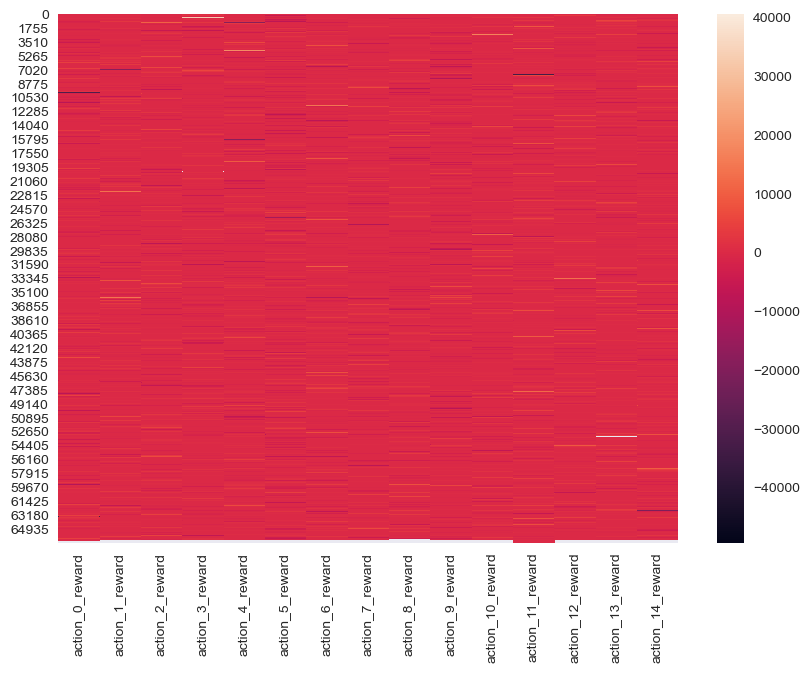

In [30]:
fig, ax = plt.subplots(figsize=(10,7)) 
ax = sns.heatmap(rewards,ax=ax)

## Test <a class="anchor" id="test"></a>

In [31]:
explore_prob=TEST_EXPLORE_PROB#reserve some randomness to improve on testing

trainingPredictIterationPeriod=TEST_ITERATION_PREDICT_PERIOD_TRAIN
trainingTargetIterationPeriod=TEST_ITERATION_TARGET_PERIOD_TRAIN

counter_plt_results=0
wining_counter_constant=0
wining_counter=0

final_results=None
files=[]

best_avellaneda_param_dict

{'risk_aversion': 0.0166133089,
 'window_tick': 9.5055,
 'minutes_change_k': 1.0,
 'quantity': 0.0001,
 'k_default': -1.0,
 'position_multiplier': 13.8037,
 'spread_multiplier': 3.805,
 'first_hour': 7.0,
 'last_hour': 19.0,
 'seed': 28220,
 'calculateTt': 0}

In [32]:
def launch_test(start_date_test,end_date_test,is_parameter_tuning_benchmark:bool=False,start_date_train=None,end_date_train=None,best_parameter_tuning_dict:dict=None):
    best_avellaneda_param_dict=None
    if is_parameter_tuning_benchmark:        
        best_benchmark_algorithm,best_avellaneda_param_dict=parameter_tuning_benchmark(benchmark,start_date=start_date_train,end_date=end_date_train,best_parameter_tuning_dict=best_parameter_tuning_dict)
        #set new bet parameter tuning
        benchmark.set_parameters(best_avellaneda_param_dict)
        avellaneda_dqn.set_parameters(best_avellaneda_param_dict)#to be fair optimization is going to optimize avellaneda

    ## linear constant tests
    linear_constant_test=benchmark_linear_constant_spread.test(
        instrument_pk=instrument_pk,
        start_date=start_date_test,
        end_date=end_date_test,
    )
    
    constant_test=benchmark_constant_spread.test(
        instrument_pk=instrument_pk,
        start_date=start_date_test,
        end_date=end_date_test,
    )
    as_test=[]
    for benchmark in benchmark_avellanedas:
        as_test_it = benchmark.test(
            instrument_pk=instrument_pk,
            start_date=start_date_test,
            end_date=end_date_test,
        )
        as_test.append(as_test_it)
    
    dqn_test = avellaneda_dqn.test(
        instrument_pk=instrument_pk,
        start_date=start_date_test,
        end_date=end_date_test,
        explore_prob=explore_prob,
        trainingPredictIterationPeriod=trainingPredictIterationPeriod,
        trainingTargetIterationPeriod=trainingTargetIterationPeriod,
    )
    dqn_rnn_test=None
    
    if INCLUDE_RNN:
        dqn_rnn_test = avellaneda_rnn_dqn.test(
        instrument_pk=instrument_pk,
        start_date=start_date_test,
        end_date=end_date_test,
        explore_prob=explore_prob,
        trainingPredictIterationPeriod=trainingPredictIterationPeriod,
        trainingTargetIterationPeriod=trainingTargetIterationPeriod,
        )
        
    

    return as_test,linear_constant_test,constant_test,dqn_test,dqn_rnn_test,best_avellaneda_param_dict



def plot_results_algorithms(benchmark_test_list,linear_constant_test,constant_test,dqn_test,dqn_rnn_test,save_file=True,column_to_compare='historicalTotalPnl'):
    global counter_plt_results
    global wining_counter
    global final_results
    global wining_counter_constant
    
    name_output=benchmark.algorithm_info
    plot_open=True
    
    
    try:
        all_results=True
        #AS
        benchmark_counter=0
        for benchmark_test in benchmark_test_list:
            as_name_output=list(benchmark_test.keys())[0]        
            backtest_result_test=benchmark_test[as_name_output]
            if backtest_result_test is None:
                benchmark_counter+=1
                all_results=False
                print(rf"{as_name_output} has no results on backtest -> skip it")
                continue
            plot_bnch=benchmark_avellanedas[benchmark_counter].plot_trade_results(raw_trade_pnl_df=backtest_result_test,plot_open=plot_open)
            filename='%s_test_%d.png'%(as_name_output,counter_plt_results)
            if save_file:
                plt.savefig(filename)
                files.append(filename)
            plt.show()    
            benchmark_counter+=1

        #DQN
        dqn_name_output=list(dqn_test_temp.keys())[0]
        backtest_result_test=dqn_test[dqn_name_output]    
        if backtest_result_test is None:
            all_results=False
            print(rf"{dqn_name_output} has no results on backtest -> skip it")
        else:
            plot_dqn=avellaneda_dqn.plot_trade_results(raw_trade_pnl_df=backtest_result_test,plot_open=plot_open)
            filename='dqn_test_%d.png'%counter_plt_results
            if save_file:
                plt.savefig(filename)
                files.append(filename)

            plot_dqnA=avellaneda_dqn.plot_params(raw_trade_pnl_df=backtest_result_test)    
            filename='dqn_test_%d_params.png'%counter_plt_results
            if save_file:
                plt.savefig(filename)
                files.append(filename)
            plt.show()
            
        #DQN RNN
        if dqn_rnn_test is not None:
            dqn_rnn_name_output=list(dqn_rnn_test.keys())[0]
            backtest_result_test=dqn_rnn_test[dqn_rnn_name_output]    
            if backtest_result_test is None:
                all_results=False
                print(rf"{dqn_rnn_name_output} has no results on backtest -> skip it")
            else:
                plot_dqn=avellaneda_rnn_dqn.plot_trade_results(raw_trade_pnl_df=backtest_result_test,plot_open=plot_open)
                filename='dqn_rnn_test_%d.png'%counter_plt_results
                if save_file:
                    plt.savefig(filename)
                    files.append(filename)

                plot_dqnA=avellaneda_rnn_dqn.plot_params(raw_trade_pnl_df=backtest_result_test)    
                filename='dqn_rnn_test_%d_params.png'%counter_plt_results
                if save_file:
                    plt.savefig(filename)
                    files.append(filename)
                plt.show()
            

        if not all_results:
            print(rf"something is wrong to compare results")
            return
        
        ### add results to final DF
        all_final_results_list=[]
        as_columns=[]
        for benchmark_test in benchmark_test_list:
            as_name_output=list(benchmark_test.keys())[0]   
            risk_aversion = as_name_output.split('_')[-2]
            windows_tick= as_name_output.split('_')[-1]        
            column_name=f'avellaneda_stoikov_{risk_aversion}_{windows_tick}_'
            as_columns.append(as_name_output)

            as_results_dict  = pd.Series(get_final_metrics(benchmark_test,ratios_column=column_to_compare)).add_prefix(column_name)
            all_final_results_list.append(as_results_dict)


        linear_constant_results_dict  = pd.Series(get_final_metrics(linear_constant_test,ratios_column=column_to_compare)).add_prefix('linear_constant_spread_')
        constant_results_dict  = pd.Series(get_final_metrics(constant_test,ratios_column=column_to_compare)).add_prefix('constant_spread_')
        dqn_test_dict = pd.Series(get_final_metrics(dqn_test,ratios_column=column_to_compare)).add_prefix('alpha_avellaneda_')
        
        all_final_results_list.append(linear_constant_results_dict)
        all_final_results_list.append(constant_results_dict)
        all_final_results_list.append(dqn_test_dict)
        if dqn_rnn_test is not None:
            dqn_rnn_test_dict = pd.Series(get_final_metrics(dqn_rnn_test,ratios_column=column_to_compare)).add_prefix('alpha_avellaneda_rnn_')
            all_final_results_list.append(dqn_rnn_test_dict)


        series_row = pd.concat(all_final_results_list).T
        series_row['instrument']=instrument_pk

        if column_to_compare=="historicalRealizedPnl":
            if final_results is None:
                final_results=pd.DataFrame(series_row).T
            else:
                final_results=pd.concat([final_results,pd.DataFrame(series_row).T])


        #compare
    #     column_to_compare='historicalRealizedPnl'
    #     column_to_compare='historicalTotalPnl'#
        import copy
        all_final_results_pnl_list=[]
        columns=[]
        color_list=[]
        for benchmark_test in benchmark_test_list:
            as_name_output=list(benchmark_test.keys())[0]        
            benchmark_result = copy.copy(benchmark_test[as_name_output])
            benchmark_result.set_index('date',inplace=True)
            all_final_results_pnl_list.append(benchmark_result[column_to_compare])
            risk_aversion = as_name_output.split('_')[-2]
            windows_tick= as_name_output.split('_')[-1]  
            color_list.append('silver')
            columns.append(f'{column_to_compare}_avellaneda_stoikov_{risk_aversion}_{windows_tick}')

        dqn_result = copy.copy(dqn_test[dqn_name_output])
        dqn_result.set_index('date',inplace=True)
        all_final_results_pnl_list.append(dqn_result[column_to_compare])
        columns.append('%s_alpha_as'%column_to_compare)
        color_list.append('red')
        
        if dqn_rnn_test is not None:
            dqn_rnn_result =copy.copy(dqn_rnn_test[dqn_rnn_name_output])
            dqn_rnn_result.set_index('date',inplace=True)
            all_final_results_pnl_list.append(dqn_rnn_result[column_to_compare])
            columns.append('%s_rnn_alpha_as'%column_to_compare)
            color_list.append('darkred')
            

        constant_spread_output=list(constant_test.keys())[0]
        constant_spread_result=copy.copy(constant_test[constant_spread_output])
        constant_spread_result.set_index('date',inplace=True)
        all_final_results_pnl_list.append(constant_spread_result[column_to_compare])
        columns.append('%s_constant_spread'%column_to_compare)
        color_list.append('blue')

        linear_constant_spread_output=list(linear_constant_test.keys())[0]
        linear_constant_spread_result=copy.copy(linear_constant_test[linear_constant_spread_output])
        linear_constant_spread_result.set_index('date',inplace=True)    
        all_final_results_pnl_list.append(linear_constant_spread_result[column_to_compare])
        columns.append('%s_linear_constant_spread'%column_to_compare)
        color_list.append('darkblue')

        total_pnl=pd.concat(all_final_results_pnl_list,axis=1)
        total_pnl.columns=columns


        total_pnl.sort_index(inplace=True)

        total_pnl.fillna(method='ffill',axis=0,inplace=True)
        total_pnl.dropna(inplace=True)

        total_pnl.plot(figsize=(17,7),color=color_list)

        #all plots with legend sharpe
        sharpe_dict={}    
        pnl_dict = {}
        open_pnl_dict={}
        close_pnl_dict={}

        sharpe_as=None
        for as_column in as_columns:    
            risk_aversion = as_column.split('_')[-2]
            windows_tick= as_column.split('_')[-1]         
            name=rf'avellaneda_stoikov_{risk_aversion}_{windows_tick}'

            sharpe_score = series_row[name+"_sharpe"]
            if sharpe_as is None or sharpe_score>sharpe_as:
                sharpe_as=sharpe_score

            as_algo_name=rf"avellaneda_stoikov γ:{risk_aversion} w:{windows_tick}"

            open_pnl_dict[as_algo_name] = series_row[name+'_open_pnl']
            close_pnl_dict[as_algo_name] = series_row[name+'_close_pnl']
            sharpe_dict[as_algo_name]=sharpe_score
    #         import pdb;pdb.set_trace()
            pnl_dict[as_algo_name]=total_pnl[rf'{column_to_compare}_{name}'].iloc[-1]


        sharpe_dqn=series_row['alpha_avellaneda_sharpe']    
        sharpe_dict['alpha_avellaneda']=sharpe_dqn
        pnl_dict['alpha_avellaneda']=total_pnl['%s_alpha_as'%column_to_compare].iloc[-1]
        open_pnl_dict['alpha_avellaneda'] = series_row['alpha_avellaneda'+'_open_pnl']
        close_pnl_dict['alpha_avellaneda'] = series_row['alpha_avellaneda'+'_close_pnl']
        
        if dqn_rnn_test is not None:
#             import pdb;pdb.set_trace()
            sharpe_rnn_dqn=series_row['alpha_avellaneda_rnn_sharpe']    
            sharpe_dict['alpha_avellaneda_rnn']=sharpe_rnn_dqn
            pnl_dict['alpha_avellaneda_rnn']=total_pnl['%s_rnn_alpha_as'%column_to_compare].iloc[-1]
            open_pnl_dict['alpha_avellaneda_rnn'] = series_row['alpha_avellaneda_rnn'+'_open_pnl']
            close_pnl_dict['alpha_avellaneda_rnn'] = series_row['alpha_avellaneda_rnn'+'_close_pnl']

        sharpe_constant_spread=series_row['constant_spread_sharpe'] 
        sharpe_dict['constant_spread']=sharpe_constant_spread
        pnl_dict['constant_spread']=total_pnl['%s_constant_spread'%column_to_compare].iloc[-1]
        open_pnl_dict['constant_spread'] = series_row['constant_spread'+'_open_pnl']
        close_pnl_dict['constant_spread'] = series_row['constant_spread'+'_close_pnl']

        sharpe_linear_constant_spread=series_row['linear_constant_spread_sharpe'] 
        sharpe_dict['linear_constant_spread']=sharpe_linear_constant_spread
        pnl_dict['linear_constant_spread']=total_pnl['%s_linear_constant_spread'%column_to_compare].iloc[-1]
        open_pnl_dict['linear_constant_spread'] = series_row['linear_constant_spread'+'_open_pnl']
        close_pnl_dict['linear_constant_spread'] = series_row['linear_constant_spread'+'_close_pnl']

        legend=[]
        for algo in sharpe_dict.keys():
            sentence=rf"{algo}     sharpe=%.5f  %s_pnl=%.3f"%(sharpe_dict[algo],column_to_compare,pnl_dict[algo])
            legend.append(sentence)

        if column_to_compare=="historicalRealizedPnl":
            if sharpe_dqn>sharpe_as:
                wining_counter+=1
            if sharpe_dqn>sharpe_constant_spread:
                wining_counter_constant+=1       


        plt.title('%s test_%d'%(column_to_compare,counter_plt_results))
        plt.legend(legend)
        plt.xlabel('date')
        filename='compare_total_pnl_%d.png'%counter_plt_results
        if save_file:
            plt.savefig(filename)
            files.append(filename)
        plt.show()


        file_output='dqn_vs_as_output_%d.csv'%counter_plt_results
        files.append(file_output)
        if save_file:
            total_pnl.to_csv(file_output)

        if column_to_compare=="historicalRealizedPnl":
            counter_plt_results+=1
            print(rf"ratio winning as = {wining_counter}/{counter_plt_results}")
            print(rf"ratio winning constant = {wining_counter_constant}/{counter_plt_results}")
    except Exception as e:
        print (rf"ERROR plotting results {e}")

### Execute test

In [33]:
days_test=[]
# testing_days=3
print(start_date_experiment)
for day in range(testing_days+1,1,-1):
    day_to_add=get_time(start_date_experiment,day,0)
    if day_to_add.day==25:#we dont have data
        continue
    days_test.append(day_to_add)
days_test

2022-01-24 00:00:00


[datetime.datetime(2021, 12, 24, 0, 0),
 datetime.datetime(2021, 12, 26, 0, 0),
 datetime.datetime(2021, 12, 27, 0, 0),
 datetime.datetime(2021, 12, 28, 0, 0),
 datetime.datetime(2021, 12, 29, 0, 0),
 datetime.datetime(2021, 12, 30, 0, 0),
 datetime.datetime(2021, 12, 31, 0, 0),
 datetime.datetime(2022, 1, 1, 0, 0),
 datetime.datetime(2022, 1, 2, 0, 0),
 datetime.datetime(2022, 1, 3, 0, 0),
 datetime.datetime(2022, 1, 4, 0, 0),
 datetime.datetime(2022, 1, 5, 0, 0),
 datetime.datetime(2022, 1, 6, 0, 0),
 datetime.datetime(2022, 1, 7, 0, 0),
 datetime.datetime(2022, 1, 8, 0, 0),
 datetime.datetime(2022, 1, 9, 0, 0),
 datetime.datetime(2022, 1, 10, 0, 0),
 datetime.datetime(2022, 1, 11, 0, 0),
 datetime.datetime(2022, 1, 12, 0, 0),
 datetime.datetime(2022, 1, 13, 0, 0),
 datetime.datetime(2022, 1, 14, 0, 0),
 datetime.datetime(2022, 1, 15, 0, 0),
 datetime.datetime(2022, 1, 16, 0, 0),
 datetime.datetime(2022, 1, 17, 0, 0),
 datetime.datetime(2022, 1, 18, 0, 0),
 datetime.datetime(2022, 1,

  0%|                                                                                           | 0/29 [00:00<?, ?it/s]

pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 1915 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 5726 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 425 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 696 trades
plotting trade_results from 2021-12-24 07:02:02.483000 to 2021-12-24 09:16:01.883000


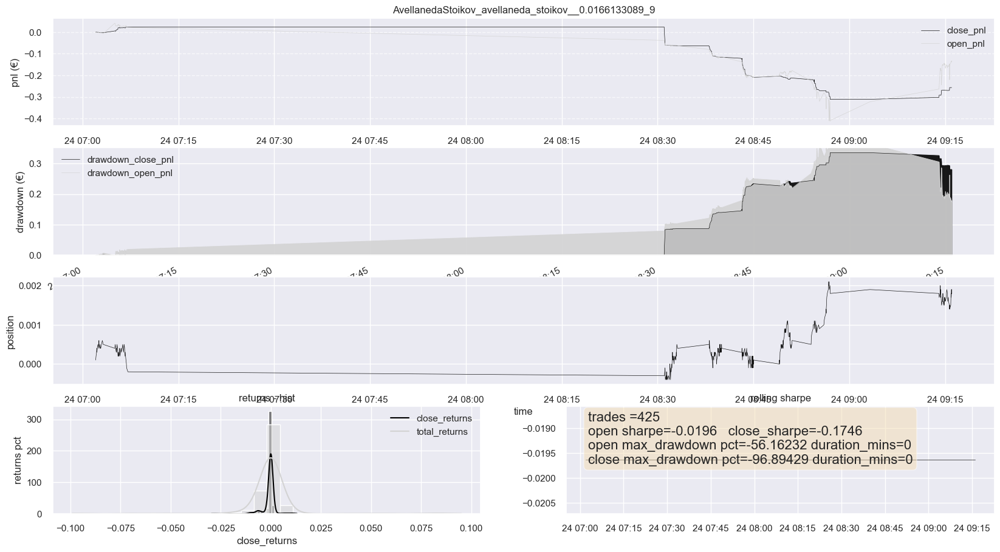

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-24 07:02:32.485000 to 2021-12-24 09:16:01.883000


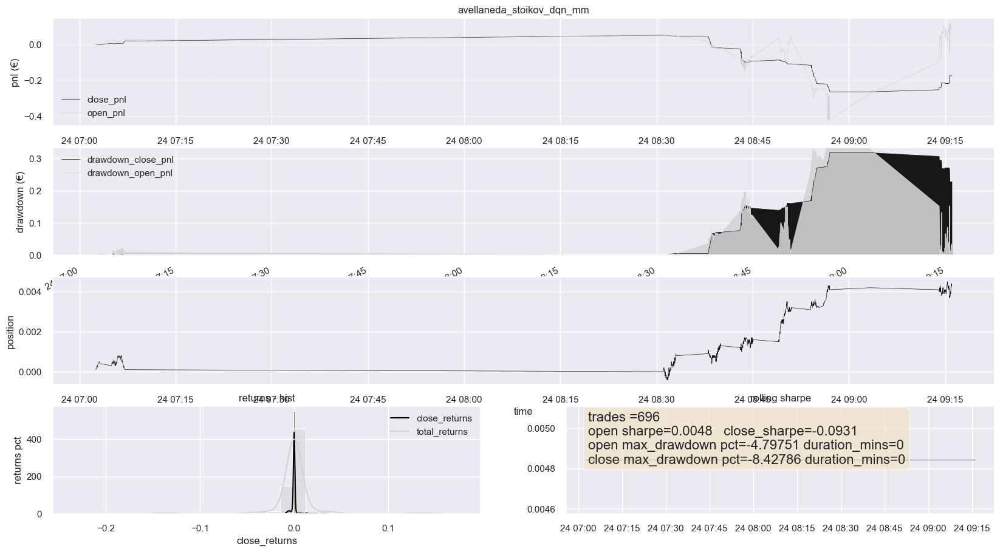

plotting params from 2021-12-24 07:02:32.485000 to 2021-12-24 09:16:01.883000


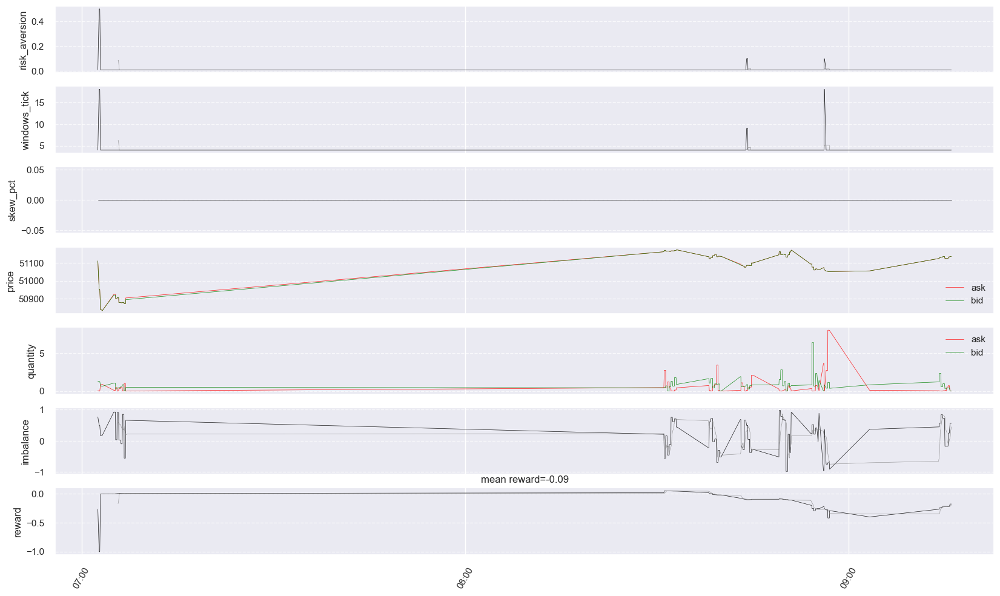

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.13479792869229787  close_pnl:-0.256842643999996  number_trades:394  sharpe:-0.17483552773448188   sortino:-0.19189849180858978  max_dd:0.335206922999995  pnl_map:-219.6668699932001   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-6.057662115138712  close_pnl:-6.1106073114821875  number_trades:1906  sharpe:-0.5162452144260453   sortino:-0.46130130721096435  max_dd:6.151873661761234  pnl_map:-25498.58340772375   
ConstantSpread_constant_spread  -> open_pnl:-1.2791123463388423  close_pnl:-1.4043749915001138  number_trades:4986  sharpe:-0.04646495880581201   sortino:-0.07706726202449955  max_dd:4.745050000000042  pnl_map:-2050.5045760341027   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:0.09366919179165488  close_pnl:-0.17474072300000762  number_trades:591  sharpe:-0.09319724022528829   sortino:-0.14121732839665427  max_dd:0.31834115500000687  pnl_map:49.01786277217429   


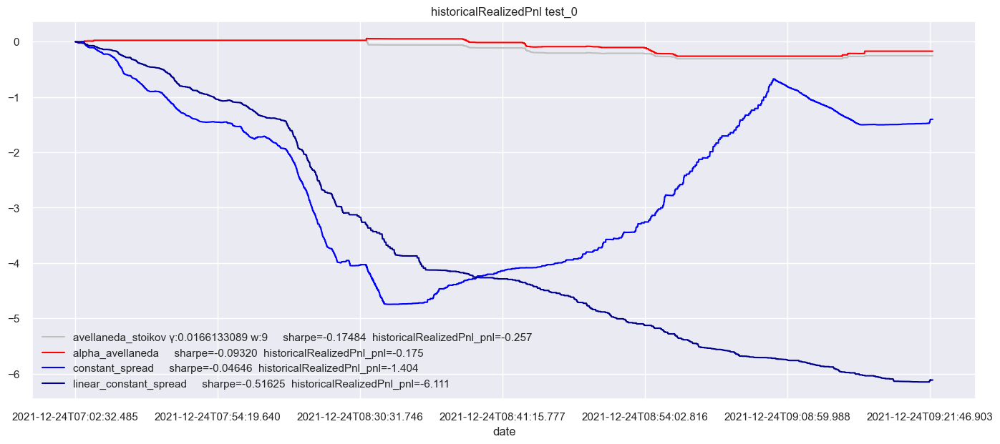

  3%|██▊                                                                               | 1/29 [02:02<57:11, 122.55s/it]

ratio winning as = 1/1
ratio winning constant = 0/1
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 3962 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 21840 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 5903 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 10129 trades
plotting trade_results from 2021-12-26 15:07:47.244000 to 2021-12-26 18:59:55.929000


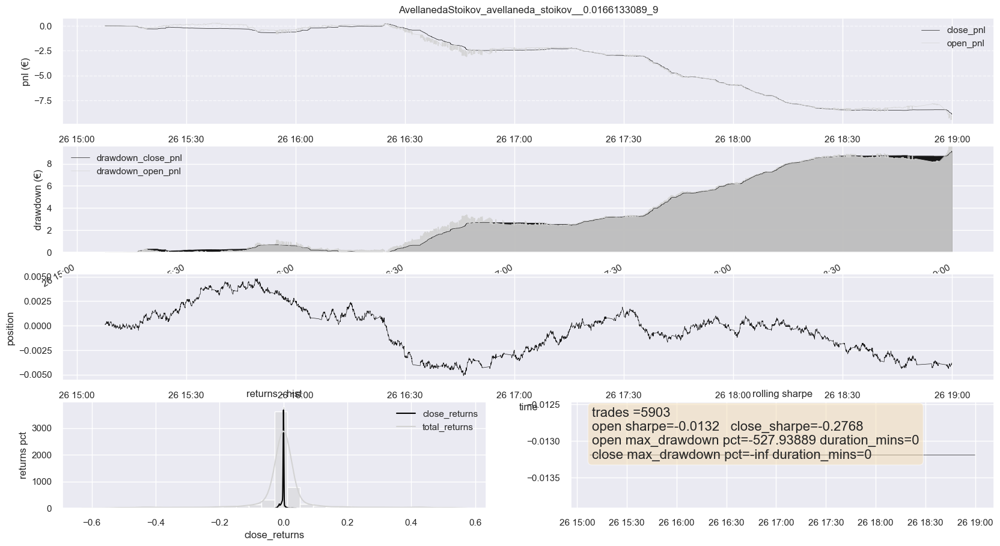

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-26 15:08:21.246000 to 2021-12-26 18:59:59.927000


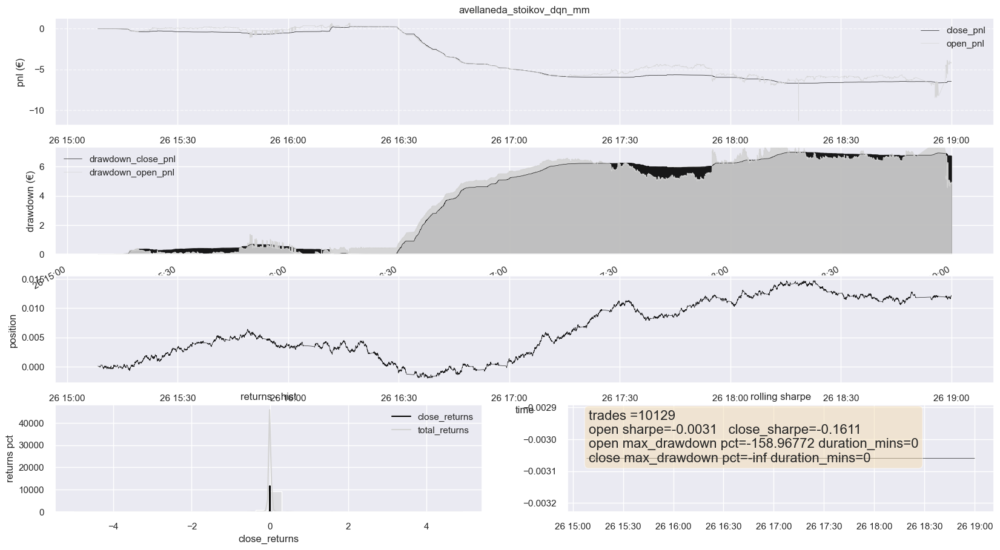

plotting params from 2021-12-26 15:08:21.246000 to 2021-12-26 18:59:59.927000


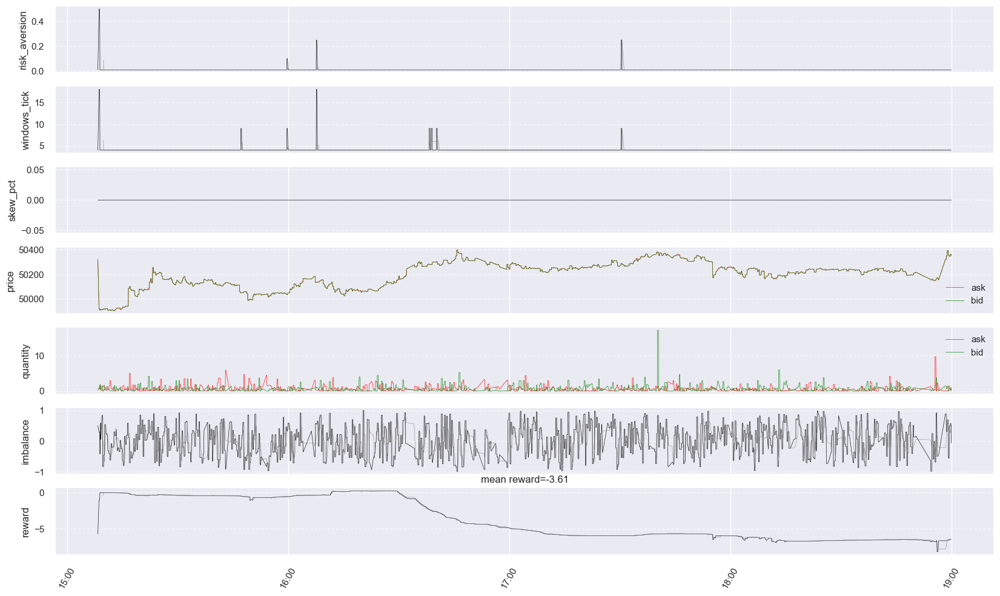

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-9.472738261378966  close_pnl:-8.92008951200002  number_trades:5276  sharpe:-0.27681717850770826   sortino:-0.3092193655206187  max_dd:9.142670670000012  pnl_map:-5033.039662732112   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-15.602826793173346  close_pnl:-15.59566942020665  number_trades:3855  sharpe:-0.5118728352748694   sortino:-0.4695742216915507  max_dd:15.59566942020665  pnl_map:-63898.78629768186   
ConstantSpread_constant_spread  -> open_pnl:-0.8149729889999546  close_pnl:-0.8149729889999546  number_trades:16719  sharpe:-0.012015610128558916   sortino:-0.0210239567251342  max_dd:2.7689509944999893  pnl_map:-1419.3108846274508   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-4.265251945670265  close_pnl:-6.47104663400012  number_trades:8382  sharpe:-0.1610878675205218   sortino:-0.20003977292752034  max_dd:6.9789726040001145  pnl_map:-681.8968942147264   


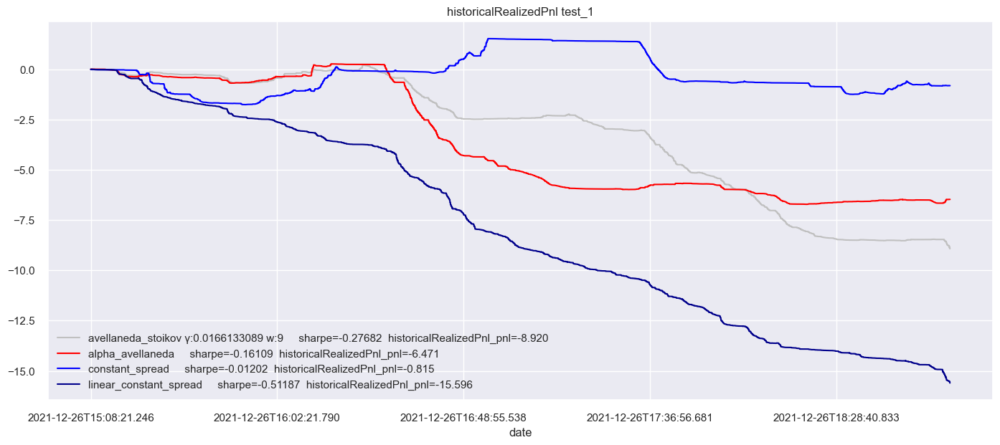

  7%|█████▋                                                                            | 2/29 [04:14<57:36, 128.00s/it]

ratio winning as = 2/2
ratio winning constant = 0/2
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 15587 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 75887 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 15465 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 27368 trades
plotting trade_results from 2021-12-27 07:02:03.054000 to 2021-12-27 18:59:19.108000

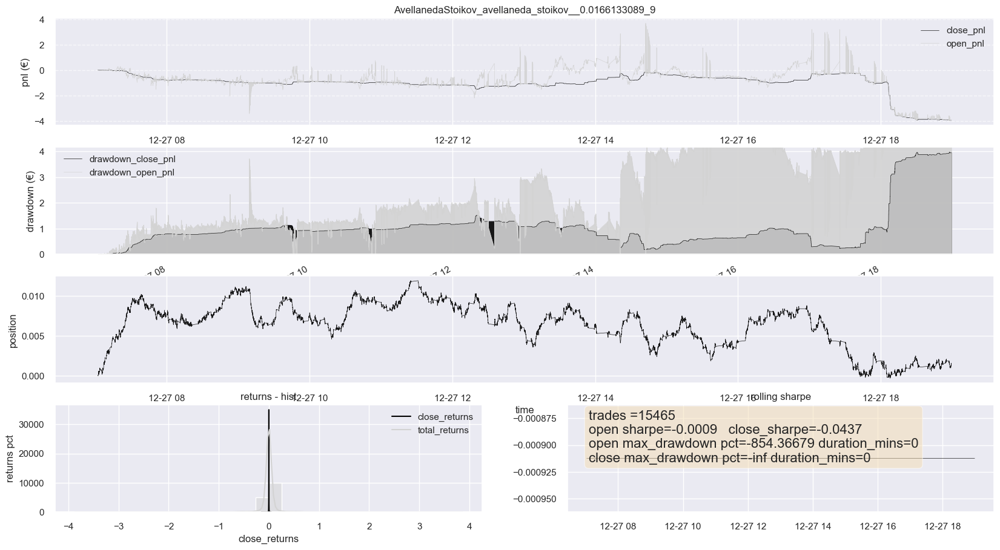

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-27 07:02:32.054000 to 2021-12-27 18:59:18.802000


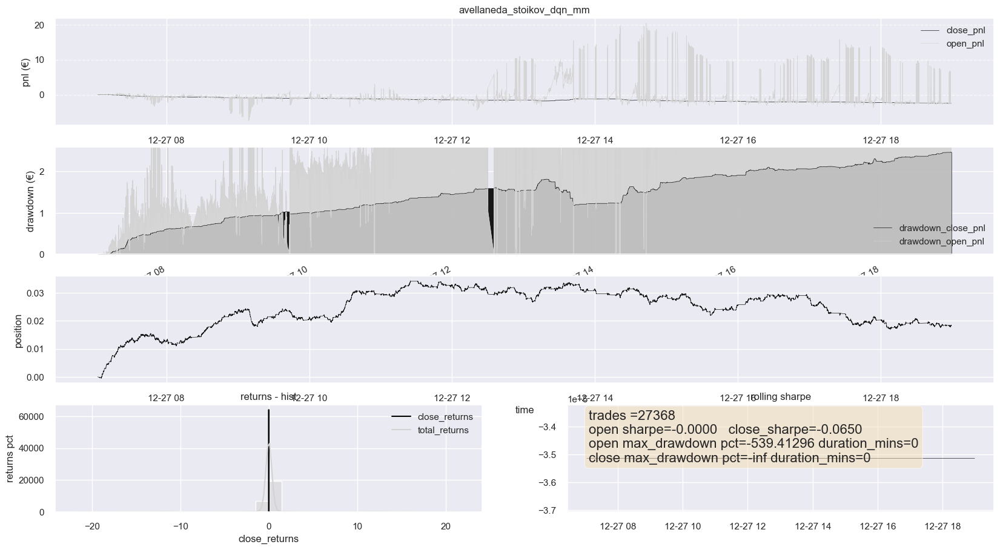

plotting params from 2021-12-27 07:02:32.054000 to 2021-12-27 18:59:18.802000


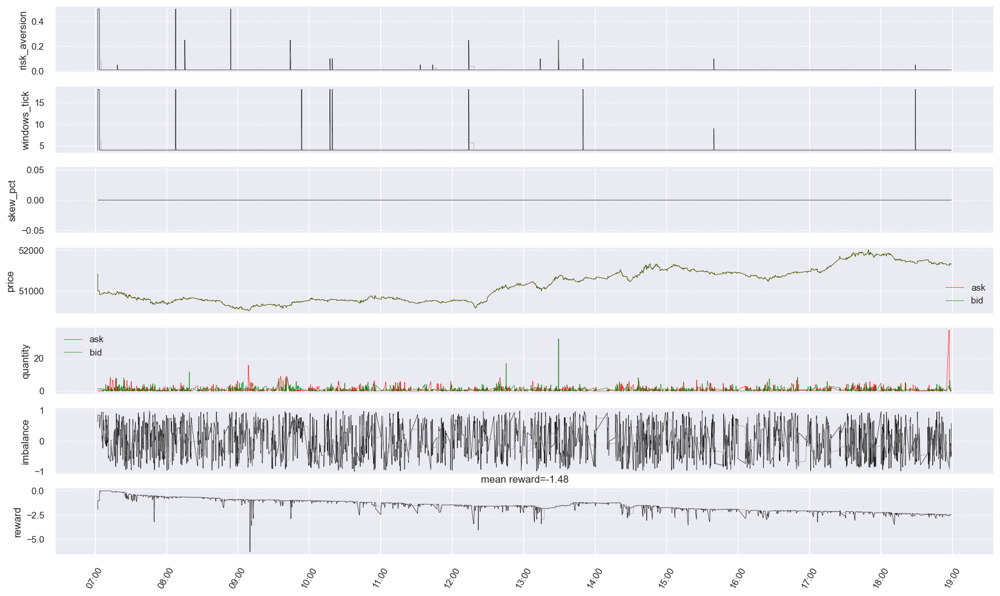

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-3.922477276500047  close_pnl:-3.9527392530000434  number_trades:13788  sharpe:-0.043655426261741036   sortino:-0.04793653668853618  max_dd:3.97763871600004  pnl_map:-603.3392023165693   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-191.3581518866983  close_pnl:-191.32433764797835  number_trades:15150  sharpe:-0.4640761058038657   sortino:-0.4330510650693058  max_dd:191.32433764797835  pnl_map:-797849.0259800636   
ConstantSpread_constant_spread  -> open_pnl:-72.35984605946278  close_pnl:-72.39400096600492  number_trades:57573  sharpe:-0.15219016641207006   sortino:-0.17132925659842993  max_dd:74.10067497400468  pnl_map:-128948.56866900051   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-2.3490122369998616  close_pnl:-2.4619775649999864  number_trades:22386  sharpe:-0.0650507140282899   sortino:-0.10756871700258383  max_dd:2.4621834409999885  pnl_map:-97.8397006208333   


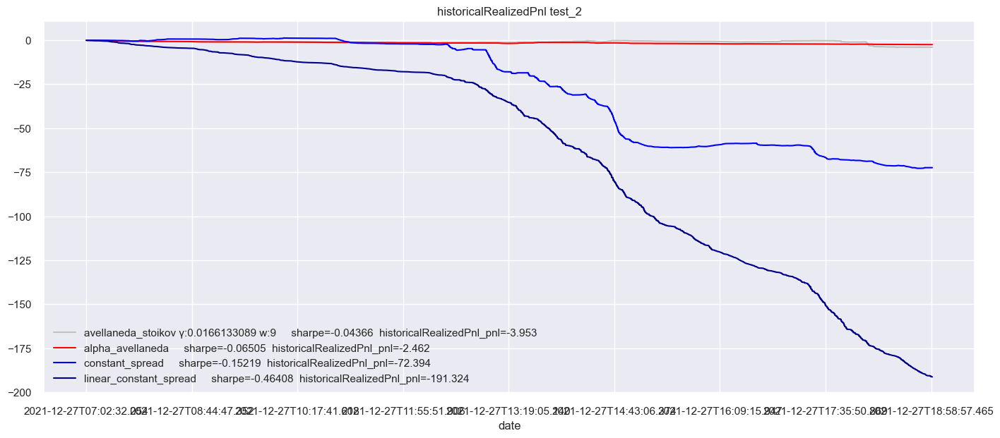

 10%|████████▎                                                                       | 3/29 [21:16<3:52:18, 536.09s/it]

ratio winning as = 2/3
ratio winning constant = 1/3
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 19885 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 68097 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11407 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 16294 trades
plotting trade_results from 2021-12-28 07:02:01.113000 to 2021-12-28 18:59:37.083000

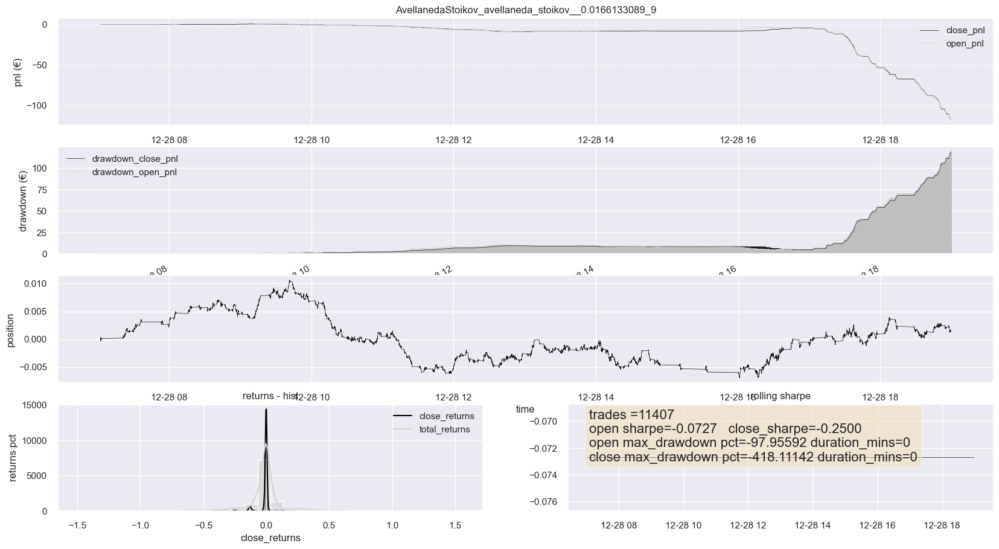

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-28 07:02:09.113000 to 2021-12-28 18:59:37.083000


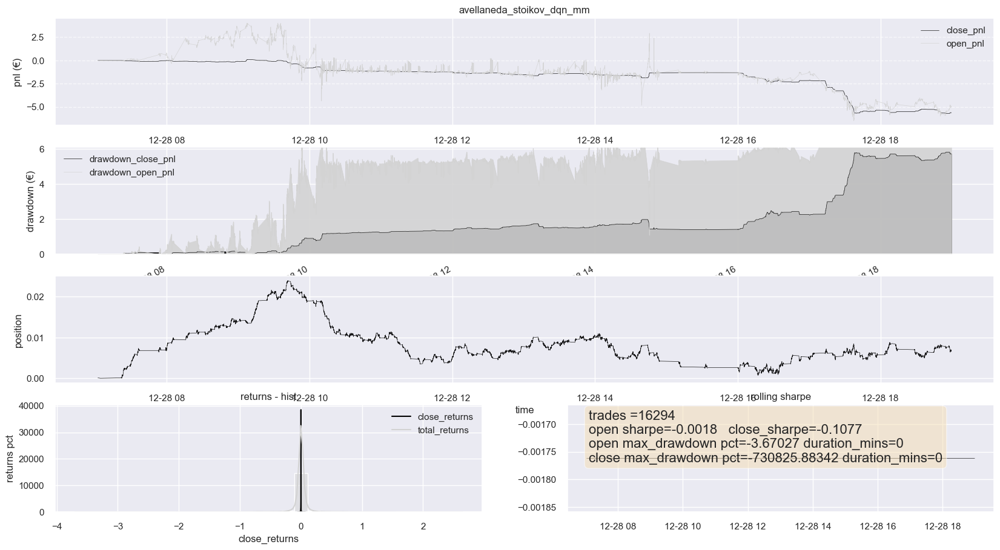

plotting params from 2021-12-28 07:02:09.113000 to 2021-12-28 18:59:37.083000


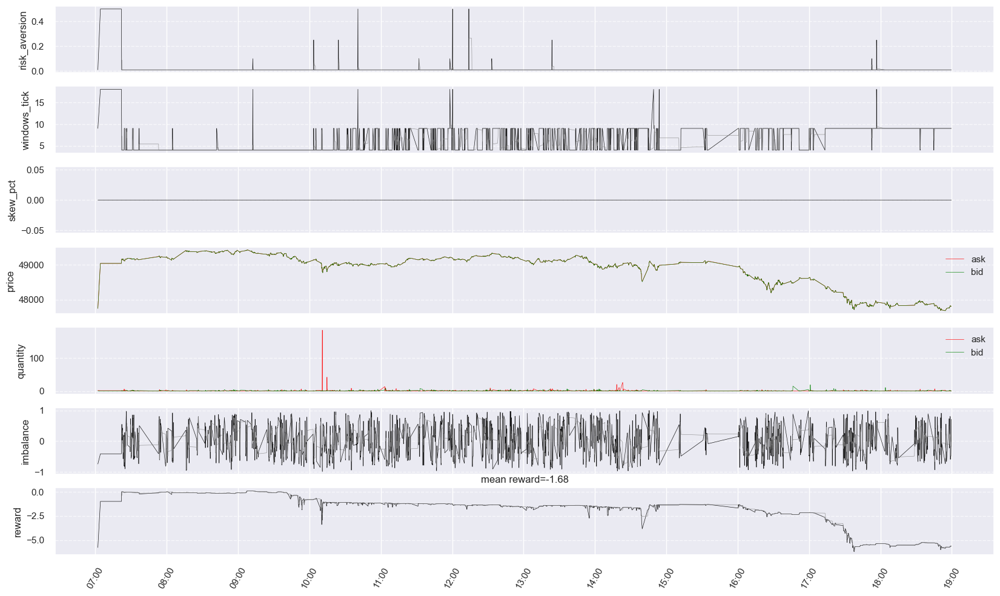

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-118.76624203804569  close_pnl:-118.24631892000043  number_trades:10452  sharpe:-0.25000524285530945   sortino:-0.252826268007395  max_dd:118.80762905100043  pnl_map:-36885.171319028326   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-294.1664627860867  close_pnl:-294.30328799622316  number_trades:19235  sharpe:-0.36074790785634037   sortino:-0.3499869874625622  max_dd:294.30328799622316  pnl_map:-1170260.2923610676   
ConstantSpread_constant_spread  -> open_pnl:-100.84025217822331  close_pnl:-100.8189539560011  number_trades:53328  sharpe:-0.1700895977202219   sortino:-0.19296037318380171  max_dd:100.8189539560011  pnl_map:-169458.1483160214   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-4.9571168342978735  close_pnl:-5.630862541999984  number_trades:14091  sharpe:-0.10770859173640411   sortino:-0.13841874282411148  max_dd:5.8220668600000005  pnl_map:-560.4266148738635   


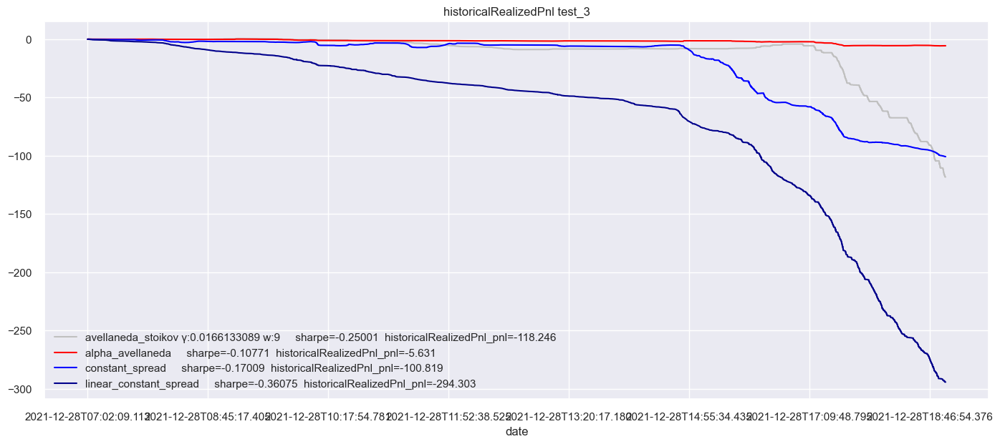

 14%|███████████                                                                     | 4/29 [38:39<5:06:46, 736.27s/it]

ratio winning as = 3/4
ratio winning constant = 2/4
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 18160 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 68804 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 10691 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15448 trades
plotting trade_results from 2021-12-29 07:02:00.130000 to 2021-12-29 18:59:59.144000

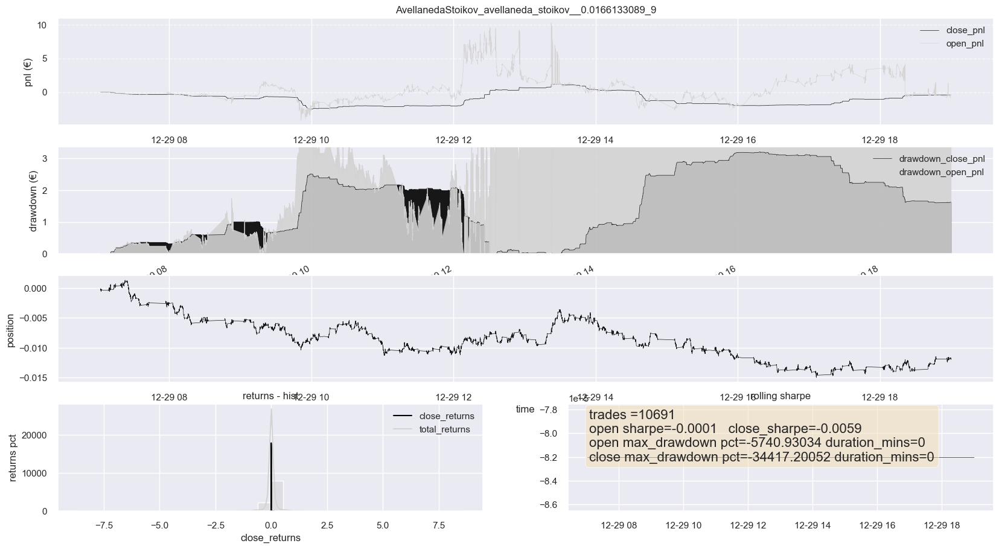

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-29 07:02:12.133000 to 2021-12-29 18:59:59.144000


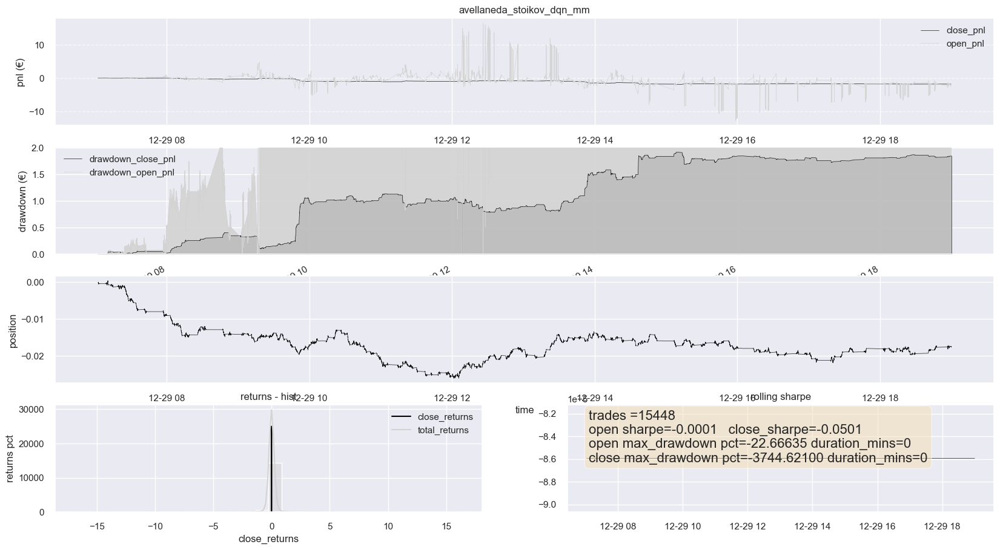

plotting params from 2021-12-29 07:02:12.133000 to 2021-12-29 18:59:59.144000


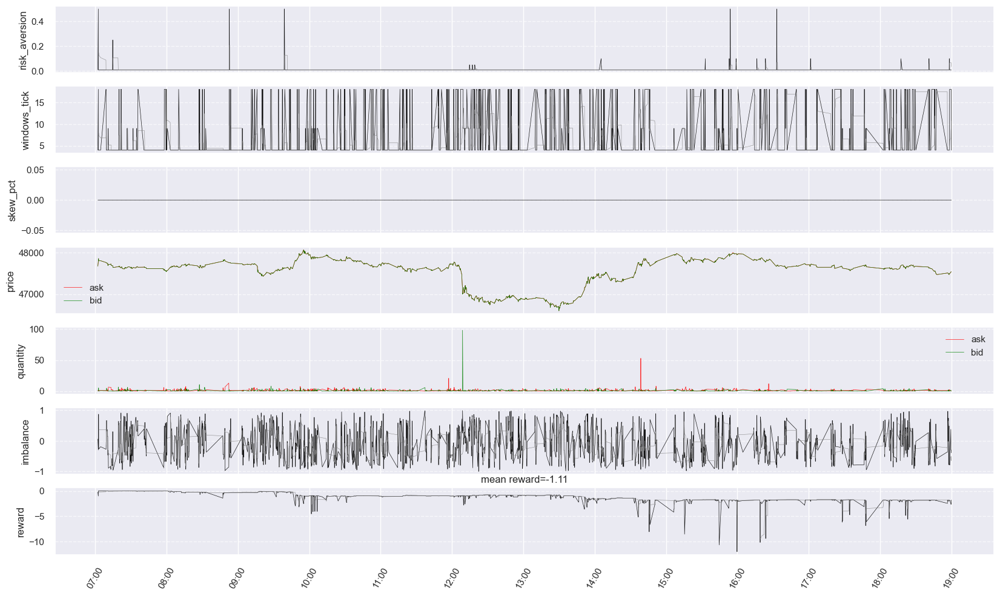

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.3520497689999829  close_pnl:-0.43157427900002937  number_trades:9652  sharpe:-0.005905203131326872   sortino:-0.012858908236608728  max_dd:3.203610558000027  pnl_map:-42.38248741765717   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-288.869943527186  close_pnl:-288.93203566655023  number_trades:17584  sharpe:-0.4473420809727443   sortino:-0.4205918012486517  max_dd:288.93203566655023  pnl_map:-1210979.443190618   
ConstantSpread_constant_spread  -> open_pnl:-174.3569604575115  close_pnl:-174.36013194050471  number_trades:53876  sharpe:-0.19563708806208005   sortino:-0.21397635635183213  max_dd:174.3601329405047  pnl_map:-293583.22134683444   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-1.7468278000000947  close_pnl:-1.813296197000032  number_trades:13215  sharpe:-0.05010329713945257   sortino:-0.07112291355456217  max_dd:1.9208990680000293  pnl_map:-105.47474333654966   


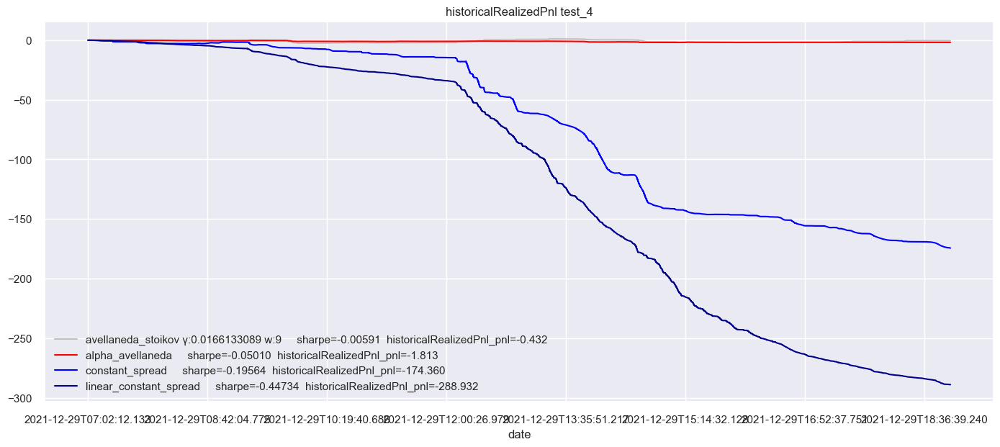

 17%|█████████████▊                                                                  | 5/29 [54:37<5:26:33, 816.40s/it]

ratio winning as = 3/5
ratio winning constant = 3/5
Parameter tuning benchmark on day 5 with data from 2021-12-29 06:00:00 to 2021-12-29 20:00:00
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 13883 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 70426 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11383 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 155

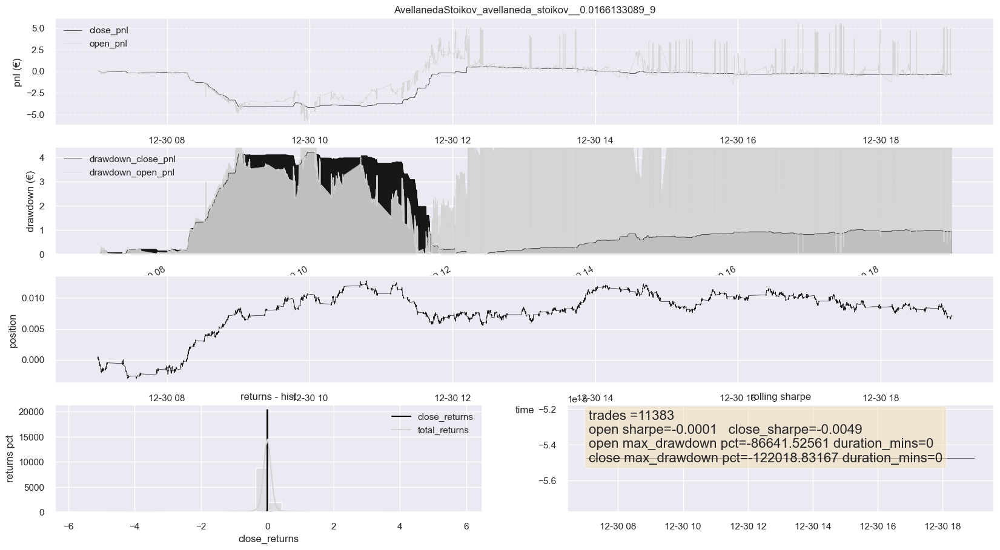

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-30 07:02:07.187000 to 2021-12-30 18:59:31.254000


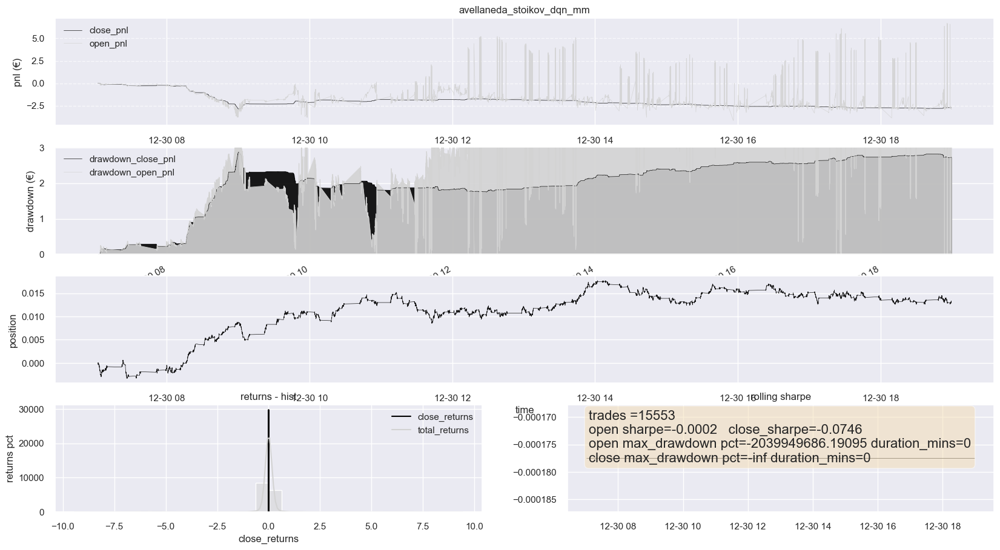

plotting params from 2021-12-30 07:02:07.187000 to 2021-12-30 18:59:31.254000


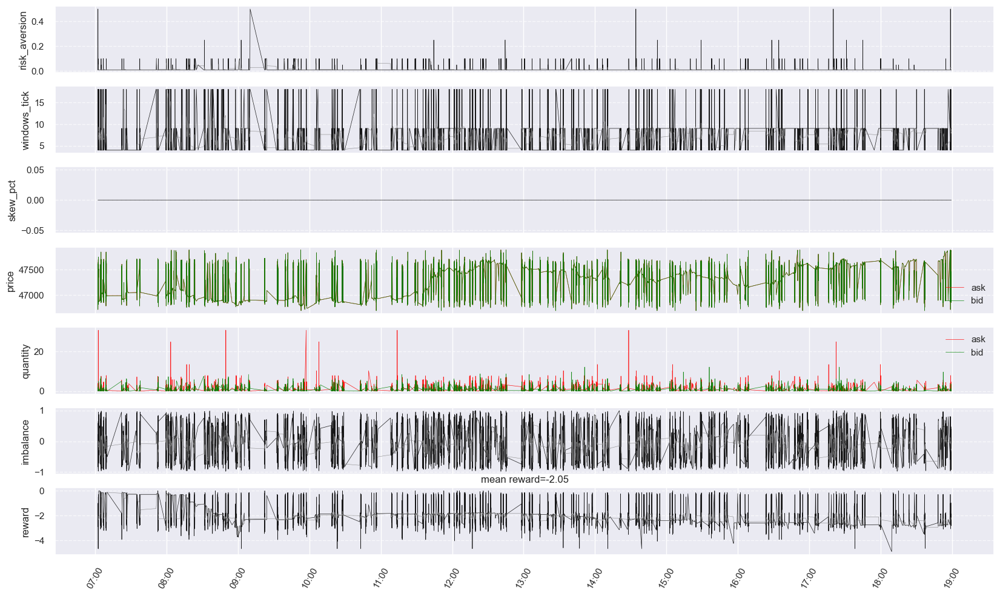

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.3893853039999251  close_pnl:-0.3602929839999756  number_trades:9860  sharpe:-0.004929508766815663   sortino:-0.011656774959062208  max_dd:4.207776262999973  pnl_map:-48.98867580814178   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-139.98614148042708  close_pnl:-139.97147062111944  number_trades:13549  sharpe:-0.4637960594326161   sortino:-0.4327568946072204  max_dd:139.97239432111942  pnl_map:-584961.3267595902   
ConstantSpread_constant_spread  -> open_pnl:-13.344262948998509  close_pnl:-13.344262948998509  number_trades:54529  sharpe:-0.0621894548576271   sortino:-0.09583990890512191  max_dd:13.766203948998726  pnl_map:-22721.917748129097   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-2.781932585833217  close_pnl:-2.7256814549999895  number_trades:13009  sharpe:-0.0746225154157409   sortino:-0.10627357449966782  max_dd:2.8702669869999964  pnl_map:-248.6264816487685   


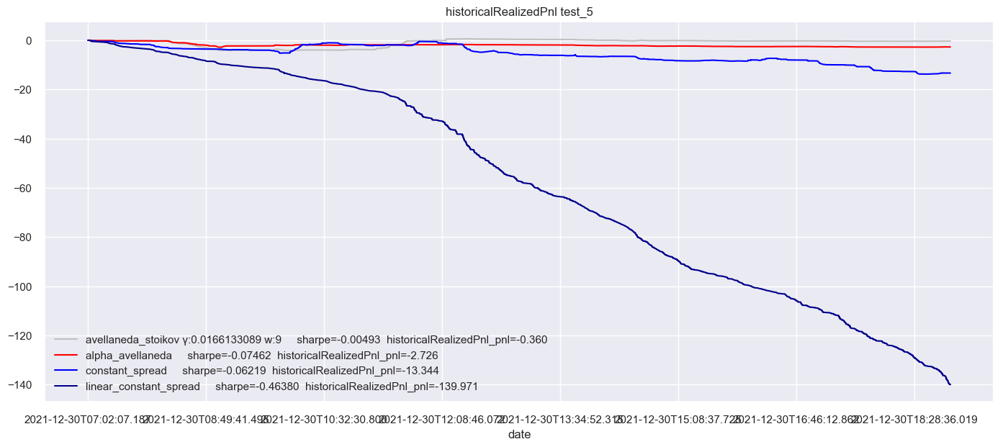

 21%|████████████████▏                                                             | 6/29 [1:10:41<5:32:07, 866.40s/it]

ratio winning as = 3/6
ratio winning constant = 3/6
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 18440 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 68057 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11427 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15517 trades
plotting trade_results from 2021-12-31 07:02:00.365000 to 2021-12-31 18:59:58.440000

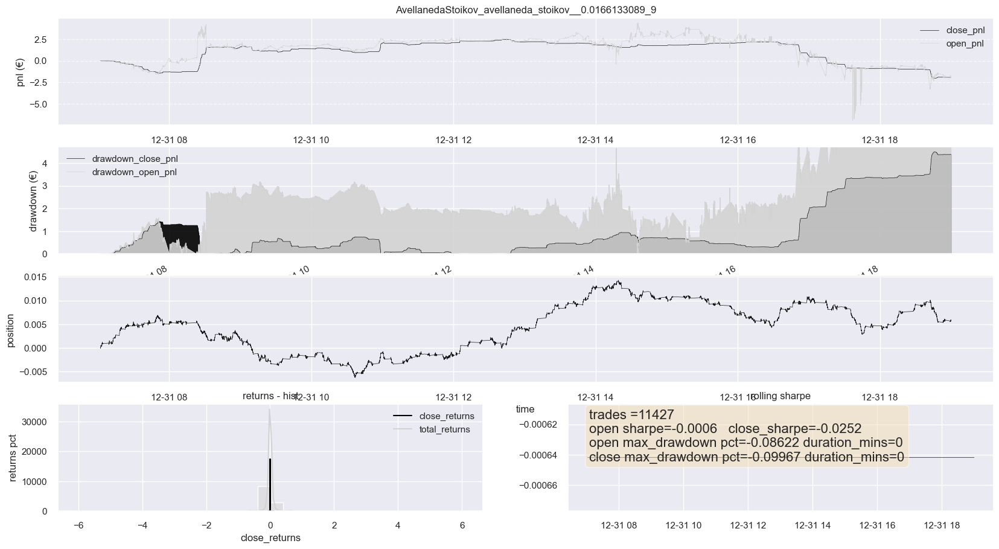

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2021-12-31 07:02:05.366000 to 2021-12-31 18:59:58.440000


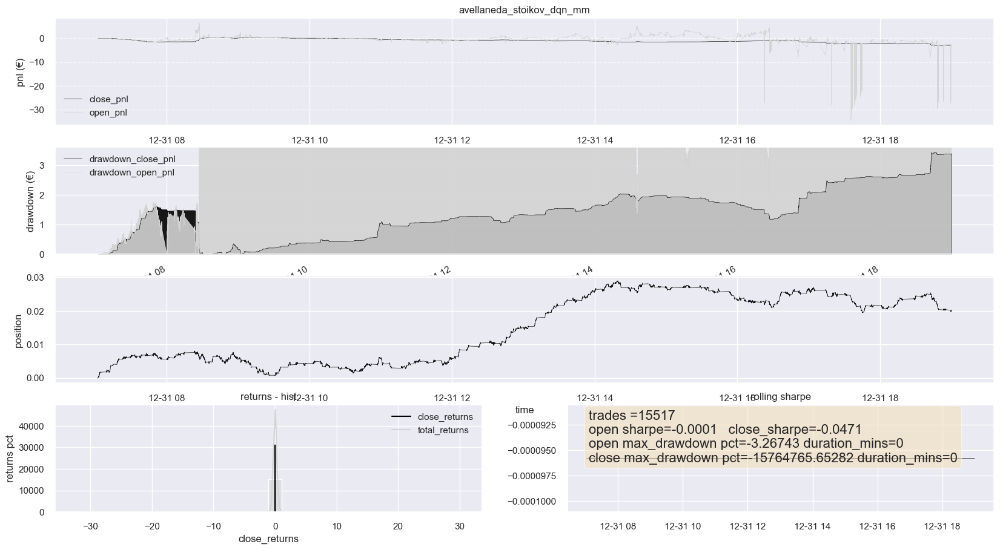

plotting params from 2021-12-31 07:02:05.366000 to 2021-12-31 18:59:58.440000


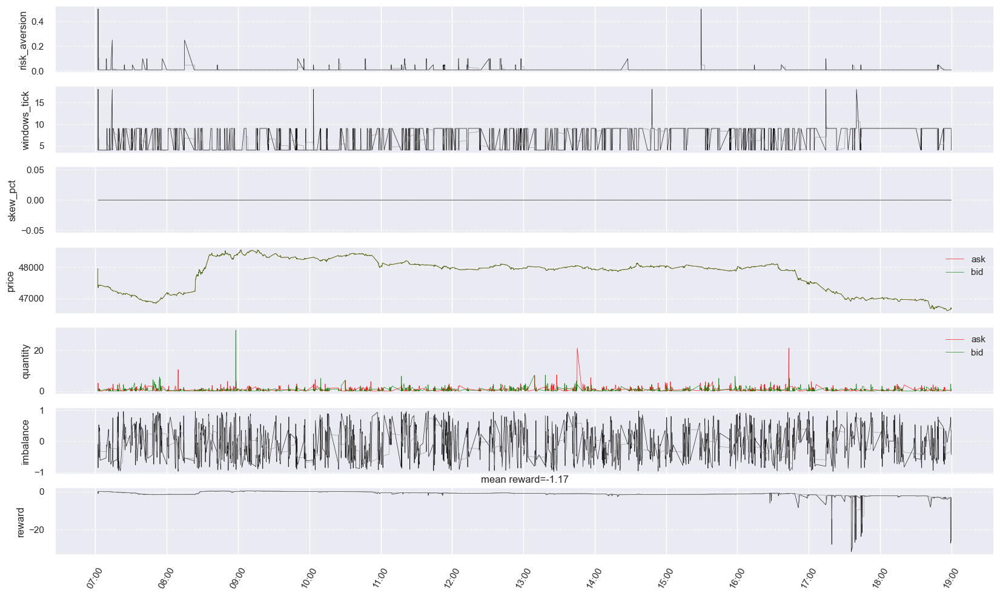

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-1.762249269999983  close_pnl:-1.9096913619999891  number_trades:10358  sharpe:-0.025227092412237775   sortino:-0.04926530942130664  max_dd:4.494248300000017  pnl_map:-309.640979244578   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-282.88897938680384  close_pnl:-283.2106993465523  number_trades:17699  sharpe:-0.3711397278055082   sortino:-0.36094243060115644  max_dd:283.2106993465523  pnl_map:-1197224.0436322086   
ConstantSpread_constant_spread  -> open_pnl:-52.06200979651451  close_pnl:-52.19214894851631  number_trades:53279  sharpe:-0.07765977610315222   sortino:-0.09058508212482083  max_dd:53.71546895251631  pnl_map:-88173.34632484299   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-2.5139872429998467  close_pnl:-2.9789555189999737  number_trades:13477  sharpe:-0.04712651604927451   sortino:-0.08056531408977904  max_dd:3.4424773549999736  pnl_map:-181.62599340080754   


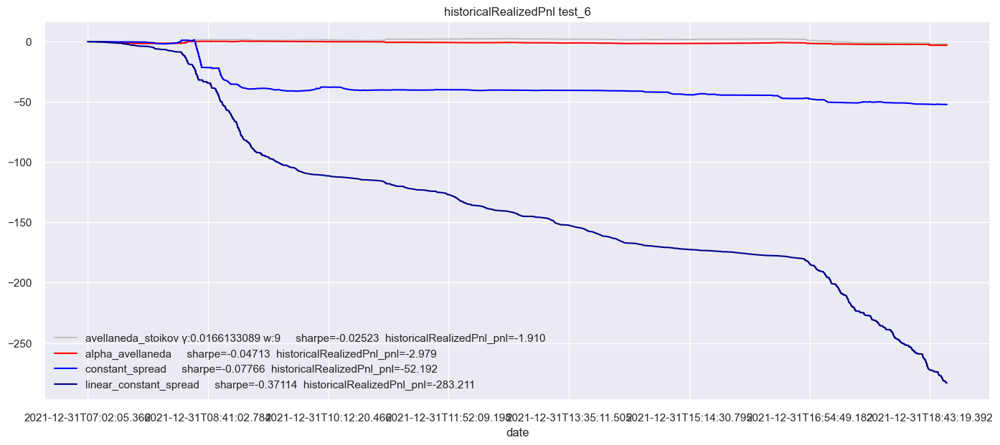

 24%|██████████████████▊                                                           | 7/29 [1:27:09<5:32:16, 906.20s/it]

ratio winning as = 3/7
ratio winning constant = 4/7
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 13124 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 58171 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 12417 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 14862 trades
plotting trade_results from 2022-01-01 07:02:00.554000 to 2022-01-01 18:59:52.690000

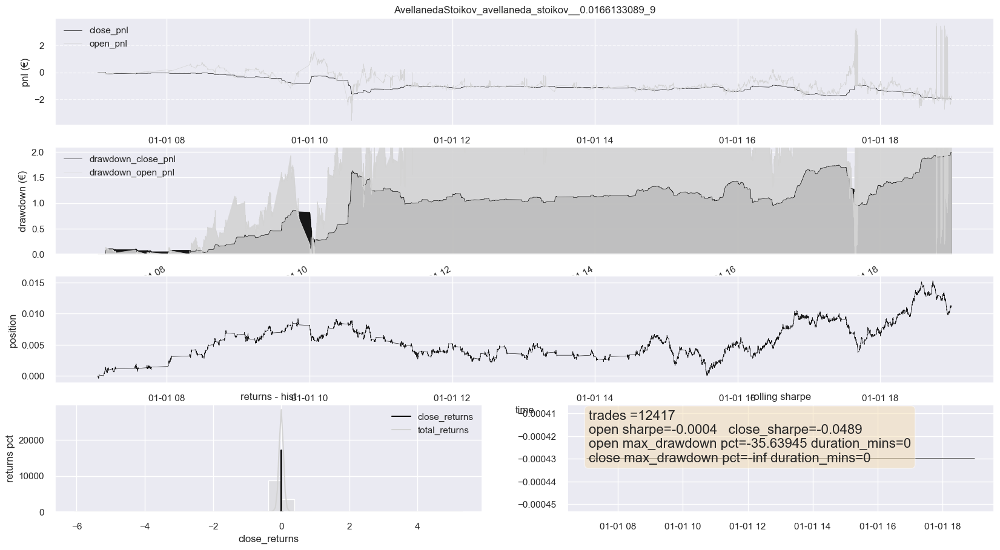

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-01 07:02:10.555000 to 2022-01-01 18:59:52.690000


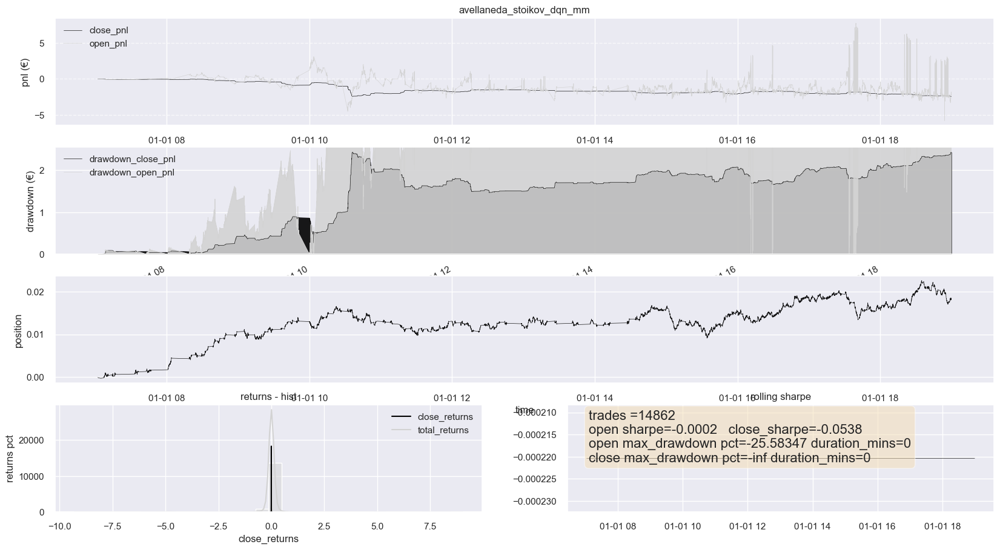

plotting params from 2022-01-01 07:02:10.555000 to 2022-01-01 18:59:52.690000


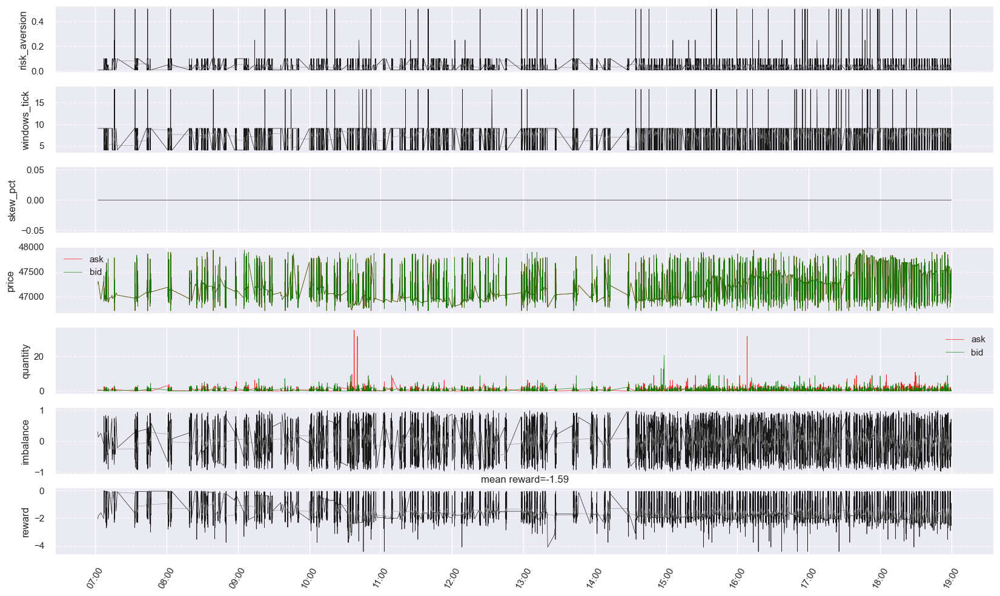

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-1.9651881631815693  close_pnl:-1.9864720729999945  number_trades:11154  sharpe:-0.04888734888586947   sortino:-0.0754439771540543  max_dd:1.9920417519999947  pnl_map:-315.3368296465966   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-107.19863048337528  close_pnl:-107.31618248736766  number_trades:12804  sharpe:-0.4325128586216294   sortino:-0.4053308598927557  max_dd:107.31973510823265  pnl_map:-408459.9984128158   
ConstantSpread_constant_spread  -> open_pnl:-58.64909494750042  close_pnl:-58.64909494750042  number_trades:46552  sharpe:-0.13959402856165426   sortino:-0.16052145366769624  max_dd:58.656005947500425  pnl_map:-94924.89043624648   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-2.266283034999822  close_pnl:-2.4208049699999816  number_trades:12990  sharpe:-0.05379278927352324   sortino:-0.07704982689737316  max_dd:2.426618649000005  pnl_map:-163.58460909324555   


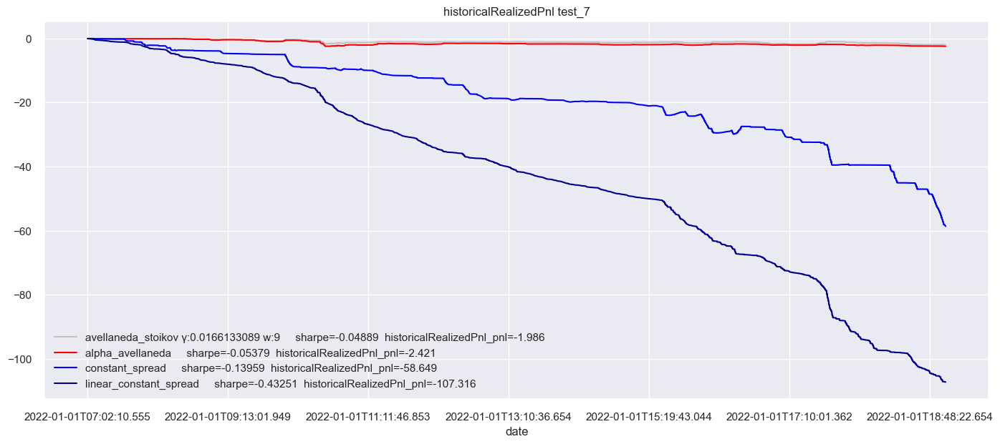

 28%|█████████████████████▌                                                        | 8/29 [1:43:49<5:27:36, 936.05s/it]

ratio winning as = 3/8
ratio winning constant = 5/8
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 13830 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 68443 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 12085 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15959 trades
plotting trade_results from 2022-01-02 07:02:01.861000 to 2022-01-02 18:59:52.980000

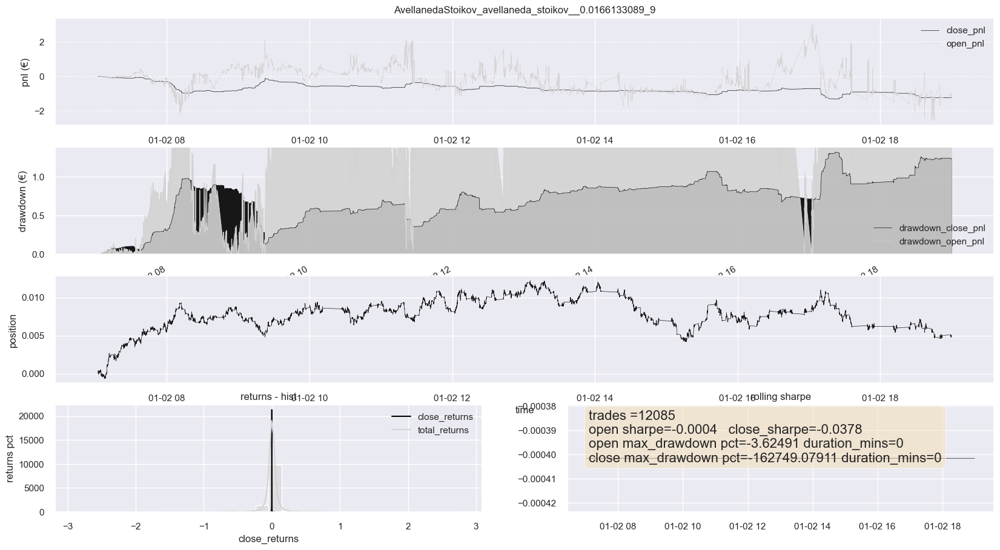

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-02 07:02:14.863000 to 2022-01-02 18:59:52.980000


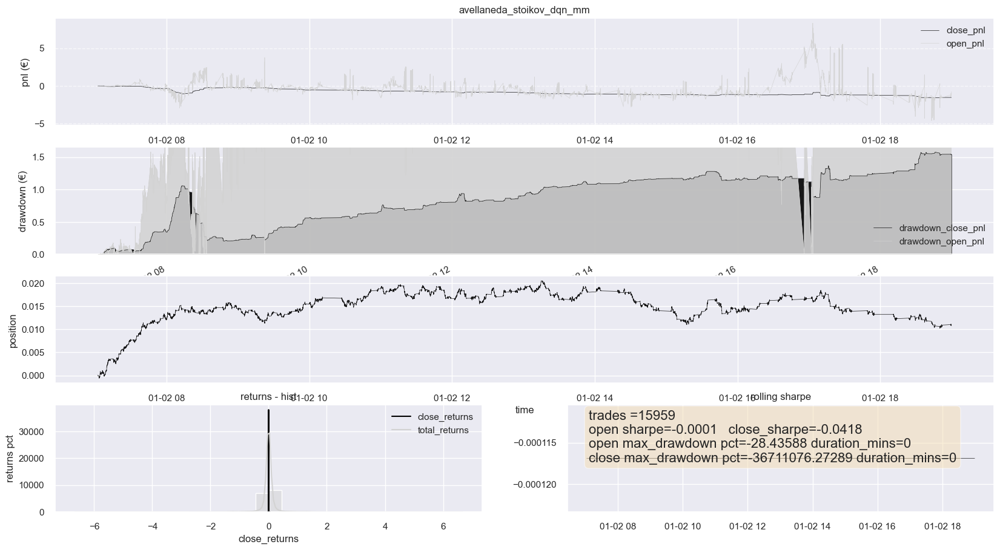

plotting params from 2022-01-02 07:02:14.863000 to 2022-01-02 18:59:52.980000


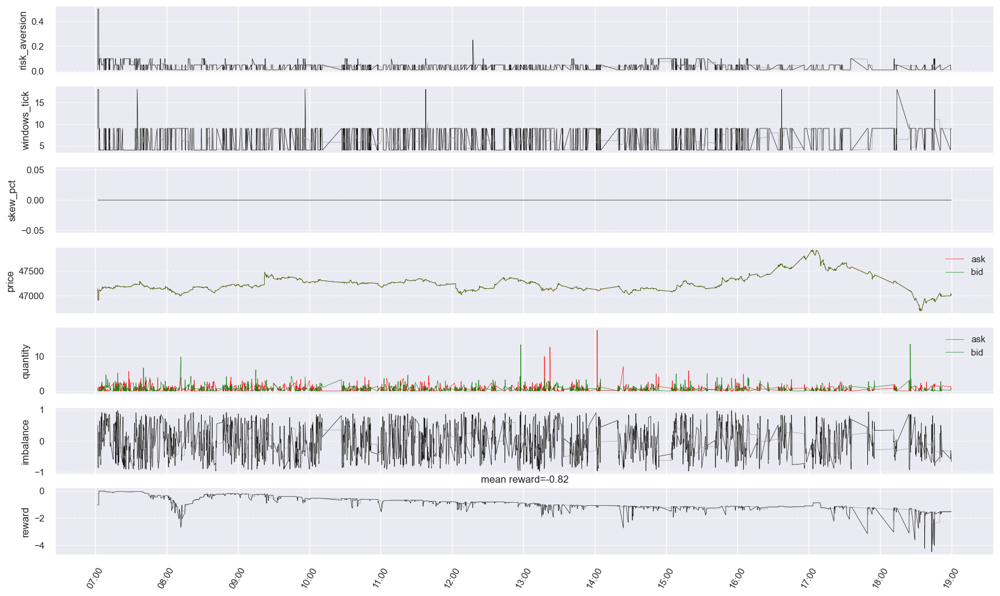

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.8882097999999713  close_pnl:-1.2258934240000037  number_trades:10818  sharpe:-0.0378277114824423   sortino:-0.06491704128619502  max_dd:1.3170486790000058  pnl_map:-115.21028404327679   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-110.61817134087843  close_pnl:-110.60167518468675  number_trades:13436  sharpe:-0.4188206826577535   sortino:-0.39786983224468303  max_dd:110.60235226166363  pnl_map:-450092.7837684876   
ConstantSpread_constant_spread  -> open_pnl:-43.74545401373099  close_pnl:-43.93296295200263  number_trades:53270  sharpe:-0.11298705859392875   sortino:-0.12934311538613988  max_dd:44.14951995200258  pnl_map:-75660.56415738721   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-0.7699562016000133  close_pnl:-1.517309483999986  number_trades:13634  sharpe:-0.041771702838378034   sortino:-0.070806927100374  max_dd:1.5770792059999883  pnl_map:-52.67760548863382   


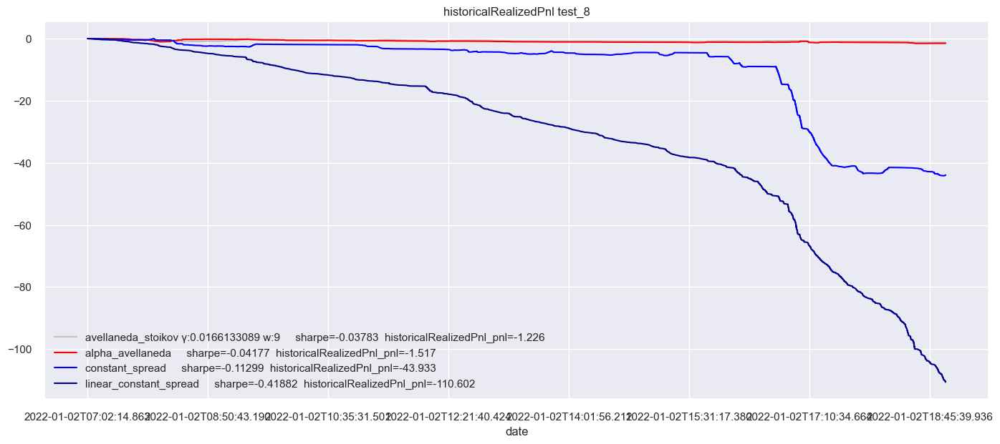

 31%|████████████████████████▏                                                     | 9/29 [2:01:05<5:22:28, 967.41s/it]

ratio winning as = 3/9
ratio winning constant = 6/9
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 16588 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 70000 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 12038 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15415 trades
plotting trade_results from 2022-01-03 07:02:00.147000 to 2022-01-03 18:58:07.210000

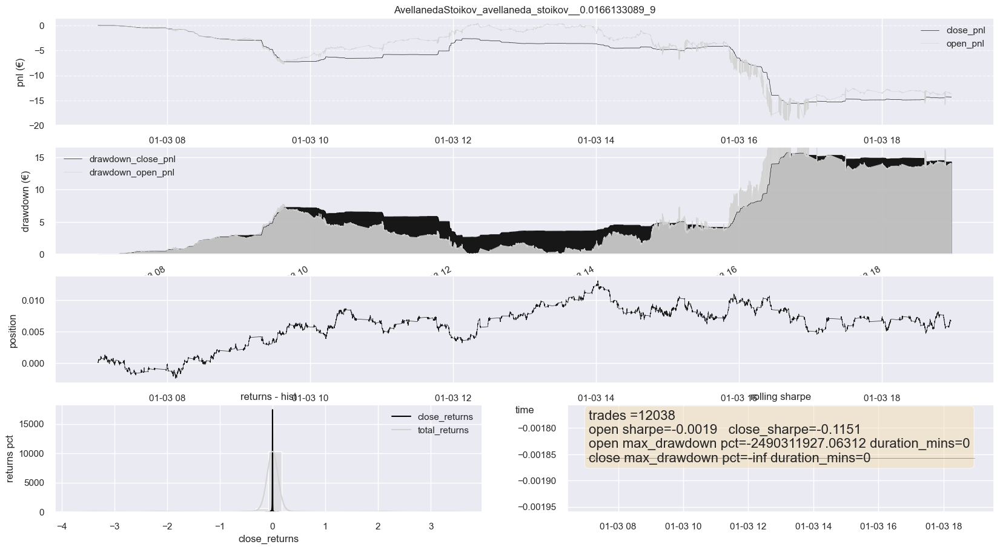

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-03 07:02:09.148000 to 2022-01-03 18:58:07.210000


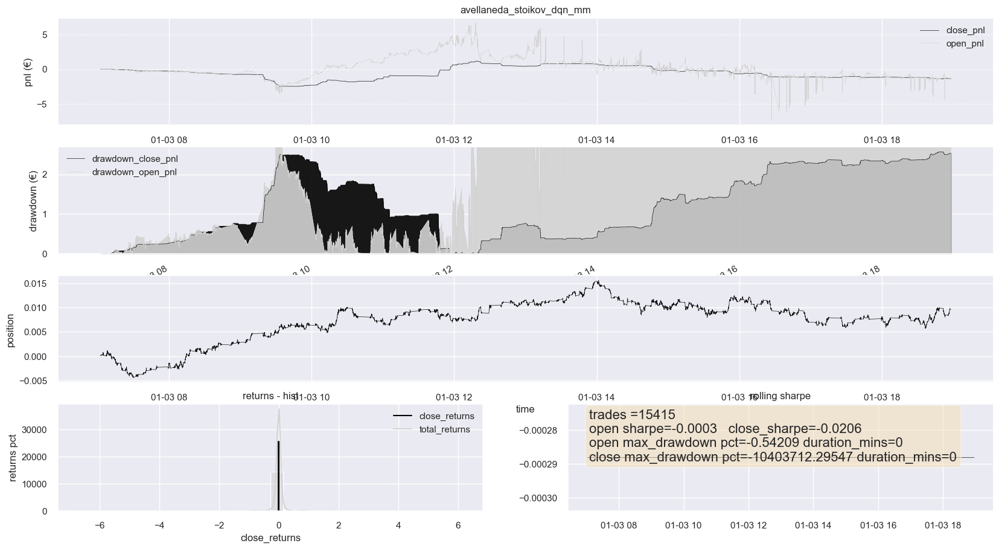

plotting params from 2022-01-03 07:02:09.148000 to 2022-01-03 18:58:07.210000


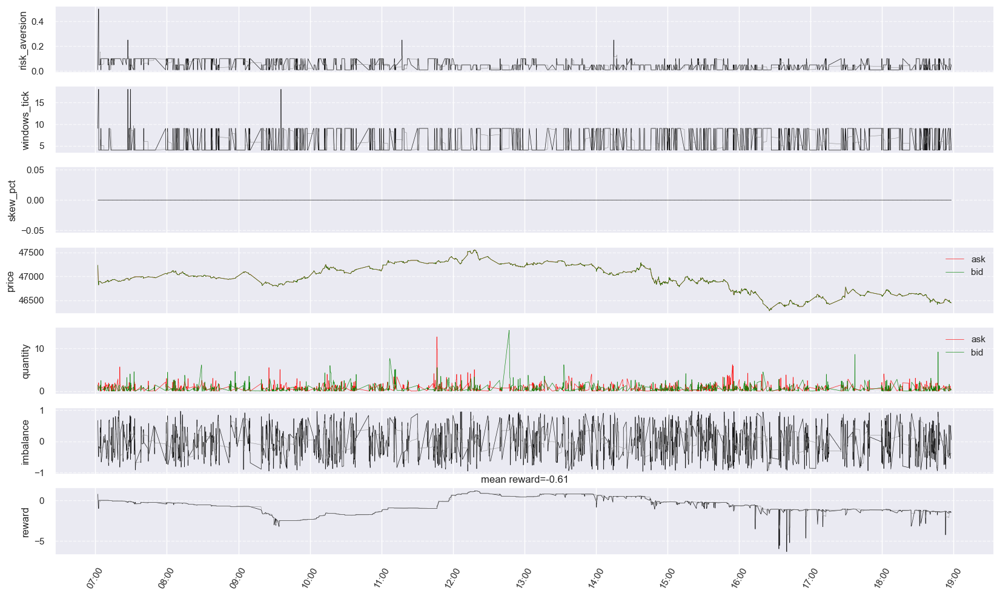

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-13.665841190337892  close_pnl:-14.314254013999813  number_trades:10887  sharpe:-0.11510275416335317   sortino:-0.15640580731246373  max_dd:15.792711853999784  pnl_map:-2206.192761275248   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-168.29942311080646  close_pnl:-168.39753466735502  number_trades:16075  sharpe:-0.4685922588528202   sortino:-0.4370122166187798  max_dd:168.39753466735502  pnl_map:-671844.3656039112   
ConstantSpread_constant_spread  -> open_pnl:-37.770582945498994  close_pnl:-37.770582945498994  number_trades:54441  sharpe:-0.1323841450912086   sortino:-0.1577420365000694  max_dd:38.74598995449896  pnl_map:-65502.285599949704   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-1.4725869639998967  close_pnl:-1.3579797220000034  number_trades:13240  sharpe:-0.020570454832007902   sortino:-0.04428176316141953  max_dd:2.562412779999991  pnl_map:-190.57425199418049   


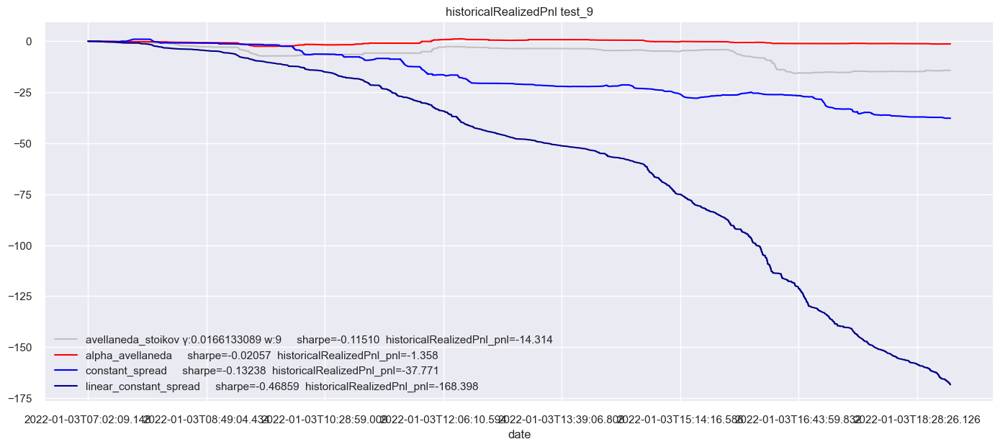

 34%|██████████████████████████▌                                                  | 10/29 [2:18:55<5:16:19, 998.91s/it]

ratio winning as = 4/10
ratio winning constant = 7/10
Parameter tuning benchmark on day 10 with data from 2022-01-03 06:00:00 to 2022-01-03 20:00:00
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 16247 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 55437 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 7234 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 8

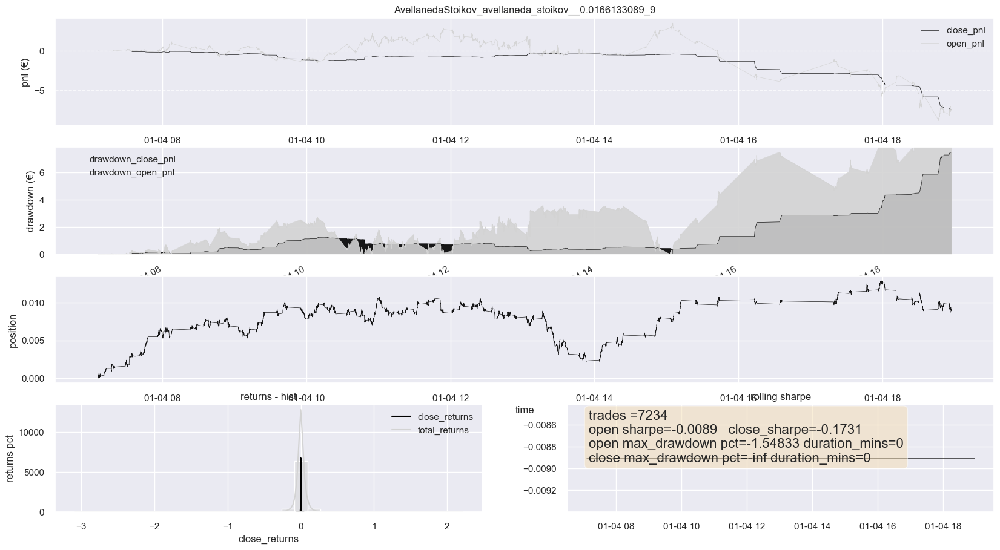

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-04 07:06:41.302000 to 2022-01-04 18:57:24.330000


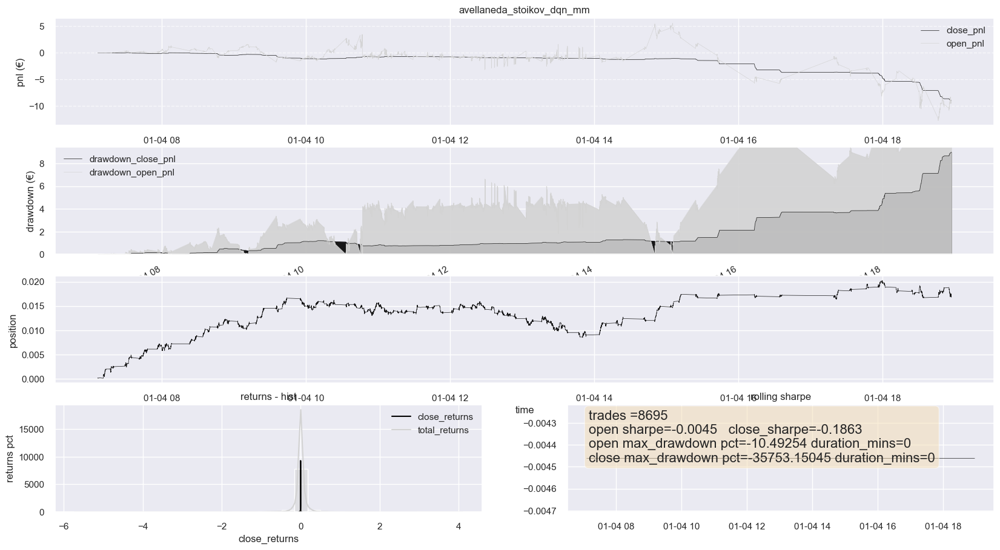

plotting params from 2022-01-04 07:06:41.302000 to 2022-01-04 18:57:24.330000


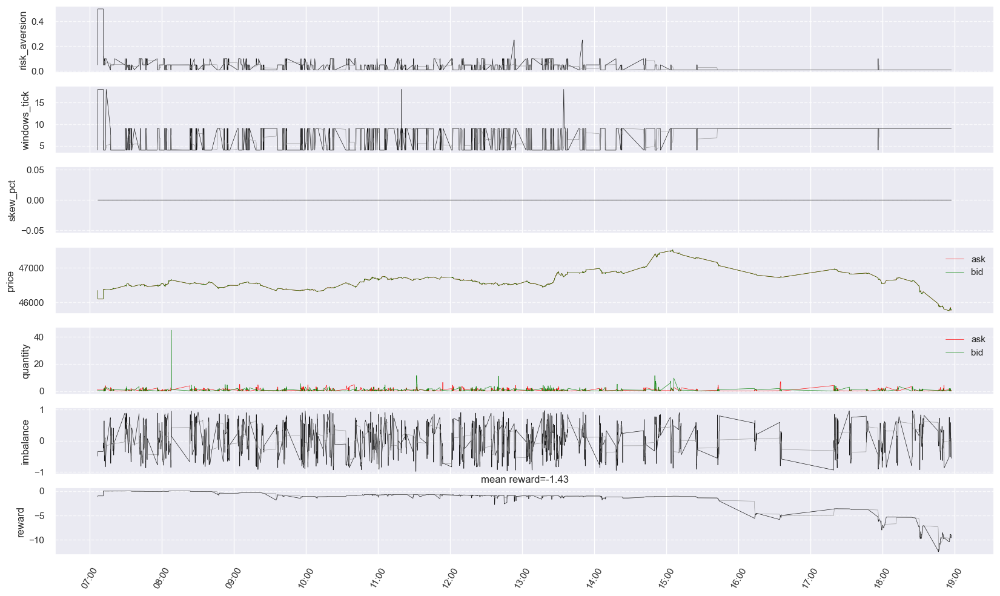

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-7.445081643814996  close_pnl:-7.508017829000024  number_trades:6639  sharpe:-0.17308570922781039   sortino:-0.18944289916194357  max_dd:7.508086763000022  pnl_map:-962.0817395259355   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-151.0901156528495  close_pnl:-151.7828230208419  number_trades:15937  sharpe:-0.3992368994623537   sortino:-0.37320907145024557  max_dd:151.7828230208419  pnl_map:-583236.4831368295   
ConstantSpread_constant_spread  -> open_pnl:-105.11702071140208  close_pnl:-106.25616193949939  number_trades:44864  sharpe:-0.2093501615581478   sortino:-0.2112402451658627  max_dd:106.26112893949941  pnl_map:-175282.5118866255   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-8.886239867454954  close_pnl:-8.952380322000021  number_trades:7681  sharpe:-0.18634291556591773   sortino:-0.19561970378692783  max_dd:8.99209513300002  pnl_map:-694.3784916028536   


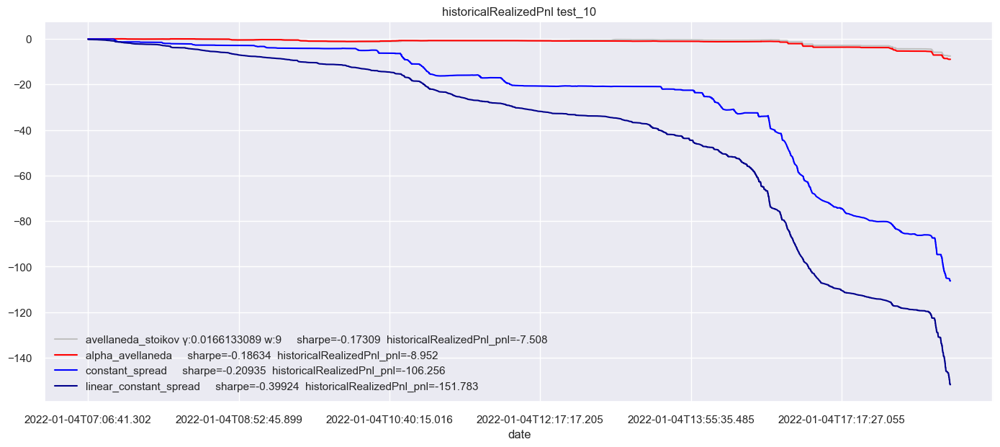

 38%|████████████████████████████▊                                               | 11/29 [2:36:34<5:05:14, 1017.46s/it]

ratio winning as = 4/11
ratio winning constant = 8/11
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 17291 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 68544 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11719 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 14249 trades
plotting trade_results from 2022-01-05 07:03:09.444000 to 2022-01-05 18:59:55.4550

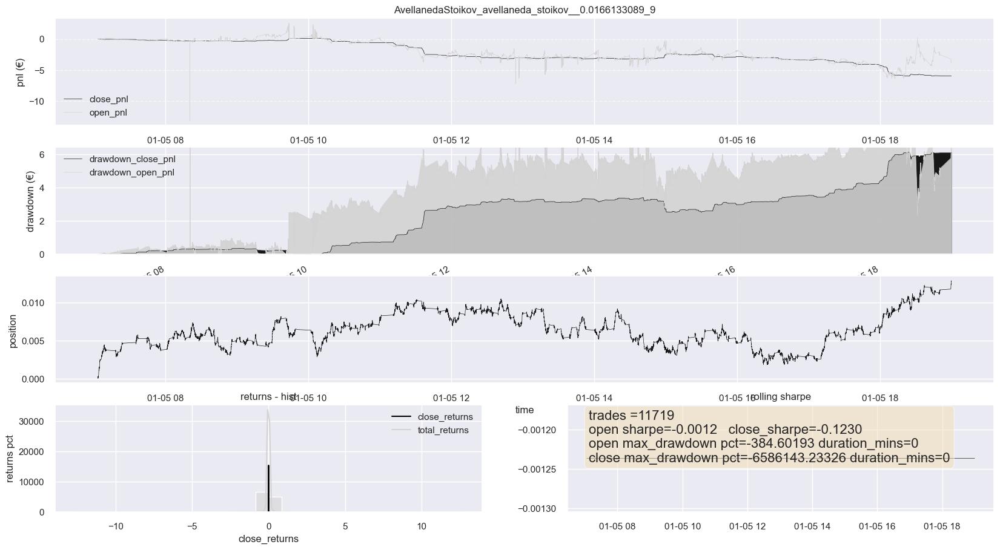

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-05 07:03:16.444000 to 2022-01-05 18:59:55.455000


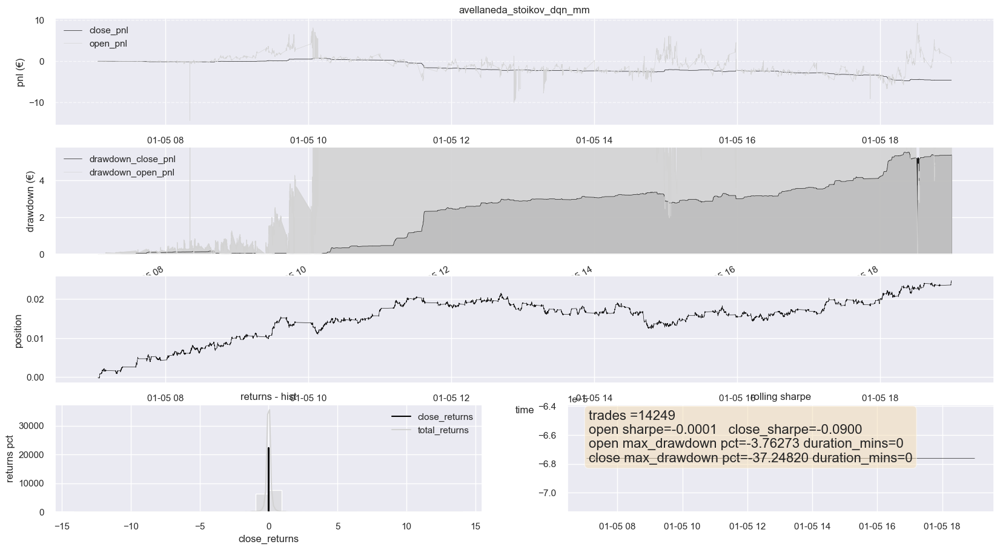

plotting params from 2022-01-05 07:03:16.444000 to 2022-01-05 18:59:55.455000


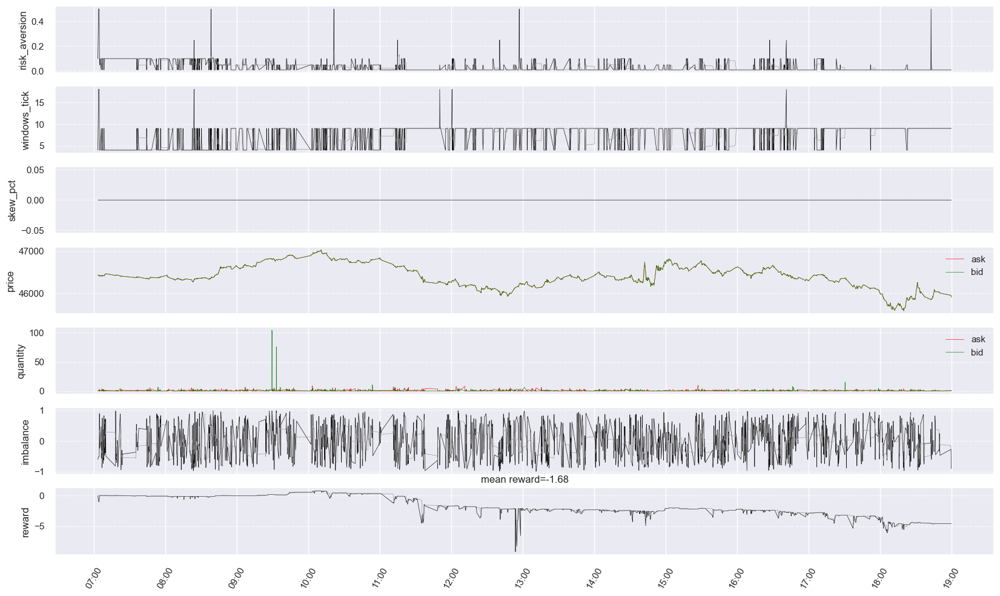

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-3.701170527278761  close_pnl:-5.951256898999992  number_trades:10708  sharpe:-0.12302533336191228   sortino:-0.16628756866392827  max_dd:6.119719376000001  pnl_map:-592.335684191275   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-194.41248880981135  close_pnl:-194.1554209855181  number_trades:16712  sharpe:-0.46985954665919616   sortino:-0.44101203373115466  max_dd:194.1557311777181  pnl_map:-761581.8279073254   
ConstantSpread_constant_spread  -> open_pnl:-27.80119804986009  close_pnl:-27.86815394124576  number_trades:53459  sharpe:-0.05370160773896066   sortino:-0.07926740295517196  max_dd:35.88785895524773  pnl_map:-46419.30525016101   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-0.4710024649519582  close_pnl:-4.623694555999991  number_trades:12536  sharpe:-0.09003669821193436   sortino:-0.13202056228808062  max_dd:5.528399784999978  pnl_map:-31.747908161496   


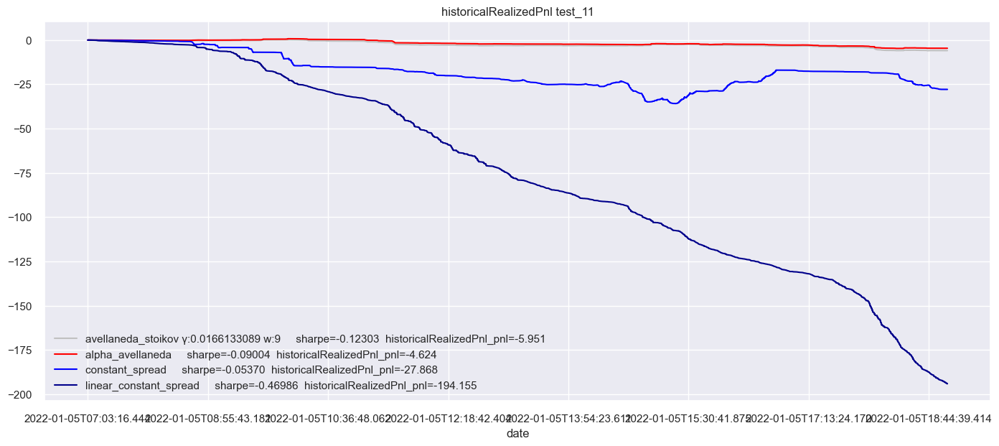

 41%|███████████████████████████████▍                                            | 12/29 [2:54:47<4:54:48, 1040.49s/it]

ratio winning as = 5/12
ratio winning constant = 8/12
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 22722 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 72579 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 14812 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15139 trades
plotting trade_results from 2022-01-06 07:02:07.317000 to 2022-01-06 18:59:45.2480

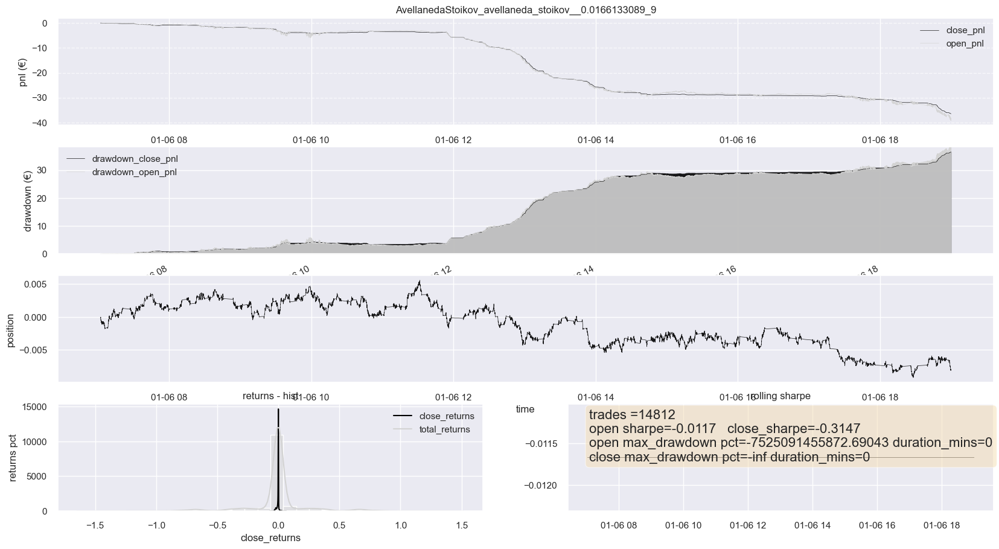

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-06 07:02:25.317000 to 2022-01-06 18:59:45.248000


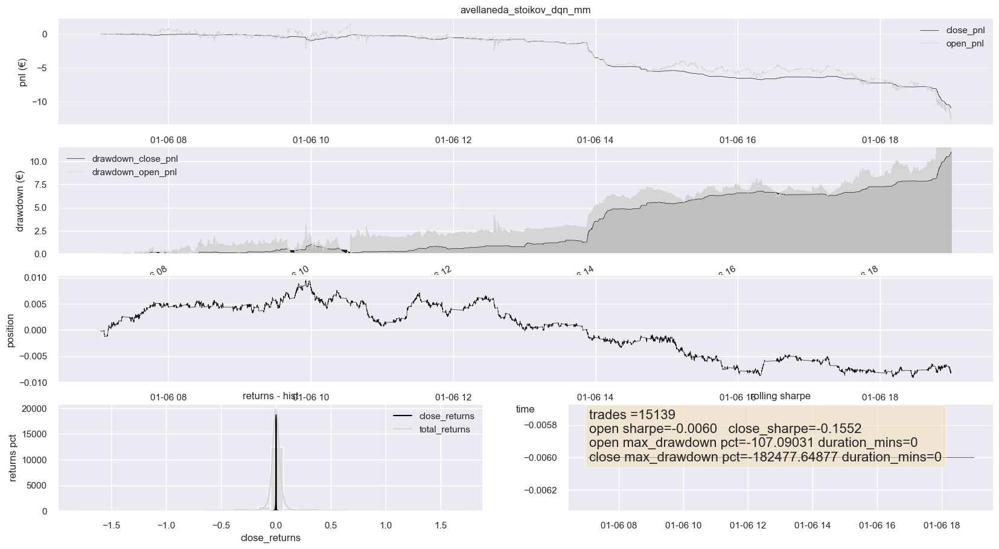

plotting params from 2022-01-06 07:02:25.317000 to 2022-01-06 18:59:45.248000


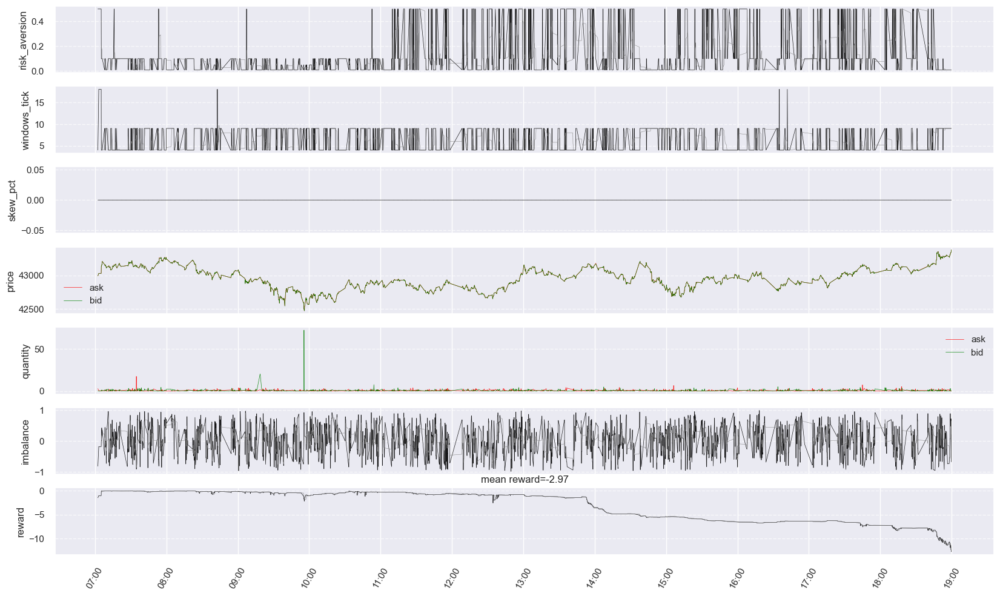

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-38.297016119401896  close_pnl:-36.499649172000254  number_trades:13749  sharpe:-0.31467621251871497   sortino:-0.3270312989359047  max_dd:36.499649172000254  pnl_map:-13181.931056324032   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-161.2757342066671  close_pnl:-161.22378548031625  number_trades:21766  sharpe:-0.5023273961528026   sortino:-0.4674182299065919  max_dd:161.22521648031625  pnl_map:-655653.6190752595   
ConstantSpread_constant_spread  -> open_pnl:-140.00659018056967  close_pnl:-140.07443095150492  number_trades:56311  sharpe:-0.27407839598763833   sortino:-0.3276847482690339  max_dd:140.0744579515049  pnl_map:-263471.39223850827   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-11.96929626648989  close_pnl:-10.999656714000091  number_trades:13436  sharpe:-0.15518498351951268   sortino:-0.18143229502661018  max_dd:11.016323387000092  pnl_map:-2628.2050802138265   


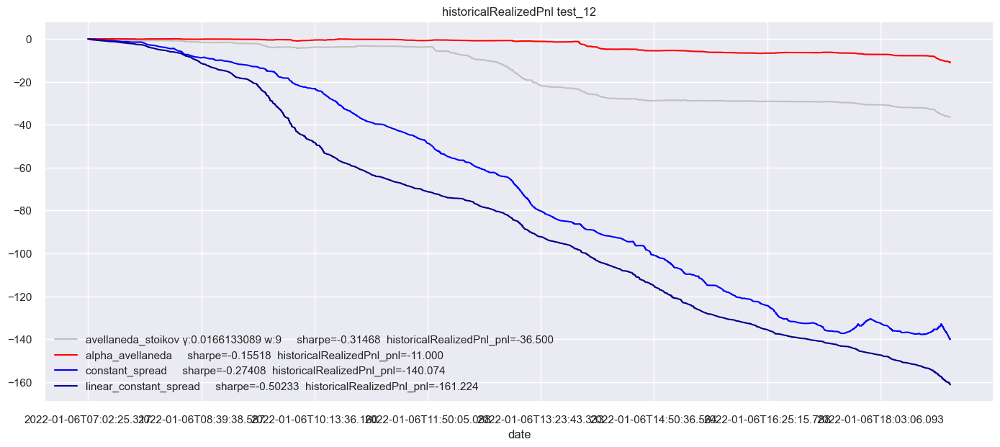

 45%|██████████████████████████████████                                          | 13/29 [3:12:52<4:40:59, 1053.74s/it]

ratio winning as = 6/13
ratio winning constant = 9/13
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 26397 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 62106 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 13320 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 11315 trades
plotting trade_results from 2022-01-07 07:02:00.234000 to 2022-01-07 18:54:49.1220

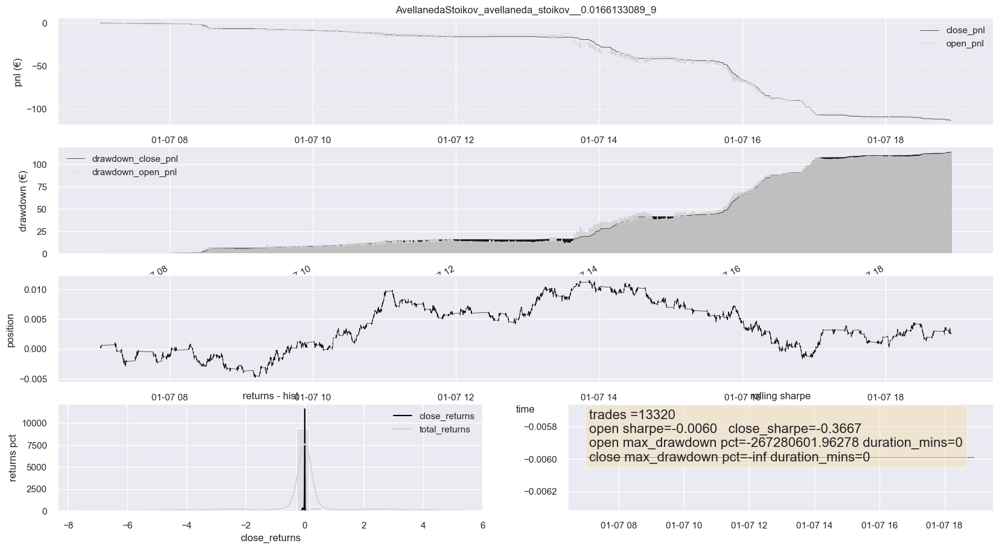

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-07 07:03:16.239000 to 2022-01-07 18:54:48.123000


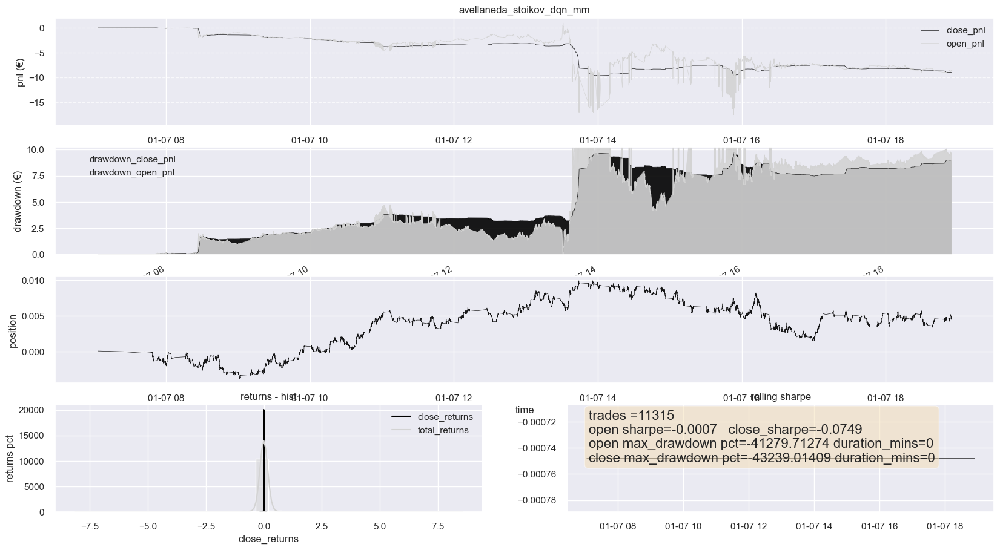

plotting params from 2022-01-07 07:03:16.239000 to 2022-01-07 18:54:48.123000


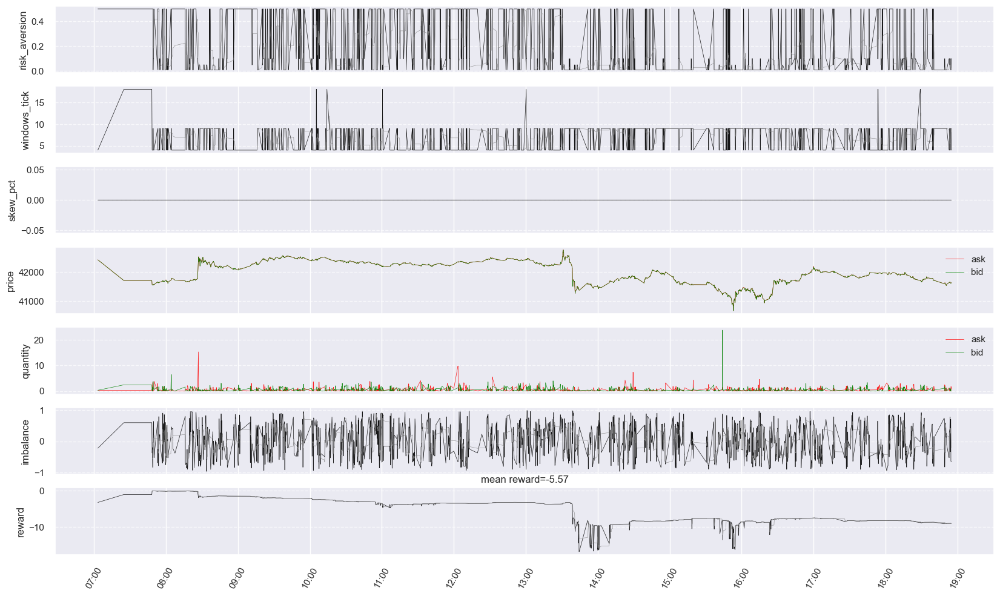

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-113.22155420673504  close_pnl:-113.8790049020006  number_trades:12527  sharpe:-0.36672975644270195   sortino:-0.35600723872575657  max_dd:113.8790049020006  pnl_map:-26599.862107755205   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-388.40312018027765  close_pnl:-388.3854135929088  number_trades:25187  sharpe:-0.4090459859178743   sortino:-0.39852523535537254  max_dd:388.40599487428125  pnl_map:-1622983.6136209816   
ConstantSpread_constant_spread  -> open_pnl:-379.3980124848187  close_pnl:-379.36303193650167  number_trades:50511  sharpe:-0.23314518081642344   sortino:-0.25138521610222986  max_dd:379.3881969365017  pnl_map:-696148.6952768195   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-8.654118435577006  close_pnl:-8.974738388000038  number_trades:10363  sharpe:-0.07494940419244568   sortino:-0.08959393649382429  max_dd:9.76018592699998  pnl_map:-1941.8744640396023   


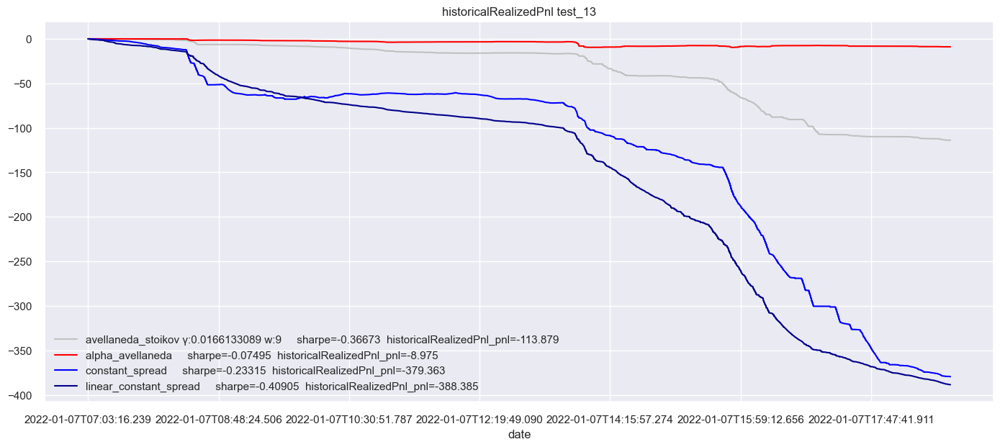

 48%|████████████████████████████████████▋                                       | 14/29 [3:31:49<4:29:45, 1079.03s/it]

ratio winning as = 7/14
ratio winning constant = 10/14
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 16632 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 53554 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 8769 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 8702 trades
plotting trade_results from 2022-01-08 07:02:01.843000 to 2022-01-08 18:54:11.79900

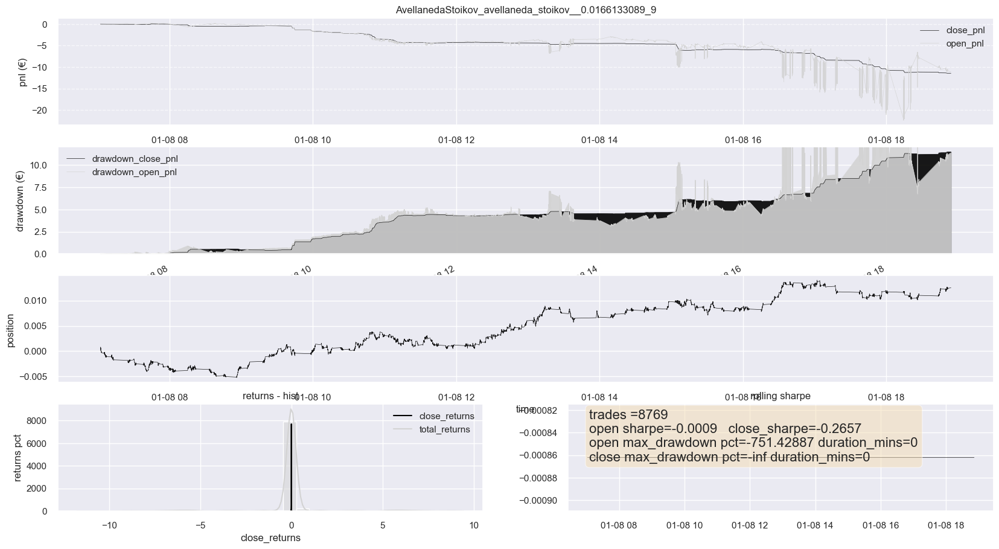

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-08 07:04:05.851000 to 2022-01-08 18:54:03.798000


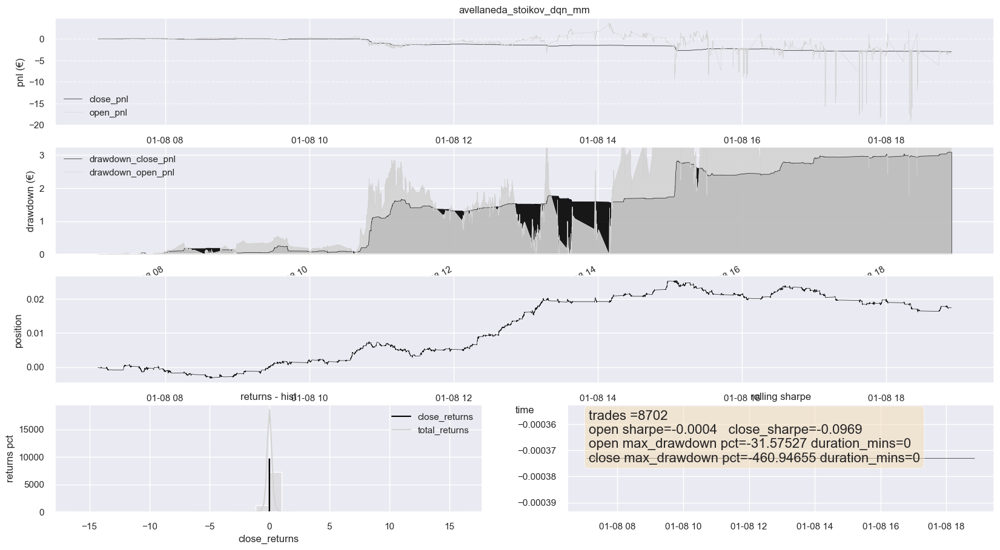

plotting params from 2022-01-08 07:04:05.851000 to 2022-01-08 18:54:03.798000


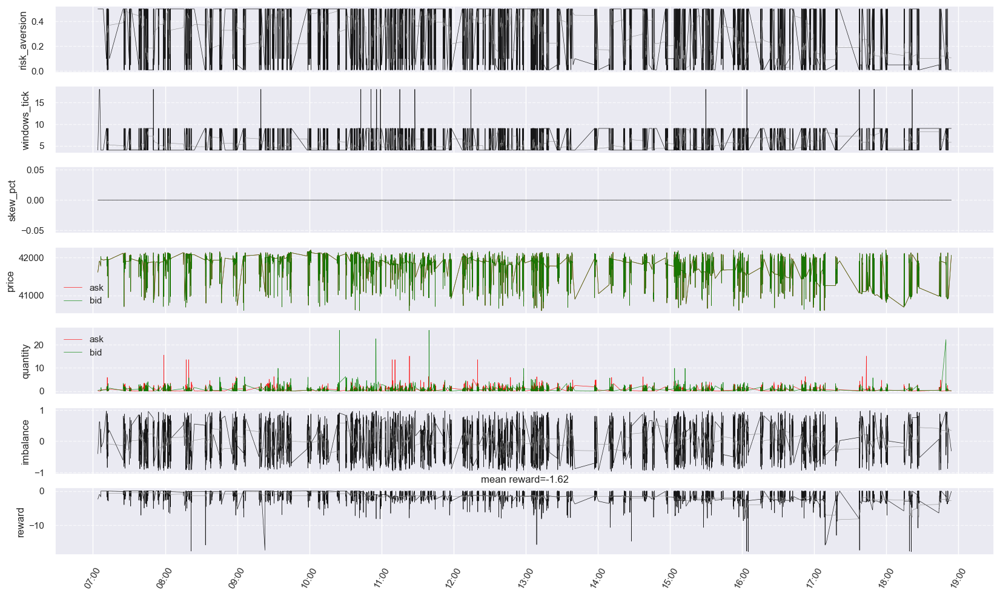

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-11.124996848518819  close_pnl:-11.442602368000186  number_trades:8097  sharpe:-0.2657172404568911   sortino:-0.2786273946181303  max_dd:11.473857503000186  pnl_map:-2013.3008641915653   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-207.72294511531445  close_pnl:-207.79495074544292  number_trades:16315  sharpe:-0.4329466249368735   sortino:-0.4001663001343725  max_dd:207.79495074544292  pnl_map:-816200.9013384669   
ConstantSpread_constant_spread  -> open_pnl:-83.18696856163005  close_pnl:-83.06022796199605  number_trades:44205  sharpe:-0.2146409173433285   sortino:-0.21542858353597574  max_dd:83.06022796199605  pnl_map:-136050.73474655856   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-3.358026703545346  close_pnl:-3.006006249000002  number_trades:7569  sharpe:-0.09692577672561281   sortino:-0.117200356970746  max_dd:3.0864555370000017  pnl_map:-283.7013233281167   


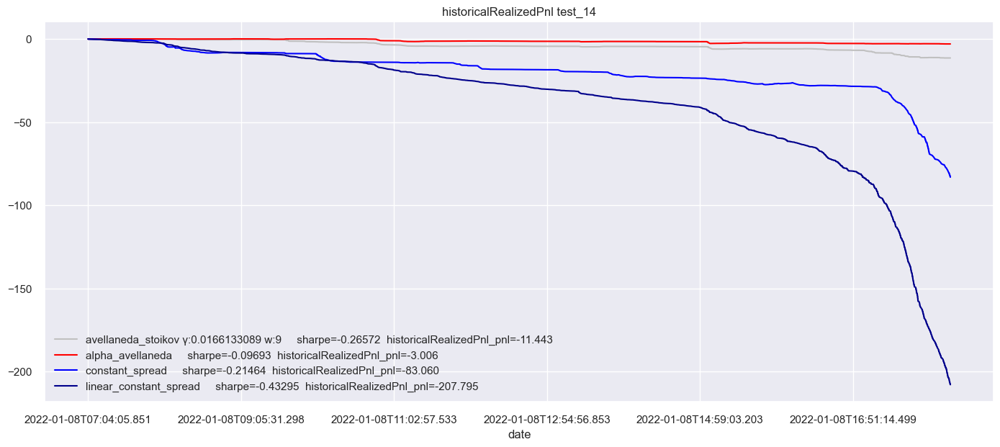

 52%|███████████████████████████████████████▎                                    | 15/29 [3:50:56<4:16:34, 1099.63s/it]

ratio winning as = 8/15
ratio winning constant = 11/15
Parameter tuning benchmark on day 15 with data from 2022-01-08 06:00:00 to 2022-01-08 20:00:00
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 16290 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 57740 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 8503 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 

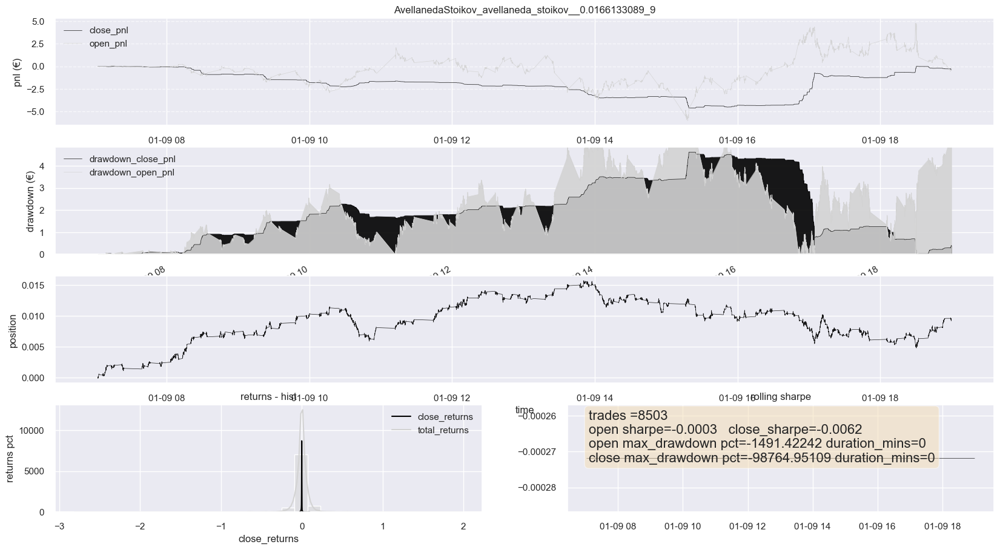

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-09 07:02:04.798000 to 2022-01-09 18:59:57.798000


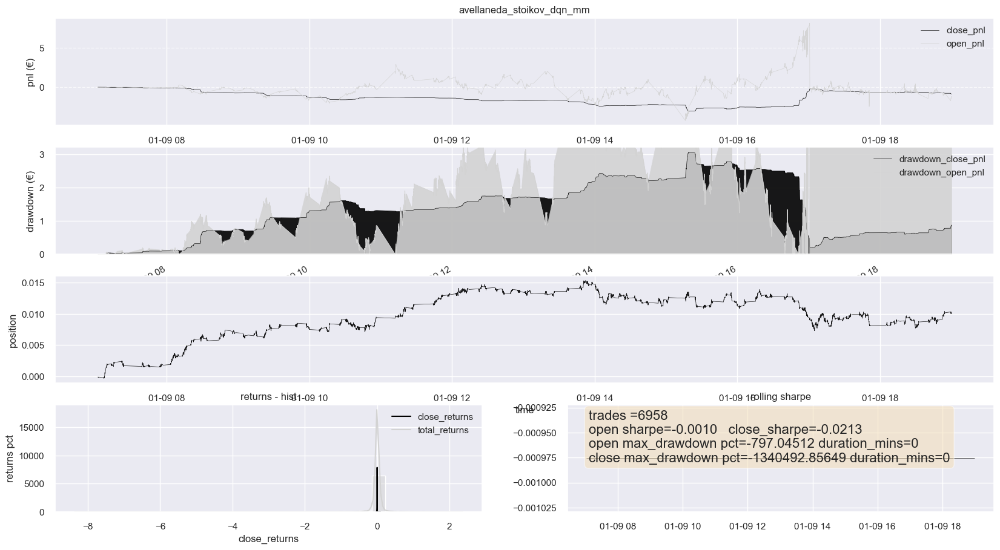

plotting params from 2022-01-09 07:02:04.798000 to 2022-01-09 18:59:57.798000


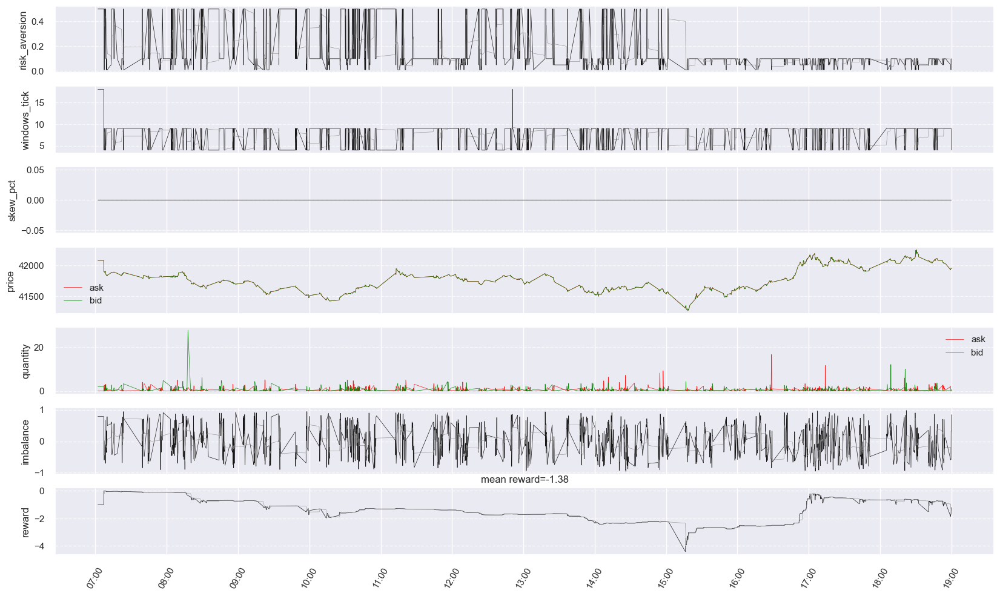

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.22550540410027736  close_pnl:-0.4036025710000095  number_trades:7893  sharpe:-0.006242944972747653   sortino:-0.015488268914919218  max_dd:4.619046231000004  pnl_map:-24.882979551732163   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-122.04663125608221  close_pnl:-122.04243276544554  number_trades:15837  sharpe:-0.49204216634178377   sortino:-0.4522787921589105  max_dd:122.04255526544554  pnl_map:-503307.2691865771   
ConstantSpread_constant_spread  -> open_pnl:-37.256427443413244  close_pnl:-37.560605874499345  number_trades:46903  sharpe:-0.11391194692057376   sortino:-0.15801885249745684  max_dd:44.68093487849888  pnl_map:-61123.313517076116   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-1.187870547610998  close_pnl:-0.8772049450000059  number_trades:6333  sharpe:-0.021271122384403405   sortino:-0.0487073663694802  max_dd:3.0602940460000068  pnl_map:-120.47997327024505   


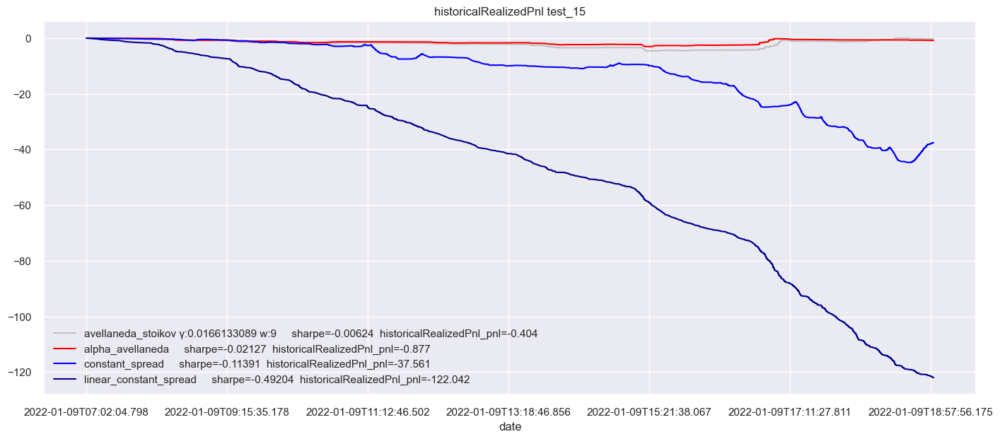

 55%|█████████████████████████████████████████▉                                  | 16/29 [4:10:17<4:02:12, 1117.86s/it]

ratio winning as = 8/16
ratio winning constant = 12/16
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 23455 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 50539 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 8704 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 6870 trades
plotting trade_results from 2022-01-10 07:02:00.874000 to 2022-01-10 18:58:58.73200

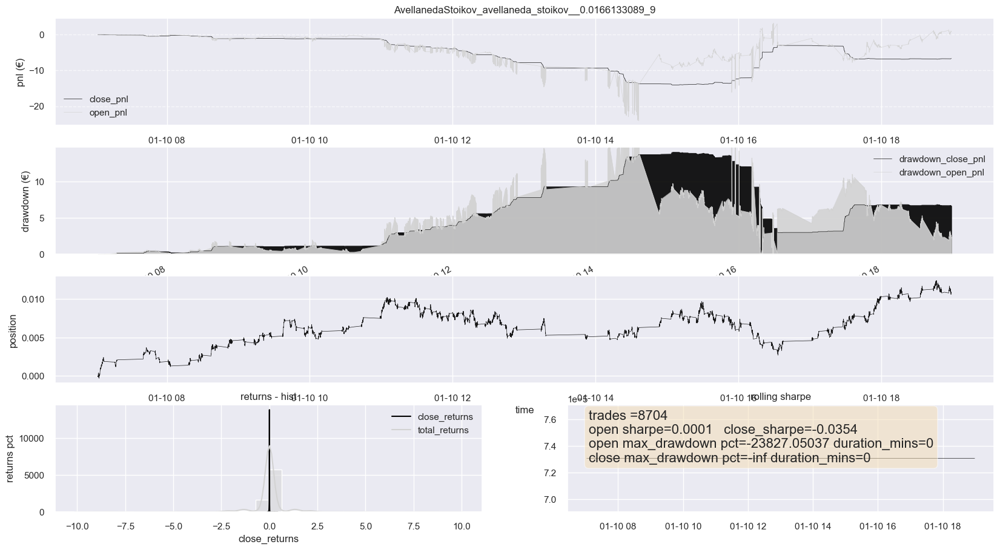

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-10 07:03:19.878000 to 2022-01-10 18:58:58.732000


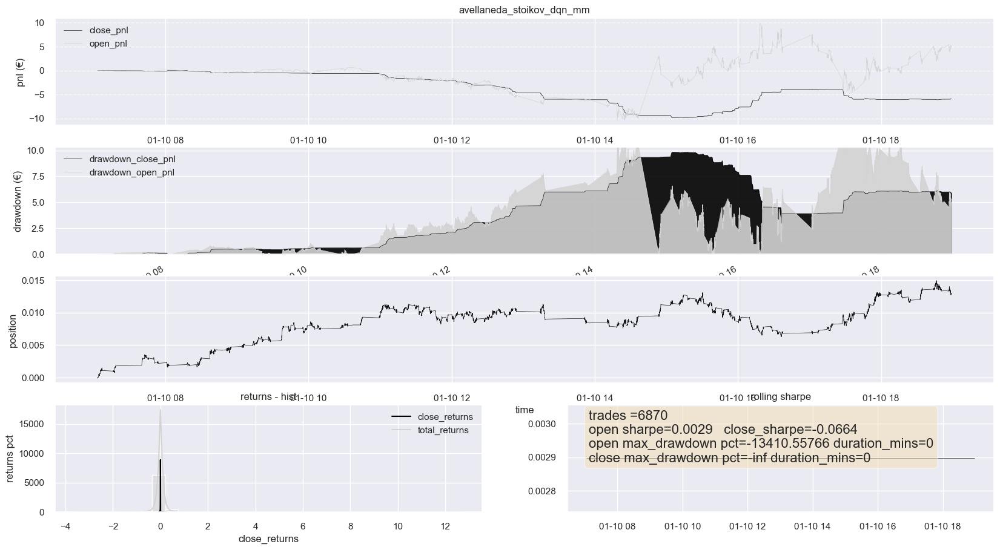

plotting params from 2022-01-10 07:03:19.878000 to 2022-01-10 18:58:58.732000


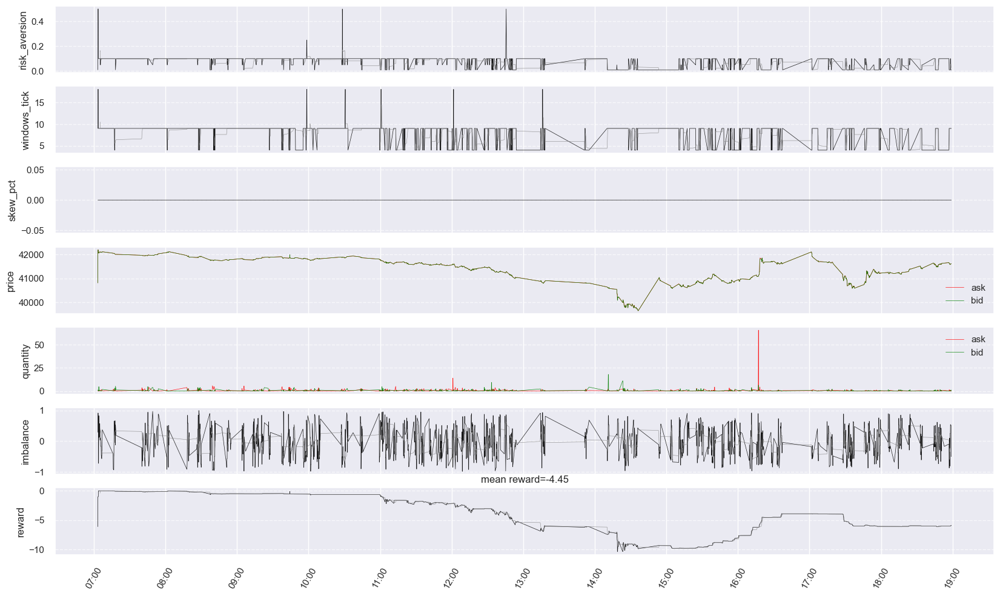

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:0.7950881960005827  close_pnl:-6.66893126800001  number_trades:8206  sharpe:-0.03541956945440726   sortino:-0.09006872416590522  max_dd:14.054732344999984  pnl_map:113.75785376468228   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-461.4076976405429  close_pnl:-461.56815069952813  number_trades:22868  sharpe:-0.43430397274869825   sortino:-0.40314973099521206  max_dd:461.5689029995281  pnl_map:-1997926.657128009   
ConstantSpread_constant_spread  -> open_pnl:-405.998231991238  close_pnl:-406.6017899379994  number_trades:43158  sharpe:-0.22794274194184277   sortino:-0.2331973490654348  max_dd:406.6240199379995  pnl_map:-706116.0773955104   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:4.898008154416977  close_pnl:-5.89289430200002  number_trades:6477  sharpe:-0.06636405627161891   sortino:-0.12918779635314442  max_dd:9.832116995000016  pnl_map:532.0066786115474   


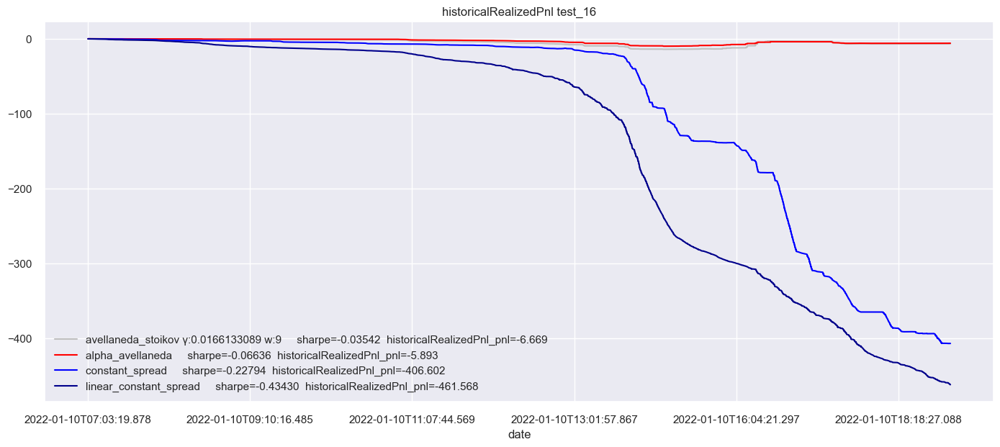

 59%|████████████████████████████████████████████▌                               | 17/29 [4:29:58<3:47:24, 1137.08s/it]

ratio winning as = 8/17
ratio winning constant = 13/17
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 23353 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 67003 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 14649 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 15301 trades
plotting trade_results from 2022-01-11 07:02:00.767000 to 2022-01-11 18:59:57.684

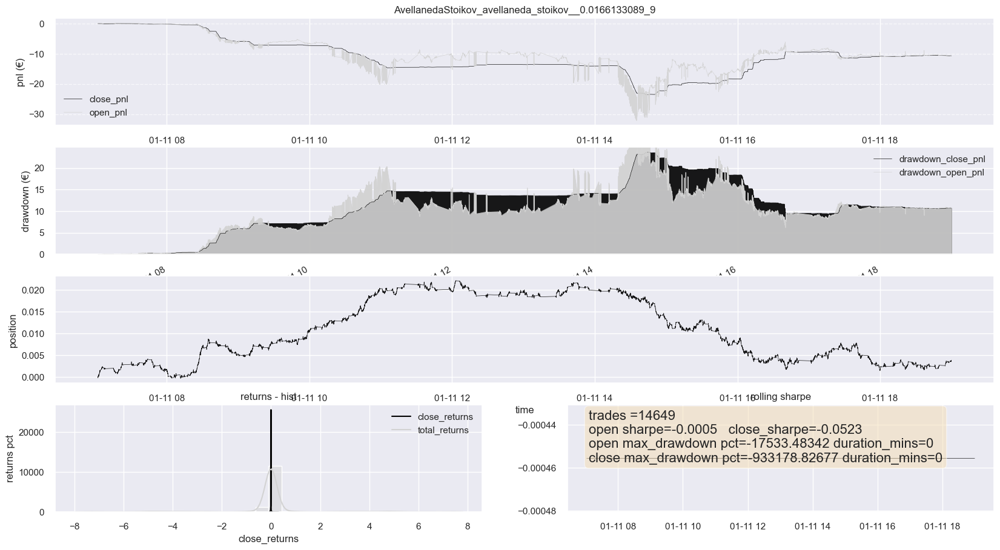

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-11 07:02:27.770000 to 2022-01-11 18:59:57.684000


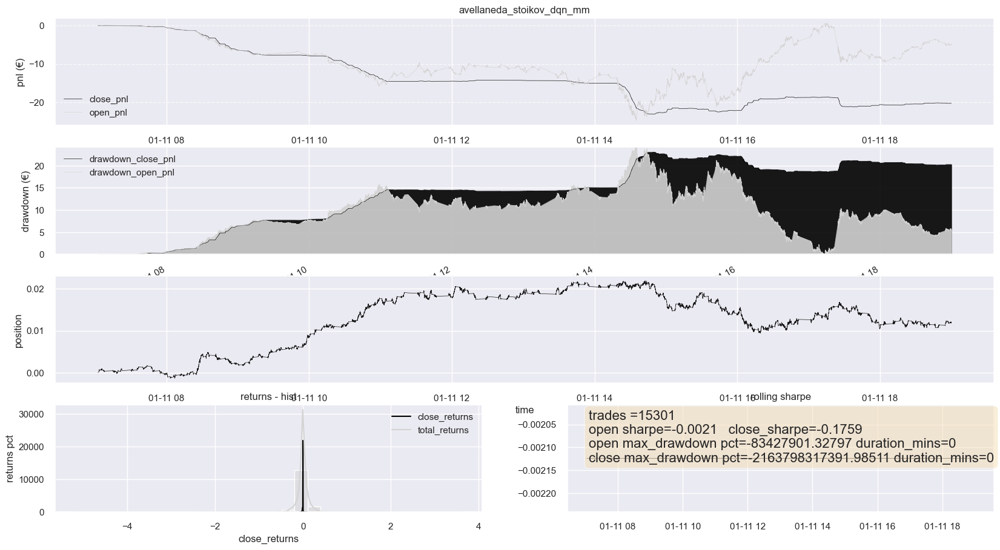

plotting params from 2022-01-11 07:02:27.770000 to 2022-01-11 18:59:57.684000


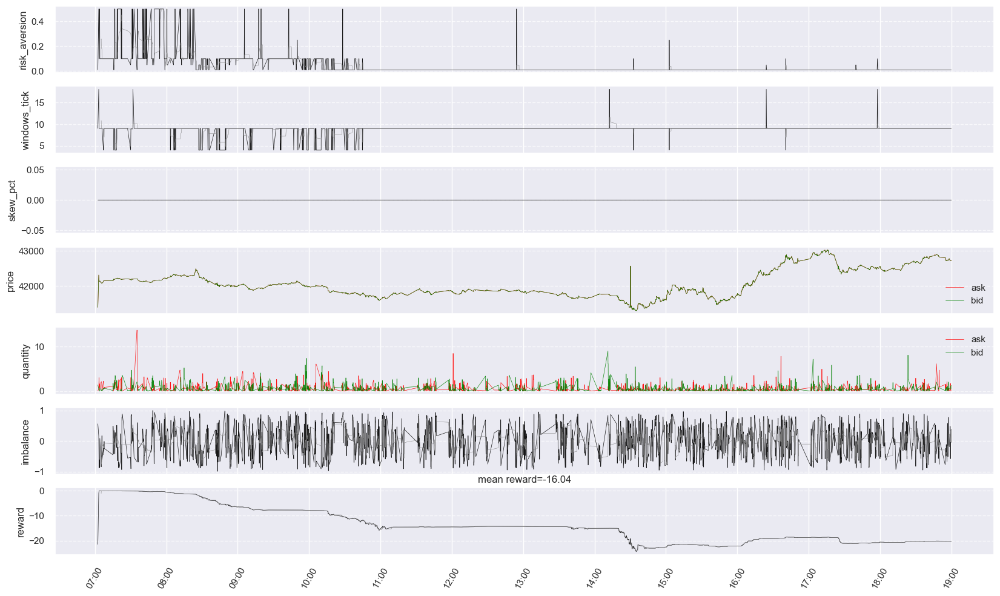

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-10.566578559111019  close_pnl:-10.666606217999938  number_trades:13529  sharpe:-0.052295146514520795   sortino:-0.10330235193404365  max_dd:23.65665782099967  pnl_map:-1033.7431801343796   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-308.10098383244883  close_pnl:-308.07956914076993  number_trades:22157  sharpe:-0.38279524908588325   sortino:-0.37615375841921267  max_dd:308.07956914076993  pnl_map:-1308557.1947640872   
ConstantSpread_constant_spread  -> open_pnl:-92.98445101376946  close_pnl:-93.558979919502  number_trades:52885  sharpe:-0.08860359471335649   sortino:-0.11497640689390239  max_dd:116.68576992500074  pnl_map:-151898.09735433318   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-4.7922646953417605  close_pnl:-20.26727655500005  number_trades:13914  sharpe:-0.17589487729946685   sortino:-0.22959623332717338  max_dd:23.055778947000046  pnl_map:-351.96427532508693   


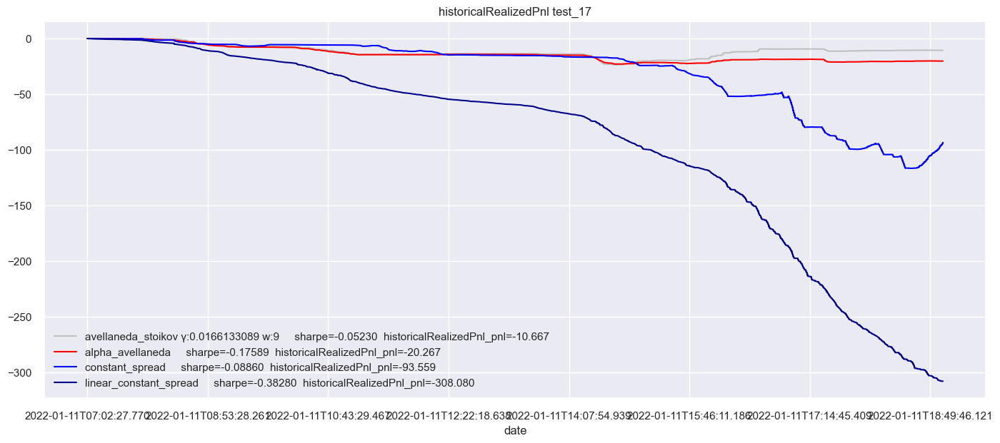

 62%|███████████████████████████████████████████████▏                            | 18/29 [4:50:11<3:32:38, 1159.91s/it]

ratio winning as = 8/18
ratio winning constant = 13/18
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 20184 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 67124 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11414 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 7542 trades
plotting trade_results from 2022-01-12 07:02:08.753000 to 2022-01-12 18:59:38.7040

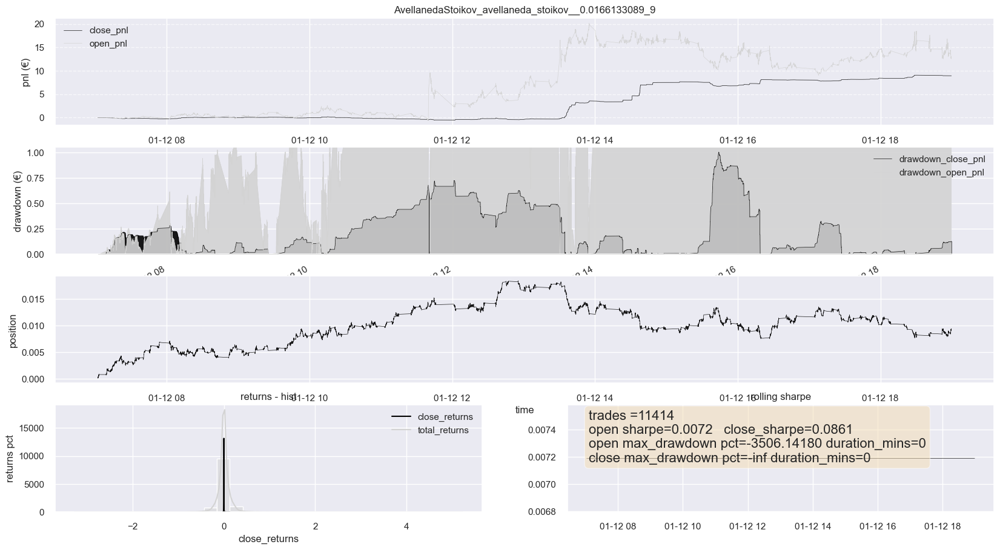

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-12 07:02:10.755000 to 2022-01-12 18:59:38.704000


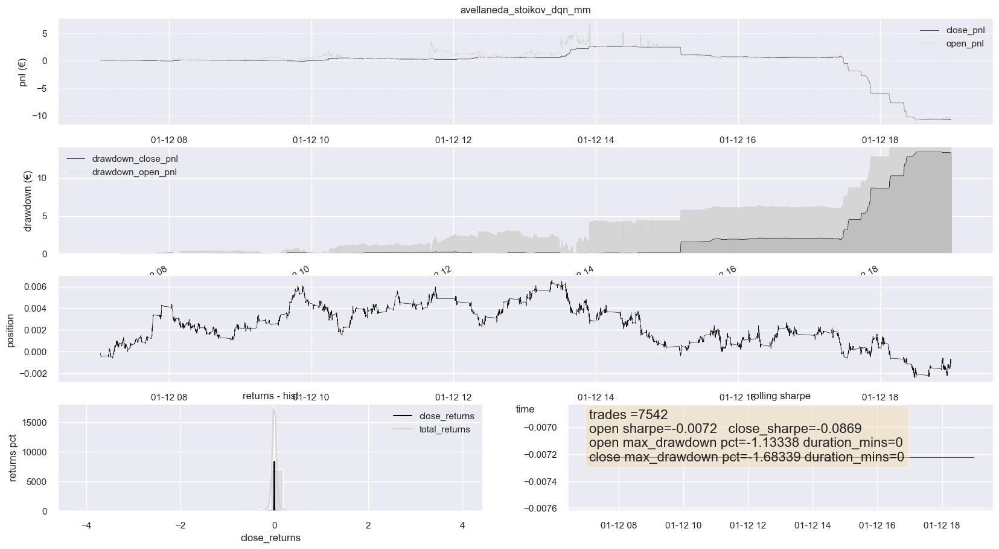

plotting params from 2022-01-12 07:02:10.755000 to 2022-01-12 18:59:38.704000


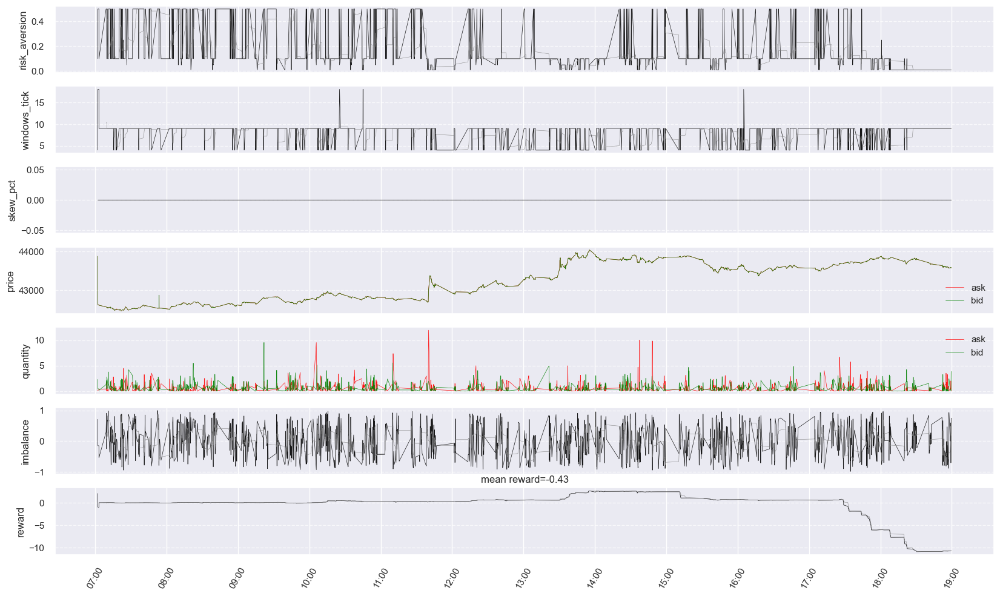

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:12.626925901374946  close_pnl:8.93865701699997  number_trades:10555  sharpe:0.08606561866811904   sortino:0.4558543418422242  max_dd:1.0054495999999977  pnl_map:1282.4598195089886   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-288.1736178460946  close_pnl:-288.1826855024632  number_trades:19532  sharpe:-0.4227391430817766   sortino:-0.4020033920257141  max_dd:288.1827685024632  pnl_map:-1175563.1666059475   
ConstantSpread_constant_spread  -> open_pnl:-156.7706034739629  close_pnl:-156.65870995700388  number_trades:53028  sharpe:-0.15162362452024108   sortino:-0.17278727400387048  max_dd:157.99539296450277  pnl_map:-271600.2443582293   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-10.508536859958928  close_pnl:-10.696839491000528  number_trades:6910  sharpe:-0.08690626032444355   sortino:-0.09577686947517648  max_dd:13.438039888000507  pnl_map:-4050.3168485724045   


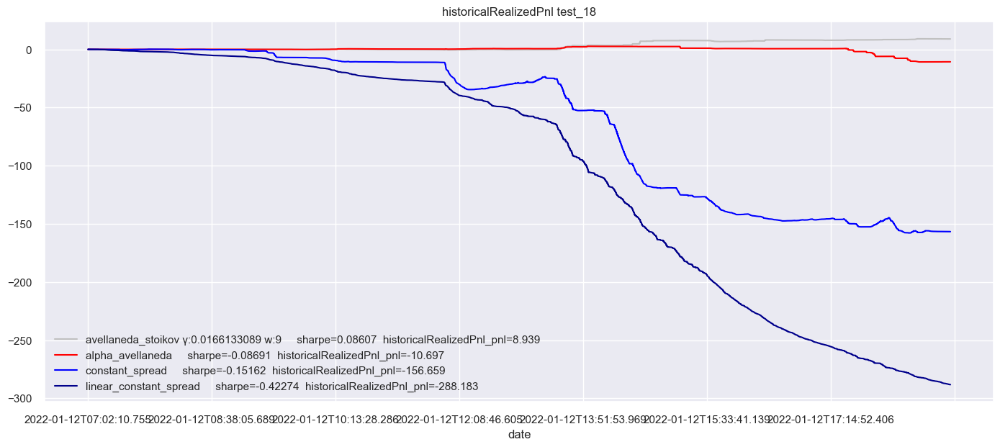

 66%|█████████████████████████████████████████████████▊                          | 19/29 [5:10:15<3:15:29, 1172.94s/it]

ratio winning as = 8/19
ratio winning constant = 14/19
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 19035 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 67348 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11497 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 9498 trades
plotting trade_results from 2022-01-13 07:02:00.774000 to 2022-01-13 18:37:31.6660

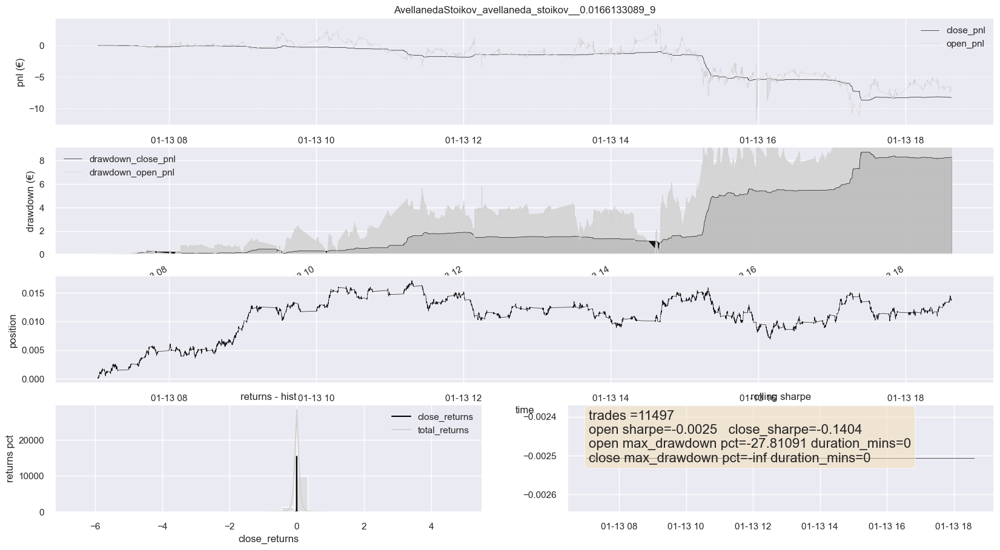

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-13 07:03:17.777000 to 2022-01-13 18:37:31.666000


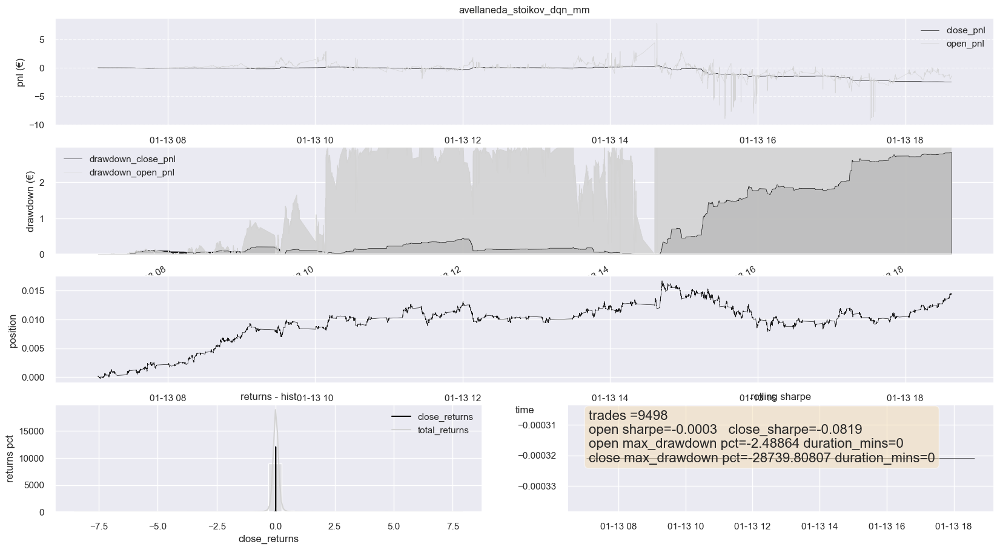

plotting params from 2022-01-13 07:03:17.777000 to 2022-01-13 18:37:31.666000


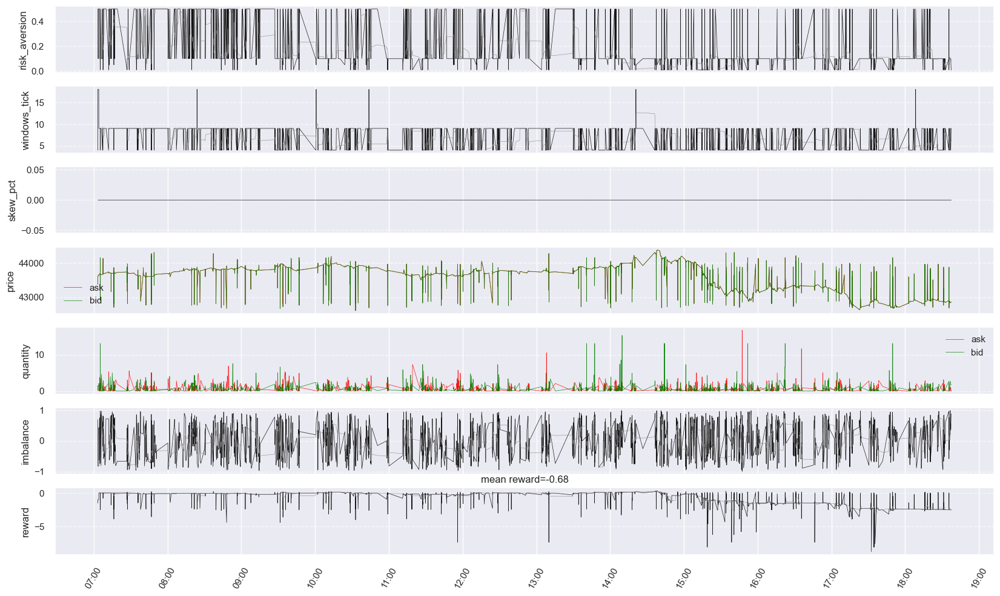

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-6.829583009228075  close_pnl:-8.291433955000043  number_trades:10533  sharpe:-0.14042237439510447   sortino:-0.16049473630464509  max_dd:8.72548911200002  pnl_map:-645.2501451004141   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-242.82158983874282  close_pnl:-242.48068360965374  number_trades:18412  sharpe:-0.38886319693744137   sortino:-0.3753741557318102  max_dd:242.48068360965374  pnl_map:-900563.414715938   
ConstantSpread_constant_spread  -> open_pnl:-17.100214625373226  close_pnl:-16.45708993949876  number_trades:52906  sharpe:-0.059034689662175045   sortino:-0.0870639249469235  max_dd:18.73719794749877  pnl_map:-28034.489879325025   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-1.6026643651432022  close_pnl:-2.5211487160000132  number_trades:8402  sharpe:-0.08192316590012316   sortino:-0.10811327305458442  max_dd:2.842447759000004  pnl_map:-160.25918115025485   


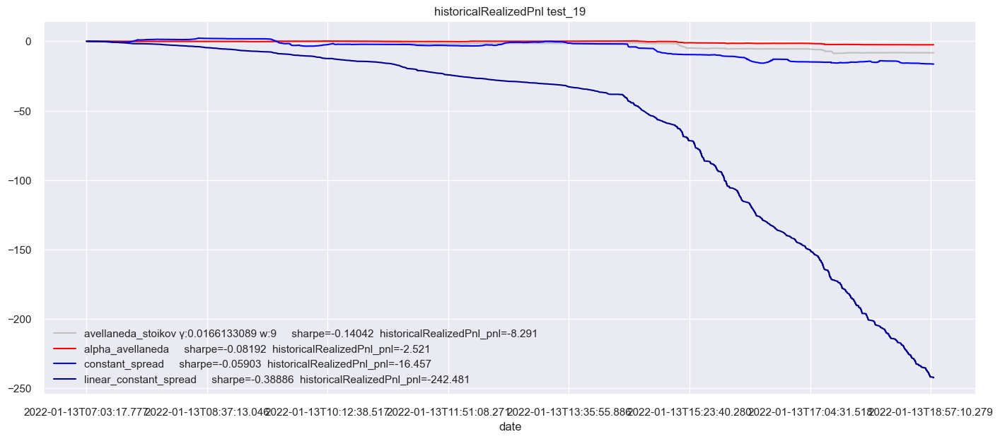

 69%|████████████████████████████████████████████████████▍                       | 20/29 [5:29:46<2:55:51, 1172.40s/it]

ratio winning as = 9/20
ratio winning constant = 14/20
Parameter tuning benchmark on day 20 with data from 2022-01-13 06:00:00 to 2022-01-13 20:00:00
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 18468 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 57704 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 9811 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 

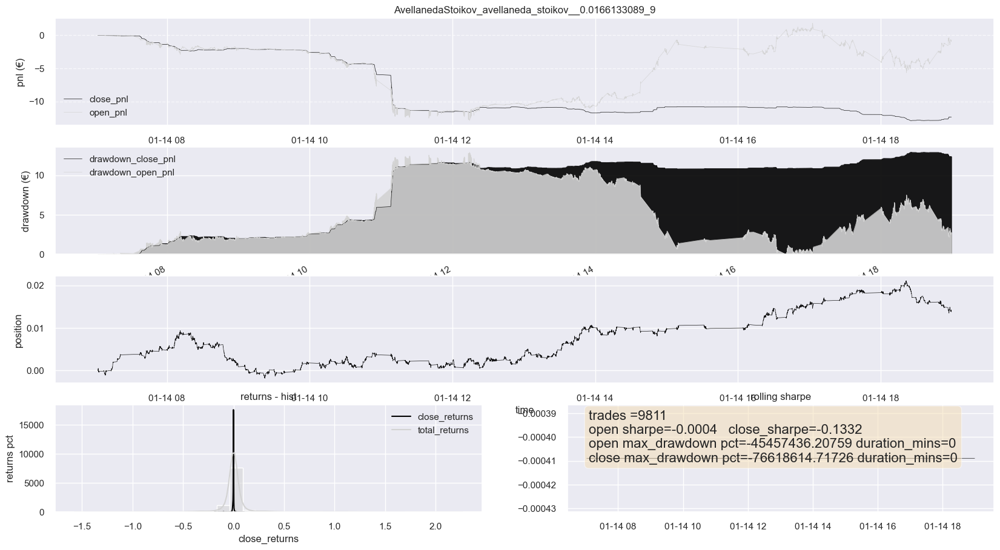

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-14 07:02:16.752000 to 2022-01-14 18:59:28.693000


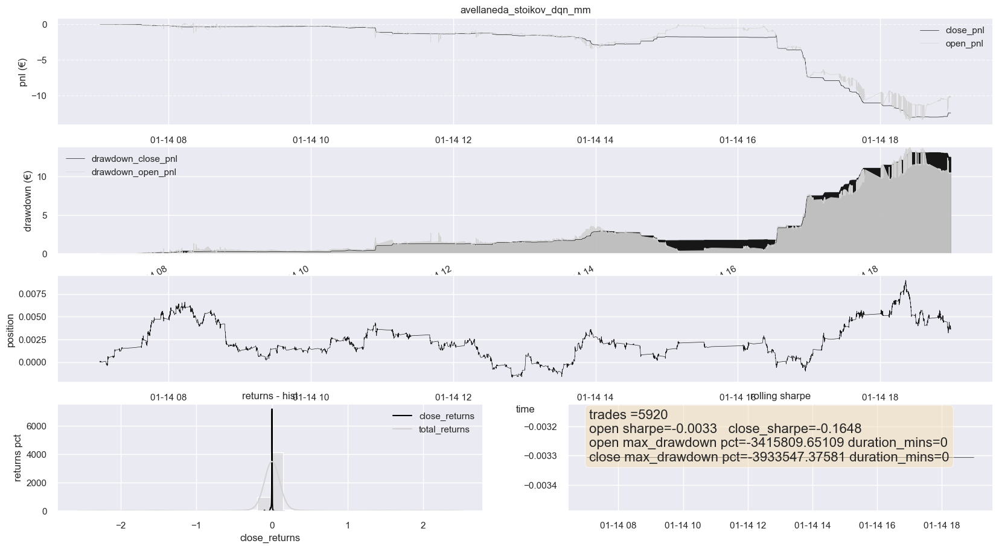

plotting params from 2022-01-14 07:02:16.752000 to 2022-01-14 18:59:28.693000


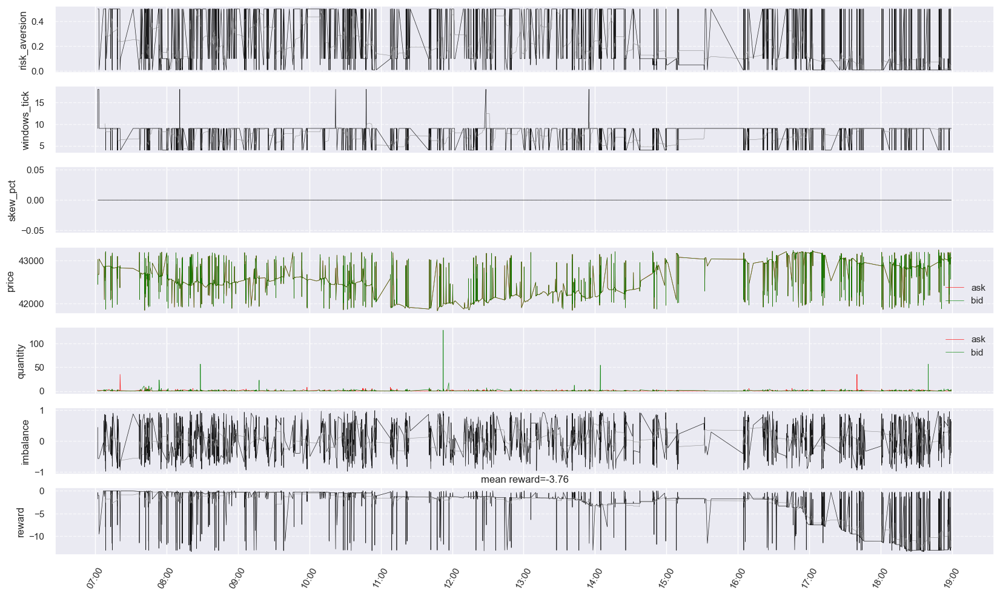

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-0.7775257326561871  close_pnl:-12.376693373999943  number_trades:9163  sharpe:-0.13324557651922384   sortino:-0.14600599481809554  max_dd:12.920516351999936  pnl_map:-109.46289507005979   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-273.179712287355  close_pnl:-273.1581692471957  number_trades:18068  sharpe:-0.43071890189555423   sortino:-0.4004956161383033  max_dd:273.1581692471957  pnl_map:-1057606.1813274566   
ConstantSpread_constant_spread  -> open_pnl:-57.759074946003494  close_pnl:-57.759074946003494  number_trades:47024  sharpe:-0.08517971433104564   sortino:-0.10346134764787285  max_dd:71.72544698600049  pnl_map:-94035.53452088787   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-10.258228124787154  close_pnl:-12.491270995999994  number_trades:5393  sharpe:-0.16480787473911873   sortino:-0.18239721936443687  max_dd:13.158100982999999  pnl_map:-3351.7330532568717   


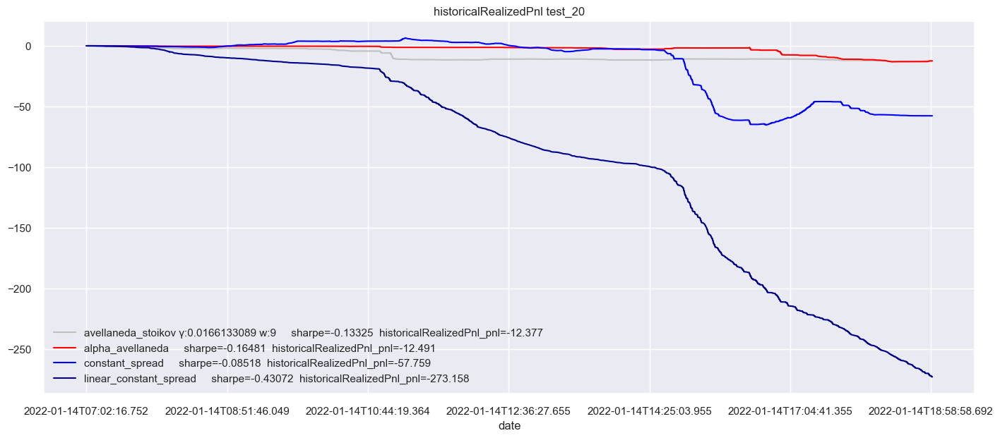

 72%|███████████████████████████████████████████████████████                     | 21/29 [5:50:28<2:39:06, 1193.30s/it]

ratio winning as = 9/21
ratio winning constant = 14/21
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 14752 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 61730 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 10136 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 5320 trades
plotting trade_results from 2022-01-15 07:02:01.793000 to 2022-01-15 18:59:55.8520

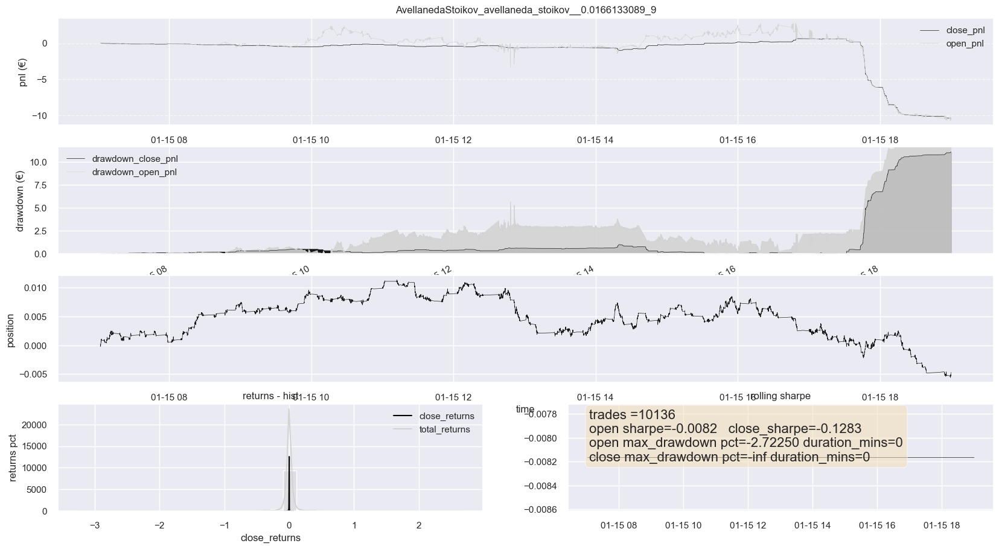

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-15 07:02:03.793000 to 2022-01-15 18:59:49.850000


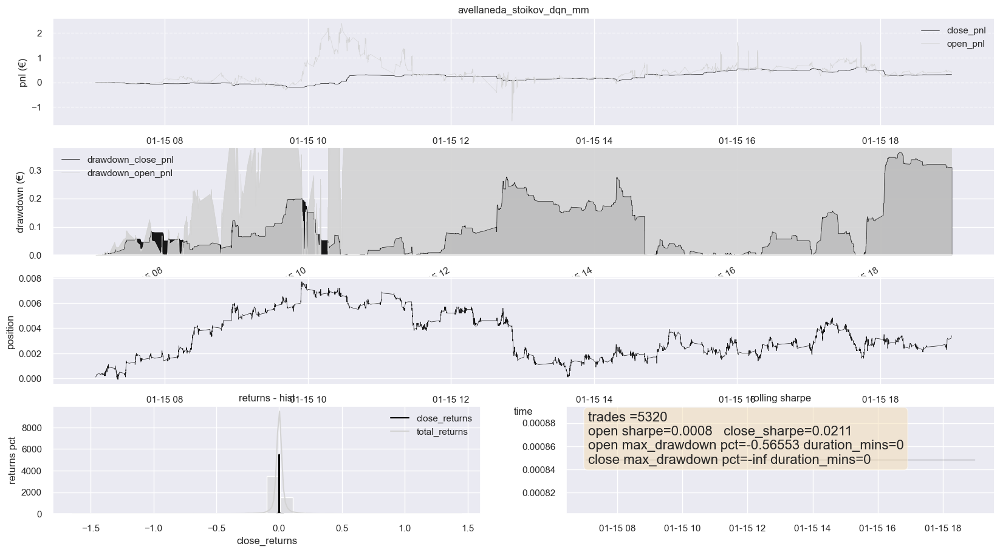

plotting params from 2022-01-15 07:02:03.793000 to 2022-01-15 18:59:49.850000


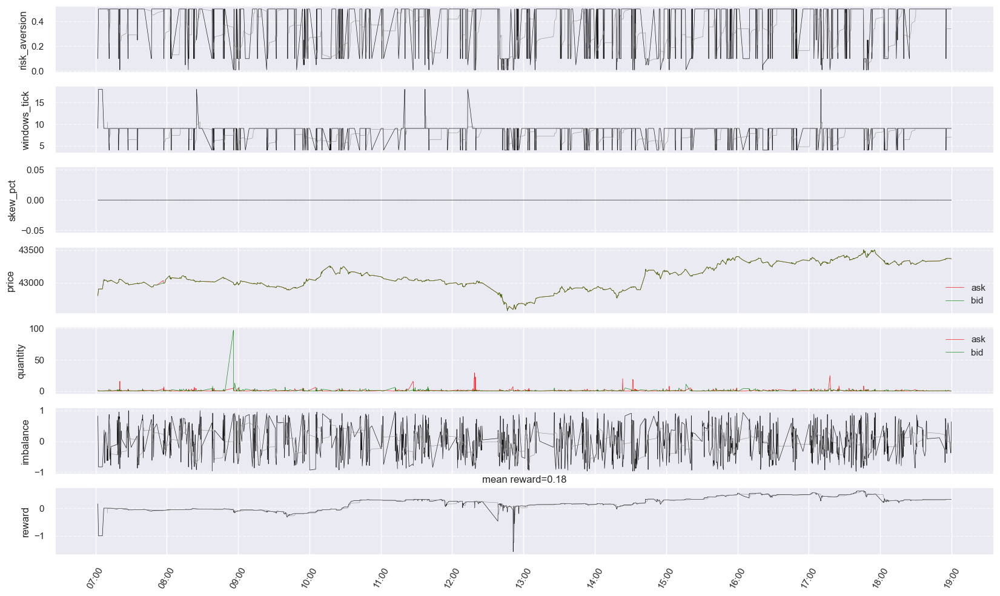

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-10.557829343287946  close_pnl:-10.456397403000011  number_trades:9323  sharpe:-0.12829678694460472   sortino:-0.13740299852279098  max_dd:11.09756817500001  pnl_map:-2112.4161703520476   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-120.09506541008169  close_pnl:-120.10284741012607  number_trades:14351  sharpe:-0.48582219843233065   sortino:-0.44725681330674255  max_dd:120.10284741012607  pnl_map:-475320.74754237576   
ConstantSpread_constant_spread  -> open_pnl:-37.02444995100132  close_pnl:-37.02444995100132  number_trades:49323  sharpe:-0.11930893160737227   sortino:-0.13649374855729368  max_dd:37.0572119512513  pnl_map:-60393.17449200167   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:0.3778083763333996  close_pnl:0.3140303319999975  number_trades:4754  sharpe:0.021126714260579972   sortino:0.03832800522951175  max_dd:0.3606287250000026  pnl_map:109.17004209925997   


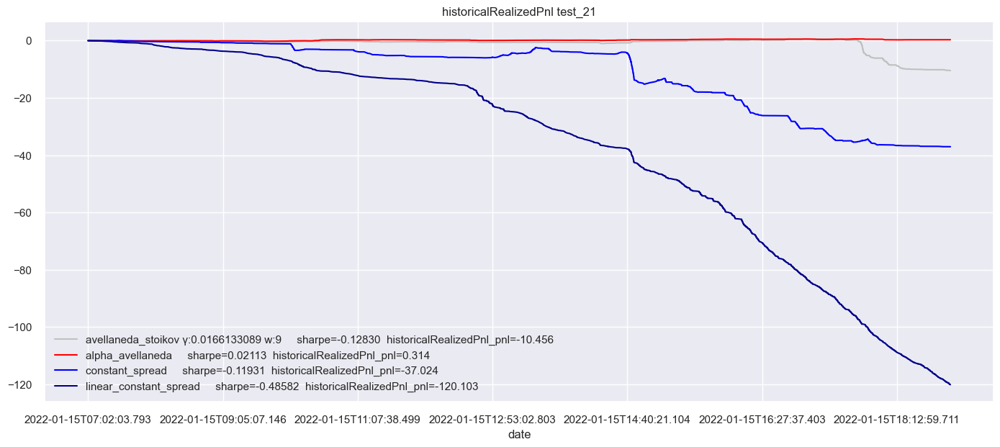

 76%|█████████████████████████████████████████████████████████▋                  | 22/29 [6:11:26<2:21:28, 1212.66s/it]

ratio winning as = 10/22
ratio winning constant = 15/22
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 13771 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 54884 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 7033 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 5254 trades
plotting trade_results from 2022-01-16 07:02:01.970000 to 2022-01-16 18:59:56.0190

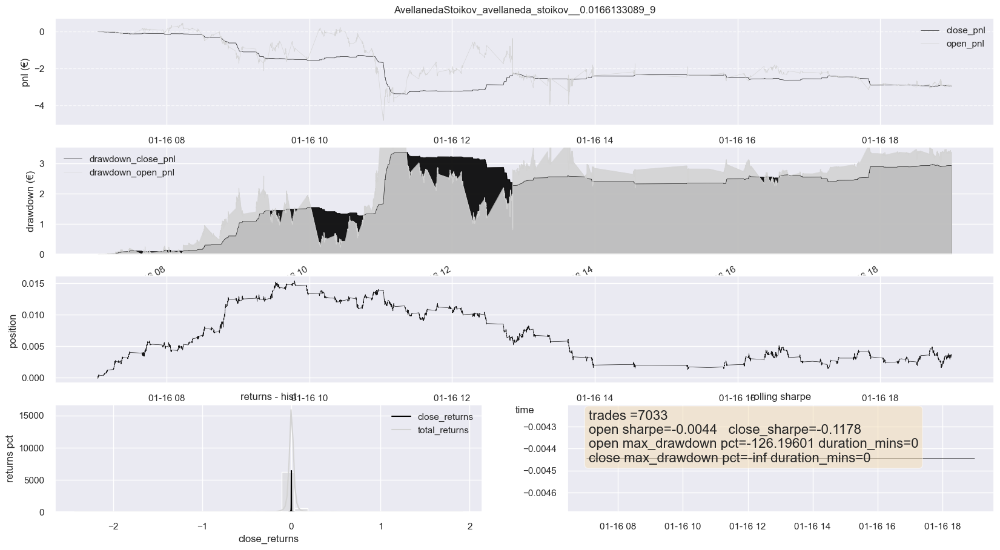

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-16 07:02:27.971000 to 2022-01-16 18:59:56.019000


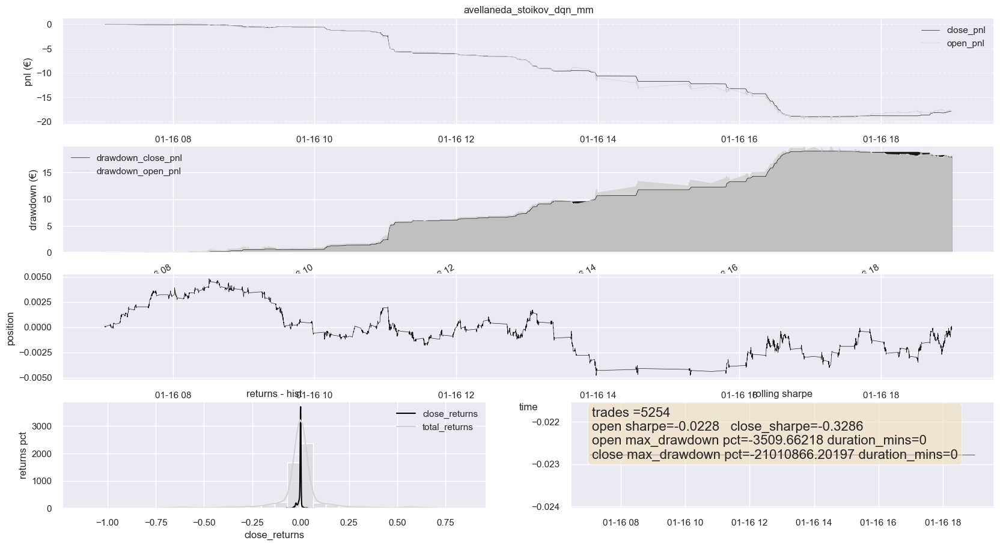

plotting params from 2022-01-16 07:02:27.971000 to 2022-01-16 18:59:56.019000


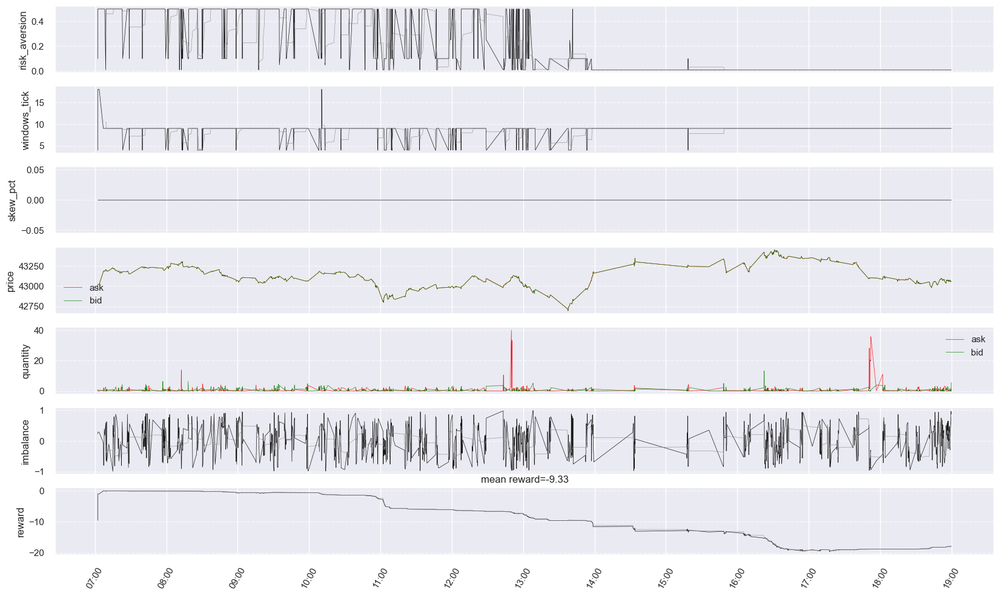

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-2.887530131499928  close_pnl:-2.9373158809999733  number_trades:6382  sharpe:-0.11780180450191906   sortino:-0.15264595164865116  max_dd:3.375797801999997  pnl_map:-382.2833357147108   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-83.18656850795196  close_pnl:-83.19427017059067  number_trades:13504  sharpe:-0.4968636293558019   sortino:-0.4510254271242053  max_dd:83.19595302556667  pnl_map:-320266.4591819206   
ConstantSpread_constant_spread  -> open_pnl:-36.02364234428284  close_pnl:-36.20163893768943  number_trades:44269  sharpe:-0.11410739170842625   sortino:-0.1490247200601425  max_dd:49.52866894968865  pnl_map:-63147.85931457068   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-17.905150876885127  close_pnl:-17.96795830099999  number_trades:4706  sharpe:-0.3286149623256941   sortino:-0.33370134015417297  max_dd:19.04476331500008  pnl_map:-10881.228697837543   


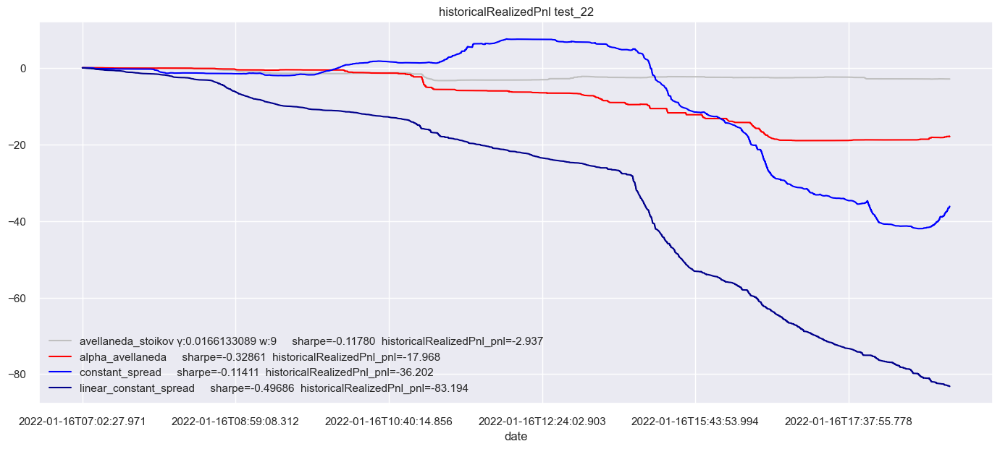

 79%|████████████████████████████████████████████████████████████▎               | 23/29 [6:32:06<2:02:04, 1220.83s/it]

ratio winning as = 10/23
ratio winning constant = 15/23
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 19160 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 65377 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11791 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 4599 trades
plotting trade_results from 2022-01-17 07:02:06.098000 to 2022-01-17 18:59:24.936

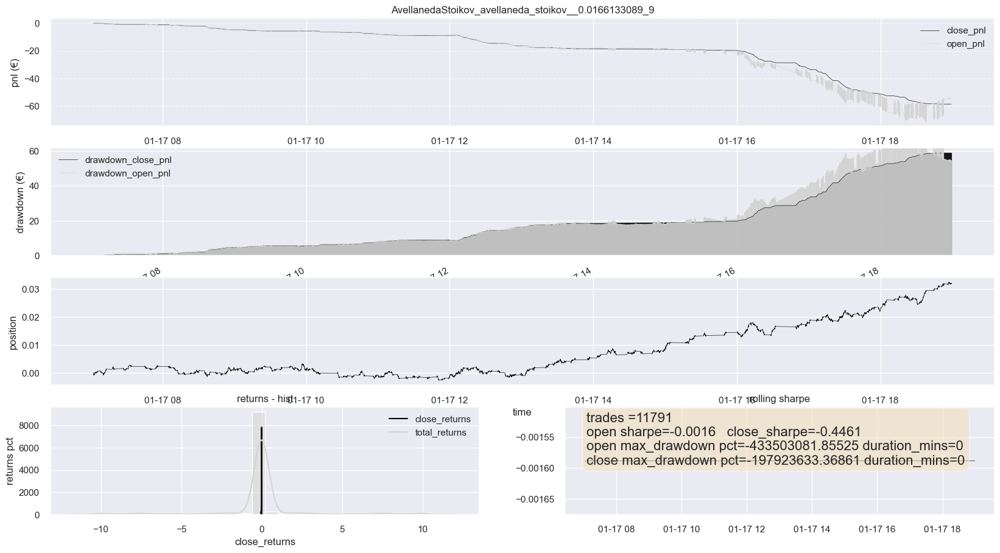

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-17 07:02:07.098000 to 2022-01-17 18:59:26.078000


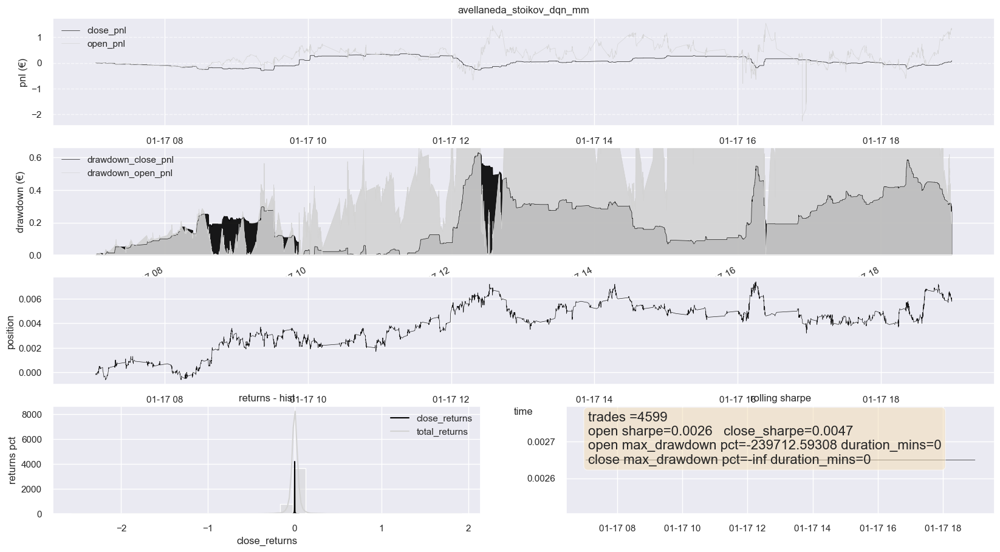

plotting params from 2022-01-17 07:02:07.098000 to 2022-01-17 18:59:26.078000


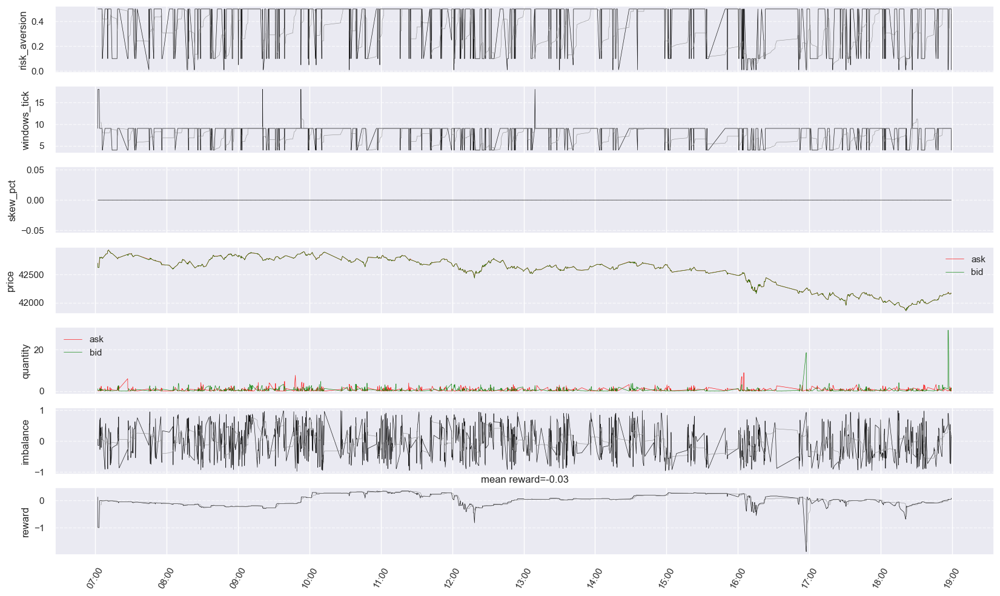

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-54.35987304468233  close_pnl:-58.69021615100816  number_trades:10986  sharpe:-0.4460801524959954   sortino:-0.42322825714899637  max_dd:58.70956114300813  pnl_map:-6314.545042356096   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-177.61213008478603  close_pnl:-177.61335668539562  number_trades:18591  sharpe:-0.43473998837806066   sortino:-0.40996811785342485  max_dd:177.6134146853956  pnl_map:-683351.2840398694   
ConstantSpread_constant_spread  -> open_pnl:-55.9010927930643  close_pnl:-56.035933945997726  number_trades:51944  sharpe:-0.22291364079931852   sortino:-0.2439732410896602  max_dd:56.21746794699756  pnl_map:-99285.66462730075   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:1.3528116985000171  close_pnl:0.08557513599999131  number_trades:4180  sharpe:0.004674681928735449   sortino:0.00836820170585426  max_dd:0.6294798000000024  pnl_map:343.4017387278366   


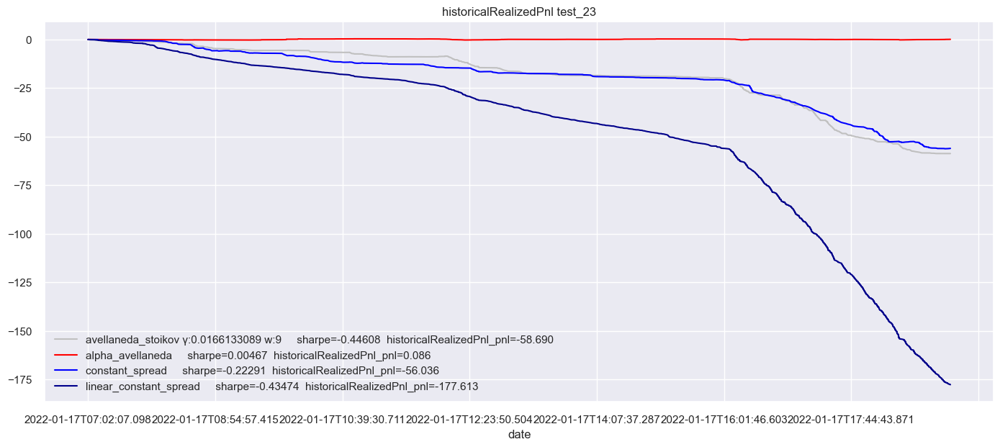

 83%|██████████████████████████████████████████████████████████████▉             | 24/29 [6:52:59<1:42:33, 1230.65s/it]

ratio winning as = 11/24
ratio winning constant = 16/24
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 21066 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 61365 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 12278 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 4395 trades
plotting trade_results from 2022-01-18 07:02:06.144000 to 2022-01-18 18:59:58.102

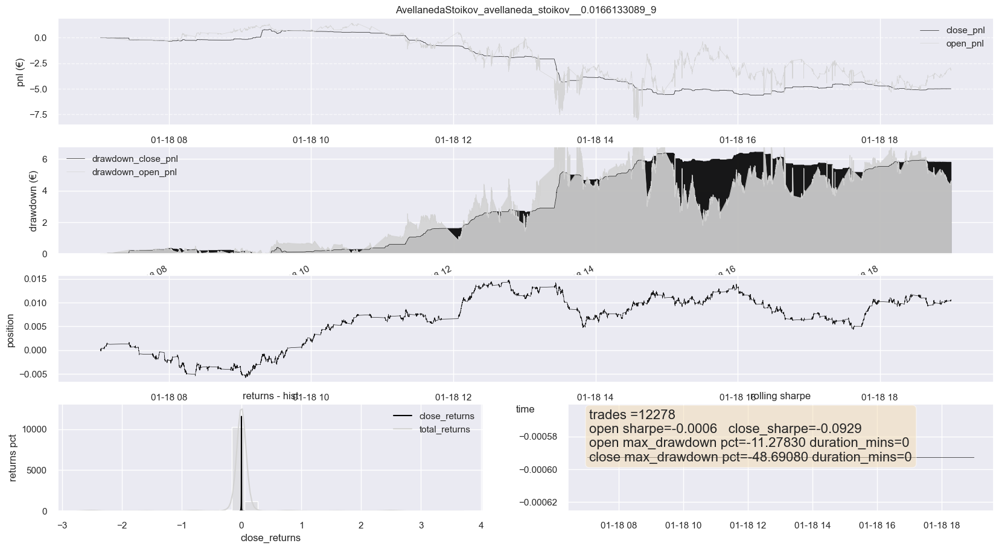

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-18 07:02:16.144000 to 2022-01-18 18:59:54.102000


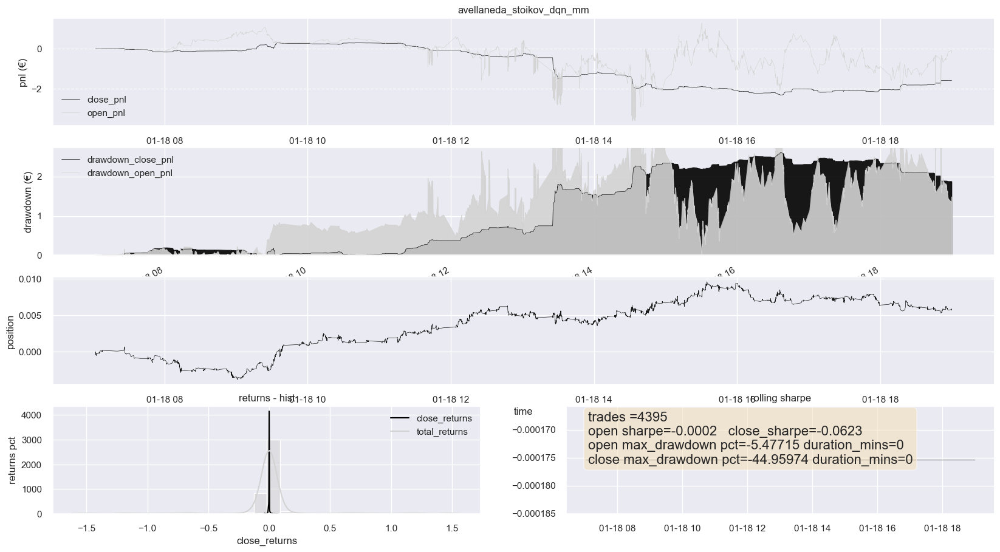

plotting params from 2022-01-18 07:02:16.144000 to 2022-01-18 18:59:54.102000


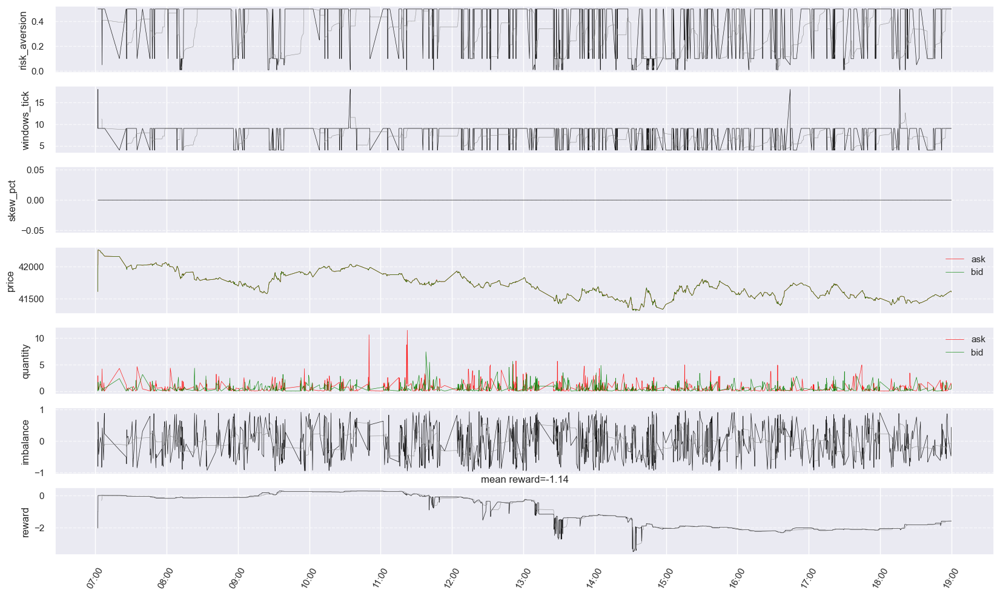

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-3.1125617473997416  close_pnl:-4.994820092999976  number_trades:11500  sharpe:-0.09286393684832715   sortino:-0.14070652737106917  max_dd:6.446519797999995  pnl_map:-409.4646635020475   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-145.39040991084156  close_pnl:-145.41281570705675  number_trades:20365  sharpe:-0.5103309182656767   sortino:-0.4677402472591314  max_dd:145.41305090705674  pnl_map:-570810.7980884075   
ConstantSpread_constant_spread  -> open_pnl:-79.96084404207309  close_pnl:-80.0762979310047  number_trades:49593  sharpe:-0.18313764891812498   sortino:-0.21078235088251335  max_dd:80.31590693100459  pnl_map:-136521.3901062227   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-0.2302209142499003  close_pnl:-1.585770650000011  number_trades:4073  sharpe:-0.06225828251593165   sortino:-0.09229559890301761  max_dd:2.6054245890000054  pnl_map:-48.13633357572165   


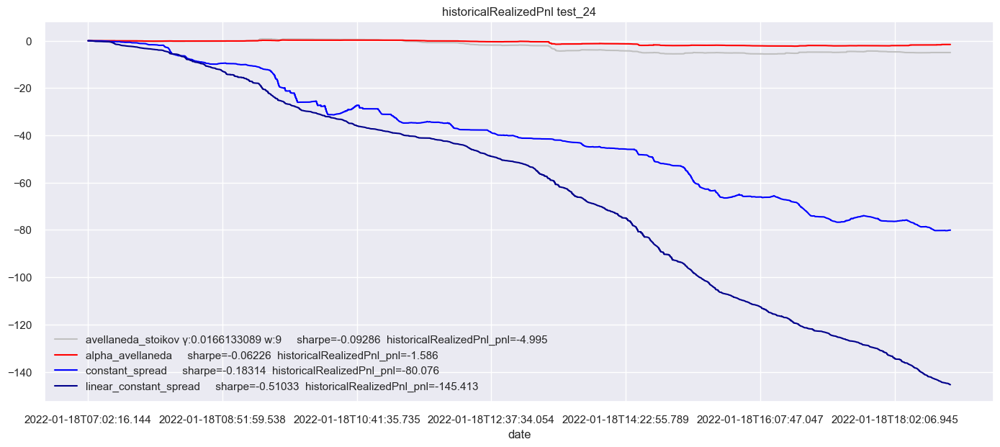

 86%|█████████████████████████████████████████████████████████████████▌          | 25/29 [7:13:06<1:21:34, 1223.57s/it]

ratio winning as = 12/25
ratio winning constant = 17/25
Parameter tuning benchmark on day 25 with data from 2022-01-18 06:00:00 to 2022-01-18 20:00:00
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 22040 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 64427 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 14391 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm wit

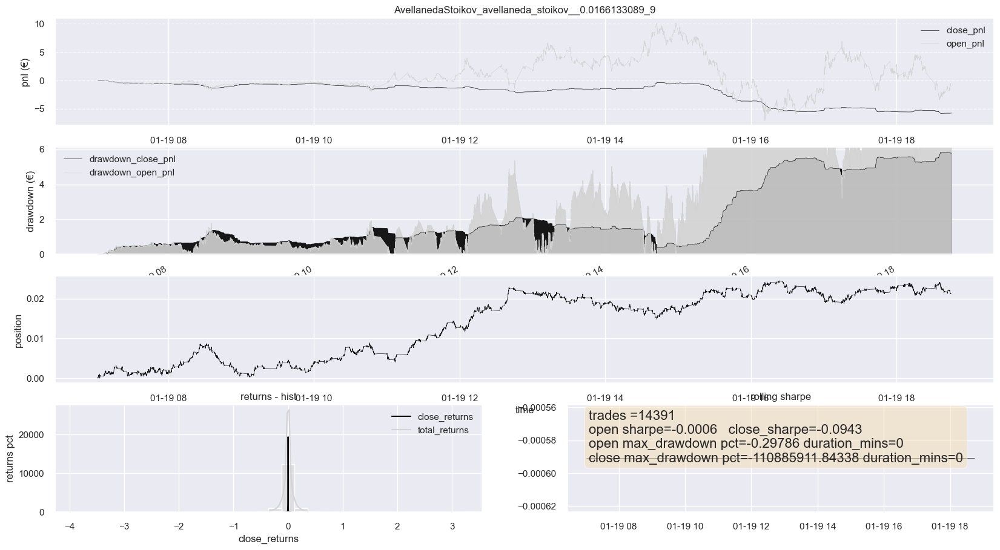

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-19 07:02:09.154000 to 2022-01-19 18:45:12.090000


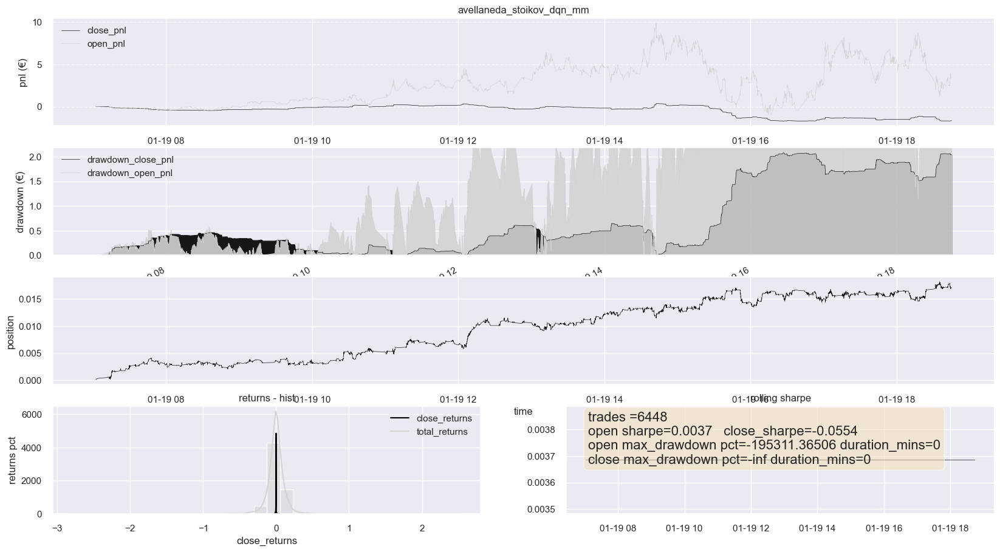

plotting params from 2022-01-19 07:02:09.154000 to 2022-01-19 18:45:12.090000


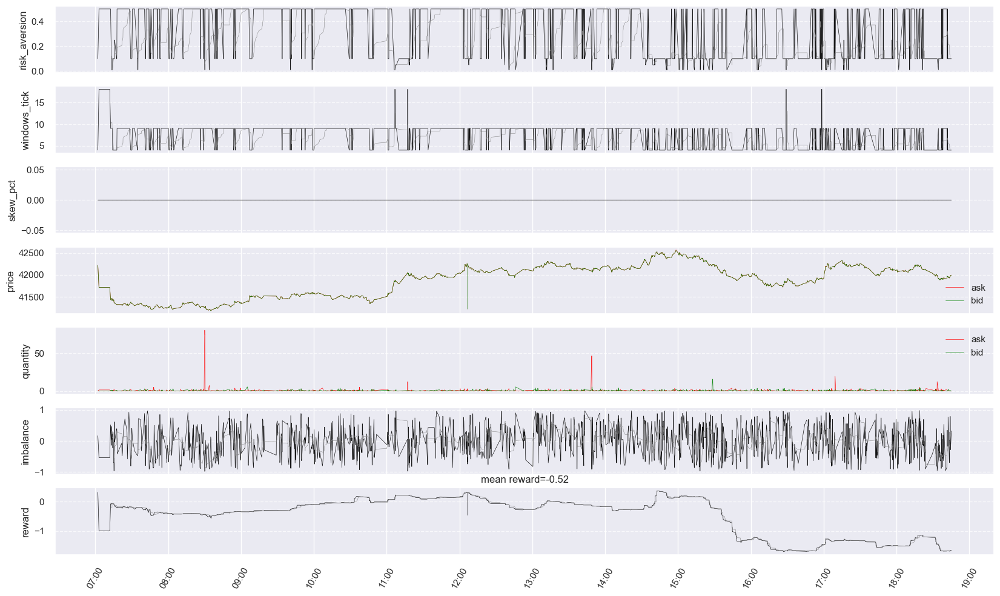

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-1.081350860468909  close_pnl:-5.779464265999997  number_trades:13408  sharpe:-0.09434950274285002   sortino:-0.14370731280346832  max_dd:5.833913081000001  pnl_map:-78.33856153381684   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-250.29152367758184  close_pnl:-250.29090919591258  number_trades:21228  sharpe:-0.40142907140203105   sortino:-0.38592665693429545  max_dd:250.29168927259852  pnl_map:-996854.3706025587   
ConstantSpread_constant_spread  -> open_pnl:-45.76897395300091  close_pnl:-45.76897395300091  number_trades:51345  sharpe:-0.07888654366820433   sortino:-0.10074486504282693  max_dd:45.76933595300088  pnl_map:-68929.54501055392   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:3.4184673153332583  close_pnl:-1.6677778570000108  number_trades:5887  sharpe:-0.05541757748615435   sortino:-0.08942128258526312  max_dd:2.080996550000002  pnl_map:310.4296873246639   


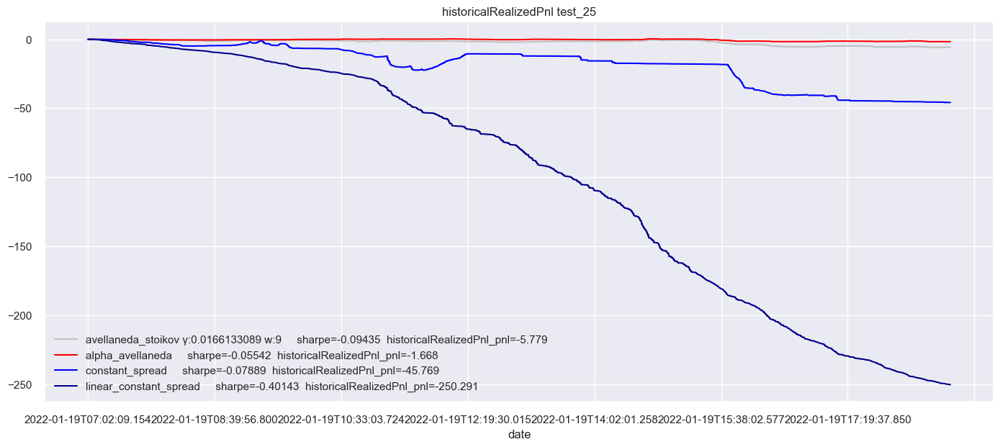

 90%|████████████████████████████████████████████████████████████████████▏       | 26/29 [7:34:07<1:01:44, 1234.72s/it]

ratio winning as = 13/26
ratio winning constant = 18/26
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 15863 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 62904 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 12623 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 10534 trades
plotting trade_results from 2022-01-20 07:02:00.241000 to 2022-01-20 18:51:18.26

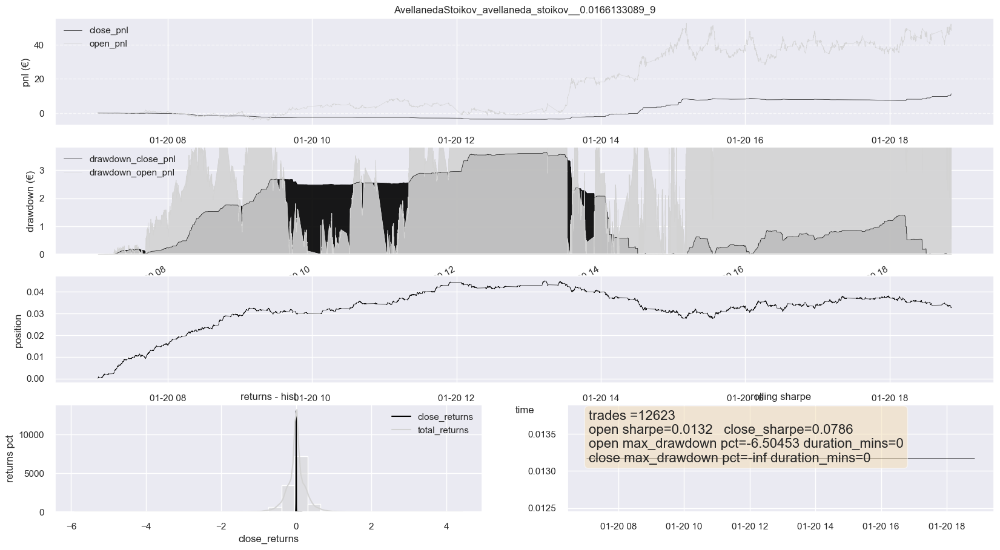

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-20 07:02:13.242000 to 2022-01-20 18:51:15.262000


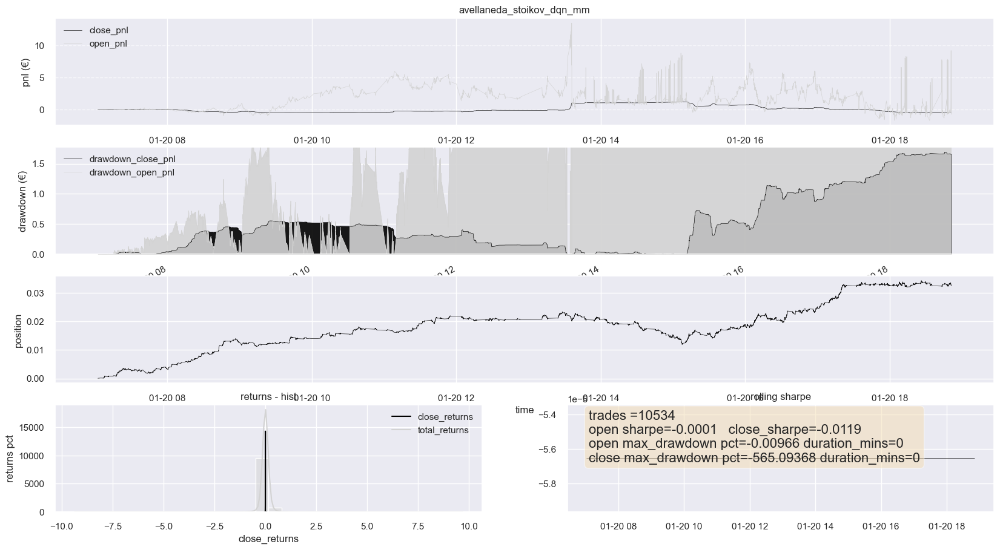

plotting params from 2022-01-20 07:02:13.242000 to 2022-01-20 18:51:15.262000


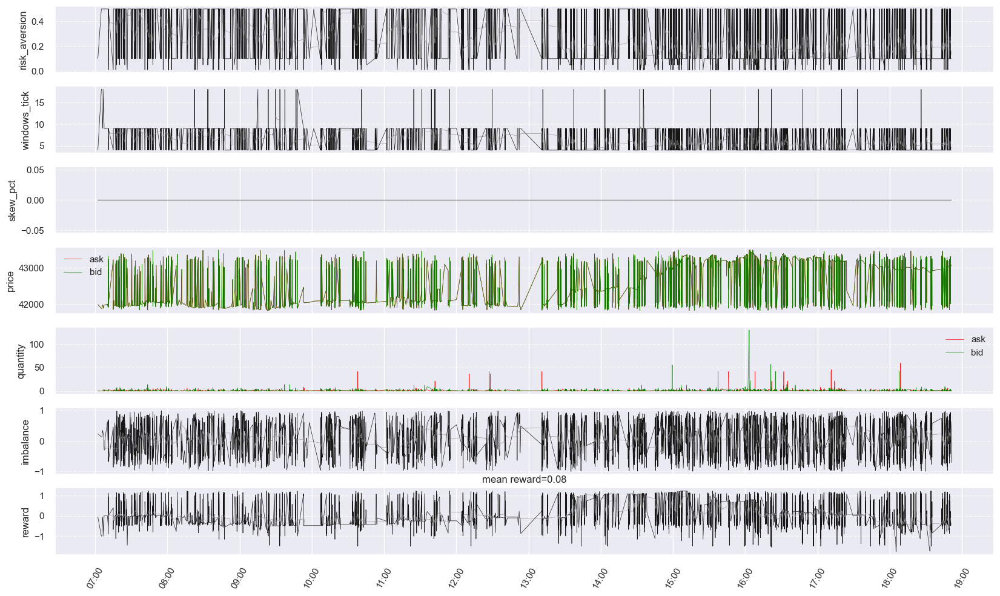

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:48.369286653526075  close_pnl:11.229989657999965  number_trades:11540  sharpe:0.07858745568681129   sortino:0.45039931542909223  max_dd:3.6430370289999936  pnl_map:1540.2358399967814   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-266.73705589350703  close_pnl:-266.60755855911697  number_trades:15345  sharpe:-0.38631404425322313   sortino:-0.37247943350522844  max_dd:266.60755855911697  pnl_map:-1031389.2775853421   
ConstantSpread_constant_spread  -> open_pnl:-100.57744494925852  close_pnl:-100.57744494925852  number_trades:49737  sharpe:-0.10345560788584038   sortino:-0.12345902046981214  max_dd:100.58014194925852  pnl_map:-146388.90656078997   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-0.4241878750000916  close_pnl:-0.42386087500002495  number_trades:9132  sharpe:-0.011899593732962762   sortino:-0.024862209711104664  max_dd:1.6916444479999848  pnl_map:-21.207632151548918   


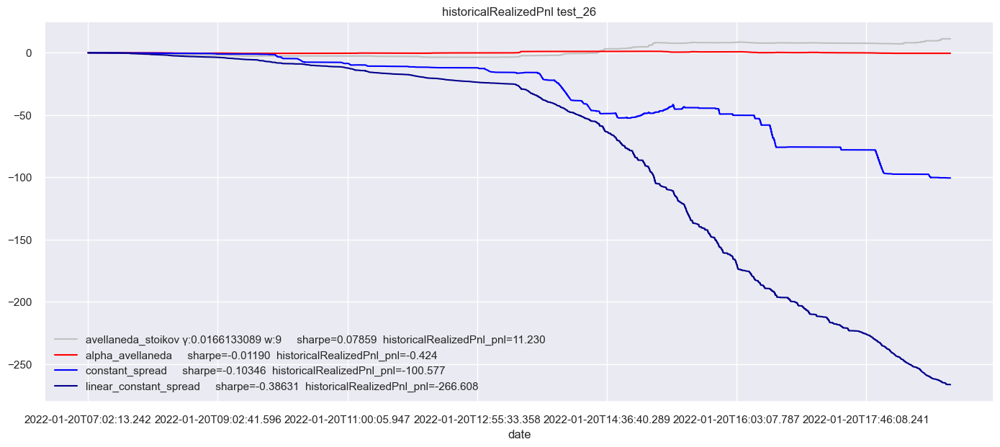

 93%|████████████████████████████████████████████████████████████████████████▌     | 27/29 [7:55:02<41:21, 1240.73s/it]

ratio winning as = 13/27
ratio winning constant = 19/27
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 29461 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 67733 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 15648 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 3564 trades
plotting trade_results from 2022-01-21 07:02:03.179000 to 2022-01-21 18:37:13.997

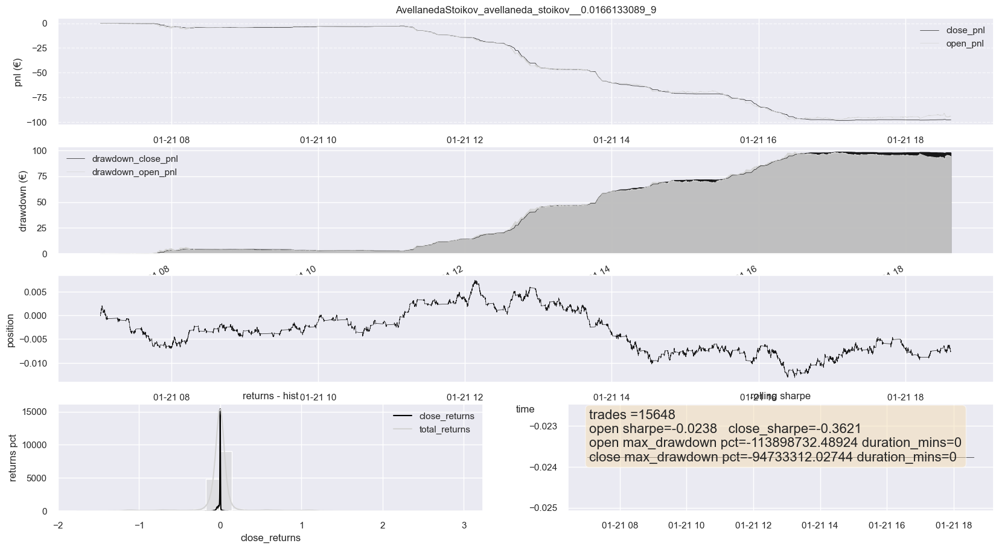

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-21 07:03:58.184000 to 2022-01-21 18:37:18.998000


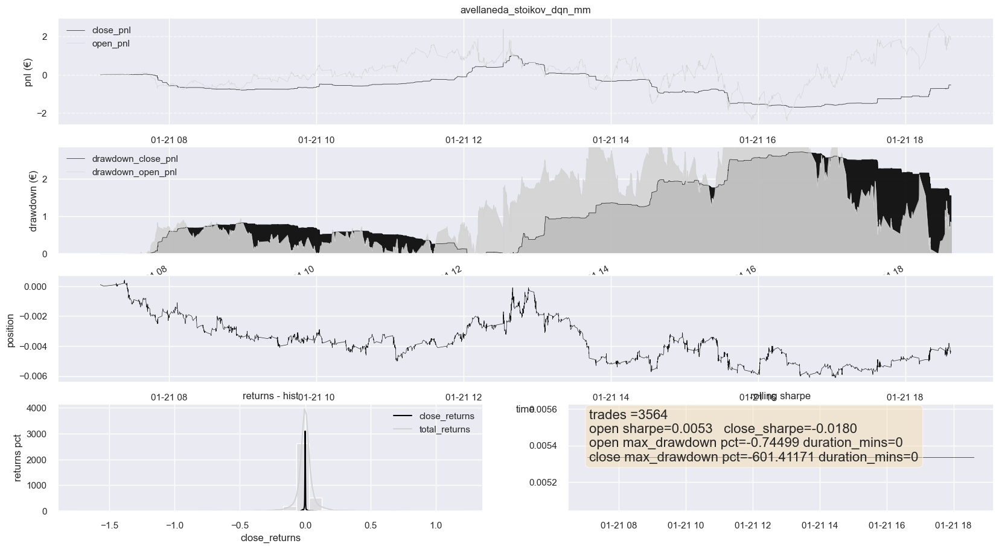

plotting params from 2022-01-21 07:03:58.184000 to 2022-01-21 18:37:18.998000


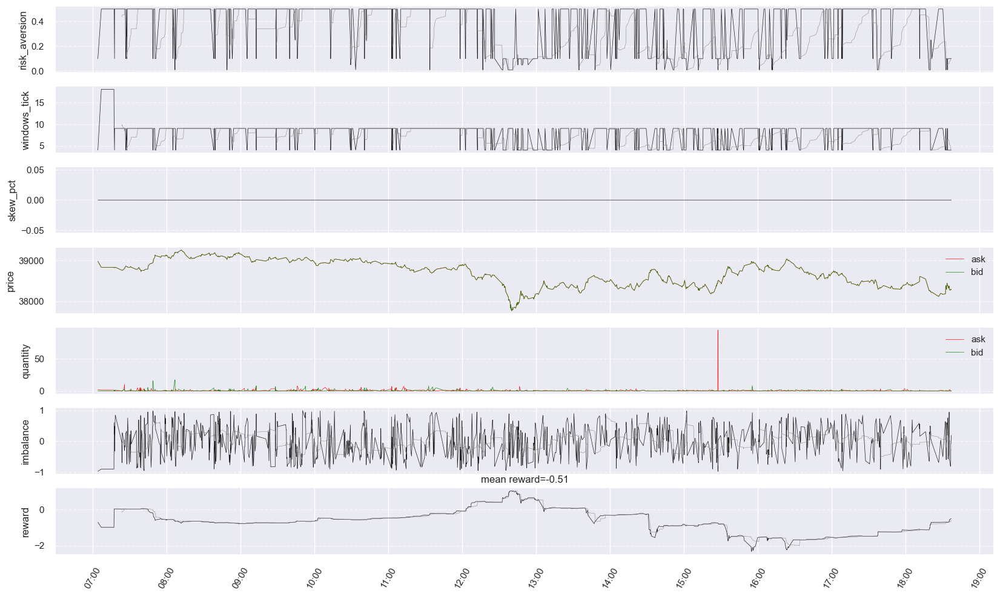

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-94.01522313114373  close_pnl:-97.75830492800029  number_trades:14658  sharpe:-0.36214715693692123   sortino:-0.3602987296989162  max_dd:98.46214448000023  pnl_map:-18144.450246684282   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-358.9015652678842  close_pnl:-358.8633601566021  number_trades:27937  sharpe:-0.43799738230871826   sortino:-0.4244569858949761  max_dd:358.8633601566021  pnl_map:-1442811.2343253898   
ConstantSpread_constant_spread  -> open_pnl:-380.19637022510284  close_pnl:-380.23501894400124  number_trades:53912  sharpe:-0.30497110894052526   sortino:-0.32233140709166197  max_dd:380.23501894400124  pnl_map:-678800.0396564037   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:1.8592888829001184  close_pnl:-0.5334212379999989  number_trades:3298  sharpe:-0.018010538633579903   sortino:-0.028703683170265733  max_dd:2.7144330889999964  pnl_map:535.1767966673954   


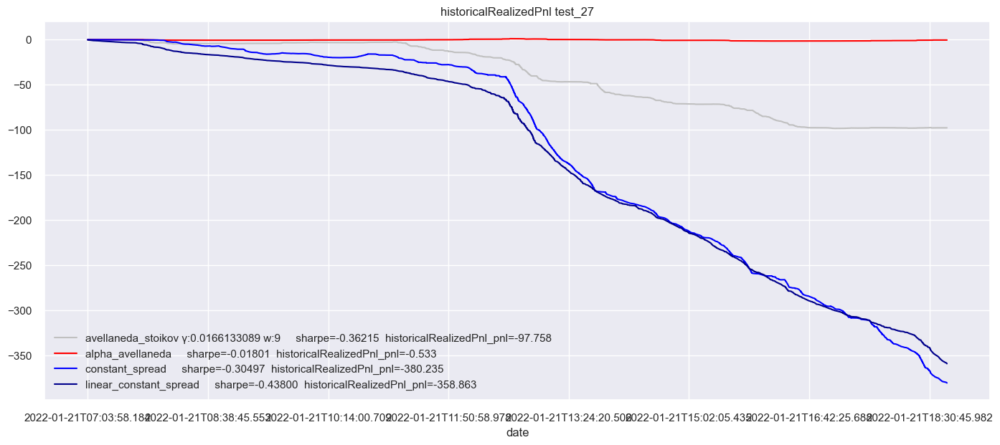

 97%|███████████████████████████████████████████████████████████████████████████▎  | 28/29 [8:16:34<20:56, 1256.14s/it]

ratio winning as = 14/28
ratio winning constant = 20/28
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
LinearConstantSpread_linear_constant_spread_0 finished with code 0
LinearConstantSpread_linear_constant_spread_0 with 30934 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
ConstantSpread_constant_spread_0 finished with code 0
ConstantSpread_constant_spread_0 with 47824 trades
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 finished with code 0
AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9_0 with 11848 trades
testing on algorithm AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm
pwd=E:\javif\Coding\Python\market_making_fw\python_lambda\notebooks
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm finished with code 0
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm with 3126 trades
plotting trade_results from 2022-01-22 07:02:01.866000 to 2022-01-22 18:55:44.555

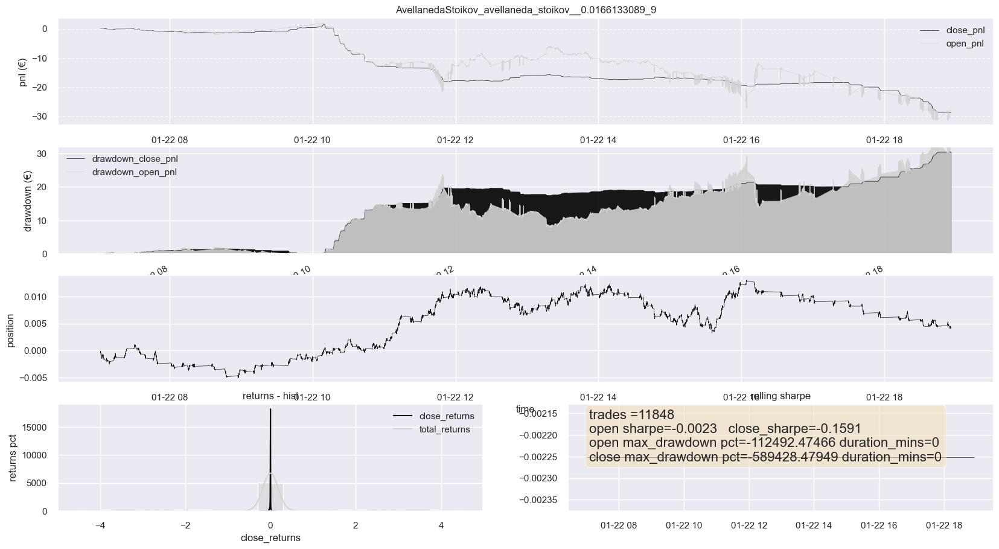

<Figure size 800x550 with 0 Axes>

plotting trade_results from 2022-01-22 07:02:26.865000 to 2022-01-22 18:56:03.558000


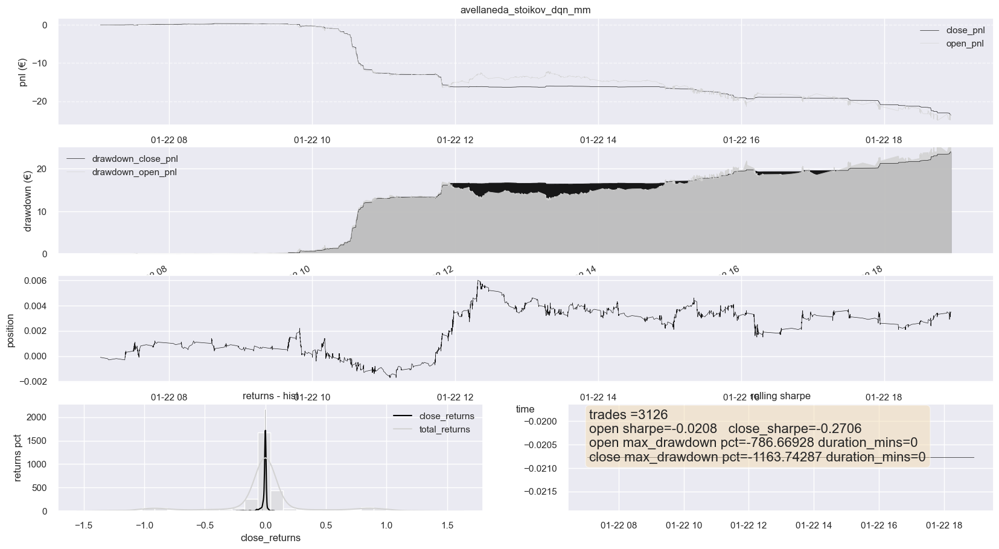

plotting params from 2022-01-22 07:02:26.865000 to 2022-01-22 18:56:03.558000


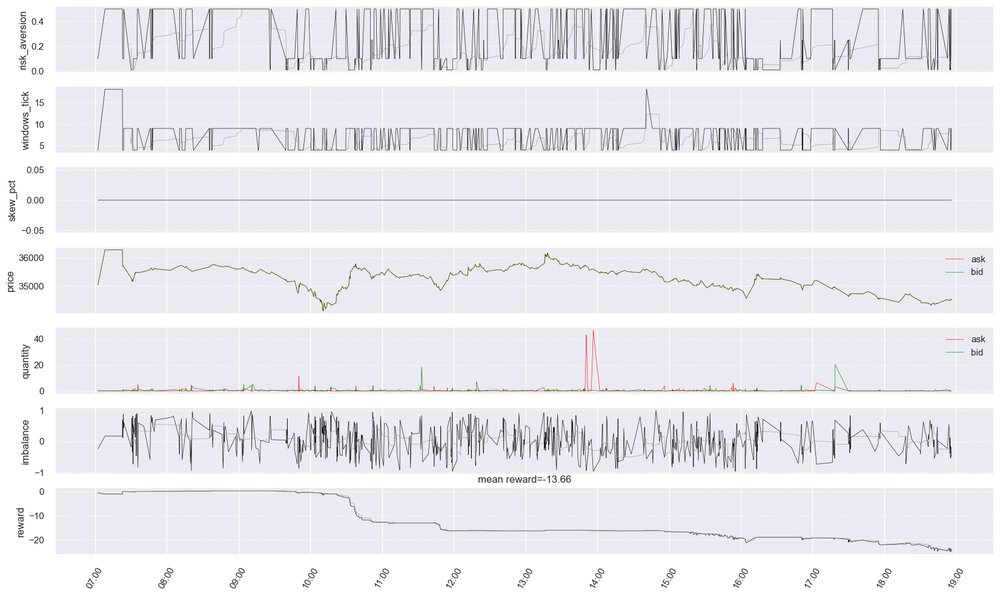

AvellanedaStoikov_avellaneda_stoikov__0.0166133089_9  -> open_pnl:-28.150870645417733  close_pnl:-28.807961874000128  number_trades:11326  sharpe:-0.15909612860896583   sortino:-0.1720002025356542  max_dd:30.467852948000143  pnl_map:-4048.5674815666102   
LinearConstantSpread_linear_constant_spread  -> open_pnl:-524.5466504957243  close_pnl:-524.3316814363072  number_trades:30085  sharpe:-0.49766973591678837   sortino:-0.4564641041167605  max_dd:524.3316814363072  pnl_map:-2197999.390456286   
ConstantSpread_constant_spread  -> open_pnl:-747.8840538318879  close_pnl:-747.2361849749999  number_trades:42011  sharpe:-0.42161140721274026   sortino:-0.4100106116813461  max_dd:747.2943159749999  pnl_map:-1353301.3356561165   
AlphaAvellanedaStoikov_avellaneda_stoikov_dqn_mm  -> open_pnl:-23.831862466970797  close_pnl:-23.598598709999823  number_trades:3011  sharpe:-0.270683642480038   sortino:-0.2687638090004109  max_dd:23.945777709999824  pnl_map:-9650.802144175808   


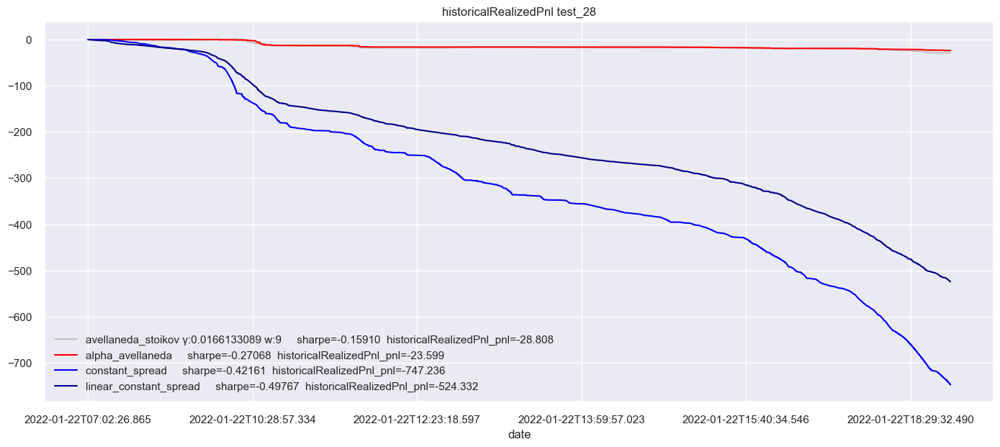

100%|██████████████████████████████████████████████████████████████████████████████| 29/29 [8:37:22<00:00, 1070.42s/it]

ratio winning as = 14/29
ratio winning constant = 21/29


In [34]:
from backtest.train_launcher import clean_gpu_memory
parameter_tuning_every_n_days=5#is not working!

start_date_train = None
end_date_train = None
day_counter=0
for day in tqdm.tqdm(days_test):
    
#     clean_gpu_memory()
    start_date = day+ datetime.timedelta(hours=int(FIRST_HOUR-1))
    end_date=day+ datetime.timedelta(hours=int(LAST_HOUR+1))
    if start_date_train is None or day_counter%parameter_tuning_every_n_days!=0:
        benchmark_test_temp,linear_constant_test_temp,constant_test_temp,dqn_test_temp,dqn_rnn_test_temp,best_parameter_dict=launch_test(start_date,end_date) 
        best_parameter_dict=best_avellaneda_param_dict#initially 
    else:
        print(f'Parameter tuning benchmark on day {day_counter} with data from {start_date_train} to {end_date_train}')
        benchmark_test_temp,linear_constant_test_temp,constant_test_temp,dqn_test_temp,dqn_rnn_test_temp,best_parameter_dict=launch_test(start_date,end_date,is_parameter_tuning_benchmark=PARAMETER_TUNING_BENCHMARK,start_date_train=start_date_train,end_date_train=end_date_train,best_parameter_tuning_dict=best_parameter_dict)
        
        
#     plot_results_algorithms(benchmark_test_temp,linear_constant_test_temp,constant_test_temp,dqn_test_temp,save_file=False,column_to_compare='historicalTotalPnl')
    something_is_wrong= len(benchmark_test_temp)==0 or linear_constant_test_temp is None or constant_test_temp is None or dqn_test_temp is None
    if something_is_wrong:
        print(f"something is wrong day {day}-> skip it")
        continue
        
    plot_results_algorithms(benchmark_test_temp,linear_constant_test_temp,constant_test_temp,dqn_test_temp,dqn_rnn_test_temp,save_file=False,column_to_compare='historicalRealizedPnl')
    start_date_train=start_date
    end_date_train=end_date
    day_counter+=1
    
final_results['date']=days_test
final_results.set_index('date',inplace=True)    

In [35]:
as_sharpe_columns=[]
as_close_pl_columns=[]
as_open_pl_columns=[]
for column in list(final_results.columns):
    if column.startswith('avellaneda_stoikov') and column.endswith('sharpe'):
        as_sharpe_columns.append(column)
    if column.startswith('avellaneda_stoikov') and column.endswith('open_pnl'):
        as_open_pl_columns.append(column)
    if column.startswith('avellaneda_stoikov') and column.endswith('close_pnl'):
        as_close_pl_columns.append(column)
        
final_results['avellaneda_stoikov_sharpe']=final_results[as_sharpe_columns].max(axis=1)     
final_results['avellaneda_stoikov_open_pnl']=final_results[as_open_pl_columns].max(axis=1)  
final_results['avellaneda_stoikov_close_pnl']=final_results[as_close_pl_columns].max(axis=1)  

In [36]:
final_results['is_better_sharpe']=final_results['alpha_avellaneda_sharpe']>final_results['avellaneda_stoikov_sharpe']
final_results['is_better_open_pnl']=final_results['alpha_avellaneda_open_pnl']>final_results['avellaneda_stoikov_open_pnl']
final_results['is_better_close_pnl']=final_results['alpha_avellaneda_close_pnl']>final_results['avellaneda_stoikov_close_pnl']
final_results.head(5)

,avellaneda_stoikov_0.0166133089_9_open_pnl,avellaneda_stoikov_0.0166133089_9_close_pnl,avellaneda_stoikov_0.0166133089_9_number_trades,avellaneda_stoikov_0.0166133089_9_sharpe,avellaneda_stoikov_0.0166133089_9_sortino,avellaneda_stoikov_0.0166133089_9_max_drawdown,avellaneda_stoikov_0.0166133089_9_pnl_map,linear_constant_spread_open_pnl,linear_constant_spread_close_pnl,linear_constant_spread_number_trades,linear_constant_spread_sharpe,linear_constant_spread_sortino,linear_constant_spread_max_drawdown,linear_constant_spread_pnl_map,constant_spread_open_pnl,constant_spread_close_pnl,constant_spread_number_trades,constant_spread_sharpe,constant_spread_sortino,constant_spread_max_drawdown,constant_spread_pnl_map,alpha_avellaneda_open_pnl,alpha_avellaneda_close_pnl,alpha_avellaneda_number_trades,alpha_avellaneda_sharpe,alpha_avellaneda_sortino,alpha_avellaneda_max_drawdown,alpha_avellaneda_pnl_map,instrument,avellaneda_stoikov_sharpe,avellaneda_stoikov_open_pnl,avellaneda_stoikov_close_pnl,is_better_sharpe,is_better_open_pnl,is_better_close_pnl
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-12-24,-0.134798,-0.256843,394,-0.174836,-0.191898,0.335207,-219.667,-6.05766,-6.11061,1906,-0.516245,-0.461301,6.15187,-25498.6,-1.27911,-1.40437,4986,-0.046465,-0.0770673,4.74505,-2050.5,0.0936692,-0.174741,591,-0.0931972,-0.141217,0.318341,49.0179,btcusdt_binance,-0.174836,-0.134798,-0.256843,True,True,True
2021-12-26,-9.47274,-8.92009,5276,-0.276817,-0.309219,9.14267,-5033.04,-15.6028,-15.5957,3855,-0.511873,-0.469574,15.5957,-63898.8,-0.814973,-0.814973,16719,-0.0120156,-0.021024,2.76895,-1419.31,-4.26525,-6.47105,8382,-0.161088,-0.20004,6.97897,-681.897,btcusdt_binance,-0.276817,-9.472738,-8.920090,True,True,True
2021-12-27,-3.92248,-3.95274,13788,-0.0436554,-0.0479365,3.97764,-603.339,-191.358,-191.324,15150,-0.464076,-0.433051,191.324,-797849,-72.3598,-72.394,57573,-0.15219,-0.171329,74.1007,-128949,-2.34901,-2.46198,22386,-0.0650507,-0.107569,2.46218,-97.8397,btcusdt_binance,-0.043655,-3.922477,-3.952739,False,True,True
2021-12-28,-118.766,-118.246,10452,-0.250005,-0.252826,118.808,-36885.2,-294.166,-294.303,19235,-0.360748,-0.349987,294.303,-1.17026e+06,-100.84,-100.819,53328,-0.17009,-0.19296,100.819,-169458,-4.95712,-5.63086,14091,-0.107709,-0.138419,5.82207,-560.427,btcusdt_binance,-0.250005,-118.766242,-118.246319,True,True,True
2021-12-29,-0.35205,-0.431574,9652,-0.0059052,-0.0128589,3.20361,-42.3825,-288.87,-288.932,17584,-0.447342,-0.420592,288.932,-1.21098e+06,-174.357,-174.36,53876,-0.195637,-0.213976,174.36,-293583,-1.74683,-1.8133,13215,-0.0501033,-0.0711229,1.9209,-105.475,btcusdt_binance,-0.005905,-0.352050,-0.431574,False,False,False


In [37]:
final_results[['is_better_sharpe','is_better_open_pnl','is_better_close_pnl']].describe()

,is_better_sharpe,is_better_open_pnl,is_better_close_pnl
count,29,29,29
unique,2,2,2
top,False,True,True
freq,15,19,17


In [38]:
final_results.to_csv('final_results_phd_thesis.csv')

In [39]:
final_results[['is_better_sharpe','is_better_open_pnl','is_better_close_pnl']].describe().to_csv('statistical_significance_test_results_thesis.csv')
files.append('statistical_significance_test_results.csv')

In [40]:
final_results.to_csv('statistical_significance_test_thesis.csv')
files.append('statistical_significance_test_thesis.csv')

In [41]:
print('win %d times of total %d '%(wining_counter,counter_plt_results))    

win 14 times of total 29 


In [42]:
files=list(set(files))
files

['dqn_vs_as_output_15.csv',
 'dqn_vs_as_output_27.csv',
 'dqn_vs_as_output_25.csv',
 'dqn_vs_as_output_10.csv',
 'statistical_significance_test_thesis.csv',
 'dqn_vs_as_output_8.csv',
 'dqn_vs_as_output_21.csv',
 'dqn_vs_as_output_20.csv',
 'dqn_vs_as_output_0.csv',
 'dqn_vs_as_output_22.csv',
 'dqn_vs_as_output_26.csv',
 'dqn_vs_as_output_17.csv',
 'dqn_vs_as_output_28.csv',
 'dqn_vs_as_output_18.csv',
 'dqn_vs_as_output_16.csv',
 'dqn_vs_as_output_4.csv',
 'dqn_vs_as_output_6.csv',
 'dqn_vs_as_output_24.csv',
 'dqn_vs_as_output_1.csv',
 'dqn_vs_as_output_7.csv',
 'dqn_vs_as_output_3.csv',
 'dqn_vs_as_output_12.csv',
 'dqn_vs_as_output_14.csv',
 'dqn_vs_as_output_5.csv',
 'dqn_vs_as_output_11.csv',
 'dqn_vs_as_output_2.csv',
 'statistical_significance_test_results.csv',
 'dqn_vs_as_output_23.csv',
 'dqn_vs_as_output_13.csv',
 'dqn_vs_as_output_19.csv',
 'dqn_vs_as_output_9.csv']

In [43]:
wining_counter

14

In [44]:
result_str='LOSE'
if (wining_counter>counter_plt_results/2):
    result_str='WIN'
result_str

'LOSE'

In [45]:
files=['statistical_significance_test_results_thesis.csv','statistical_significance_test_thesis.csv','final_results_phd_thesis.csv']


In [46]:
elapsed_total_hours = (time.time()-start_notebook)/3600
elapsed_total_hours

8.67042117383745

In [47]:
save_notebook_session(session_name)
send_email(recipient='javifalces@gmail.com',subject='[%s]PhdScript_thesis finished %s -> win ratio %d/%d'%(datetime.datetime.today(),result_str,wining_counter,counter_plt_results),html=final_results.to_html(),body='',file_append=files)

notebook session file save as  CryptoMM


## Results  <a class="anchor" id="results"></a>

In [48]:
final_results=pd.read_csv('final_results_phd_thesis.csv').set_index('date')
final_results

,avellaneda_stoikov_0.0166133089_9_open_pnl,avellaneda_stoikov_0.0166133089_9_close_pnl,avellaneda_stoikov_0.0166133089_9_number_trades,avellaneda_stoikov_0.0166133089_9_sharpe,avellaneda_stoikov_0.0166133089_9_sortino,avellaneda_stoikov_0.0166133089_9_max_drawdown,avellaneda_stoikov_0.0166133089_9_pnl_map,linear_constant_spread_open_pnl,linear_constant_spread_close_pnl,linear_constant_spread_number_trades,linear_constant_spread_sharpe,linear_constant_spread_sortino,linear_constant_spread_max_drawdown,linear_constant_spread_pnl_map,constant_spread_open_pnl,constant_spread_close_pnl,constant_spread_number_trades,constant_spread_sharpe,constant_spread_sortino,constant_spread_max_drawdown,constant_spread_pnl_map,alpha_avellaneda_open_pnl,alpha_avellaneda_close_pnl,alpha_avellaneda_number_trades,alpha_avellaneda_sharpe,alpha_avellaneda_sortino,alpha_avellaneda_max_drawdown,alpha_avellaneda_pnl_map,instrument,avellaneda_stoikov_sharpe,avellaneda_stoikov_open_pnl,avellaneda_stoikov_close_pnl,is_better_sharpe,is_better_open_pnl,is_better_close_pnl
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-12-24,-0.134798,-0.256843,394.0,-0.174836,-0.191898,0.335207,-219.666870,-6.057662,-6.110607,1906.0,-0.516245,-0.461301,6.151874,-2.549858e+04,-1.279112,-1.404375,4986.0,-0.046465,-0.077067,4.745050,-2.050505e+03,0.093669,-0.174741,591.0,-0.093197,-0.141217,0.318341,49.017863,btcusdt_binance,-0.174836,-0.134798,-0.256843,True,True,True
2021-12-26,-9.472738,-8.920090,5276.0,-0.276817,-0.309219,9.142671,-5033.039663,-15.602827,-15.595669,3855.0,-0.511873,-0.469574,15.595669,-6.389879e+04,-0.814973,-0.814973,16719.0,-0.012016,-0.021024,2.768951,-1.419311e+03,-4.265252,-6.471047,8382.0,-0.161088,-0.200040,6.978973,-681.896894,btcusdt_binance,-0.276817,-9.472738,-8.920090,True,True,True
2021-12-27,-3.922477,-3.952739,13788.0,-0.043655,-0.047937,3.977639,-603.339202,-191.358152,-191.324338,15150.0,-0.464076,-0.433051,191.324338,-7.978490e+05,-72.359846,-72.394001,57573.0,-0.152190,-0.171329,74.100675,-1.289486e+05,-2.349012,-2.461978,22386.0,-0.065051,-0.107569,2.462183,-97.839701,btcusdt_binance,-0.043655,-3.922477,-3.952739,False,True,True
2021-12-28,-118.766242,-118.246319,10452.0,-0.250005,-0.252826,118.807629,-36885.171319,-294.166463,-294.303288,19235.0,-0.360748,-0.349987,294.303288,-1.170260e+06,-100.840252,-100.818954,53328.0,-0.170090,-0.192960,100.818954,-1.694581e+05,-4.957117,-5.630863,14091.0,-0.107709,-0.138419,5.822067,-560.426615,btcusdt_binance,-0.250005,-118.766242,-118.246319,True,True,True
2021-12-29,-0.352050,-0.431574,9652.0,-0.005905,-0.012859,3.203611,-42.382487,-288.869944,-288.932036,17584.0,-0.447342,-0.420592,288.932036,-1.210979e+06,-174.356960,-174.360132,53876.0,-0.195637,-0.213976,174.360133,-2.935832e+05,-1.746828,-1.813296,13215.0,-0.050103,-0.071123,1.920899,-105.474743,btcusdt_binance,-0.005905,-0.352050,-0.431574,False,False,False
2021-12-30,-0.389385,-0.360293,9860.0,-0.004930,-0.011657,4.207776,-48.988676,-139.986141,-139.971471,13549.0,-0.463796,-0.432757,139.972394,-5.849613e+05,-13.344263,-13.344263,54529.0,-0.062189,-0.095840,13.766204,-2.272192e+04,-2.781933,-2.725681,13009.0,-0.074623,-0.106274,2.870267,-248.626482,btcusdt_binance,-0.004930,-0.389385,-0.360293,False,False,False
2021-12-31,-1.762249,-1.909691,10358.0,-0.025227,-0.049265,4.494248,-309.640979,-282.888979,-283.210699,17699.0,-0.371140,-0.360942,283.210699,-1.197224e+06,-52.062010,-52.192149,53279.0,-0.077660,-0.090585,53.715469,-8.817335e+04,-2.513987,-2.978956,13477.0,-0.047127,-0.080565,3.442477,-181.625993,btcusdt_binance,-0.025227,-1.762249,-1.909691,False,False,False
2022-01-01,-1.965188,-1.986472,11154.0,-0.048887,-0.075444,1.992042,-315.336830,-107.198630,-107.316182,12804.0,-0.432513,-0.405331,107.319735,-4.084600e+05,-58.649095,-58.649095,46552.0,-0.139594,-0.160521,58.656006,-9.492489e+04,-2.266283,-2.420805,12990.0,-0.053793,-0.077050,2.426619,-163.584609,btcusdt_binance,-0.048887,-1.965188,-1.986472,False,False,False
2022-01-02,-0.8

In [49]:
final_results

,avellaneda_stoikov_0.0166133089_9_open_pnl,avellaneda_stoikov_0.0166133089_9_close_pnl,avellaneda_stoikov_0.0166133089_9_number_trades,avellaneda_stoikov_0.0166133089_9_sharpe,avellaneda_stoikov_0.0166133089_9_sortino,avellaneda_stoikov_0.0166133089_9_max_drawdown,avellaneda_stoikov_0.0166133089_9_pnl_map,linear_constant_spread_open_pnl,linear_constant_spread_close_pnl,linear_constant_spread_number_trades,linear_constant_spread_sharpe,linear_constant_spread_sortino,linear_constant_spread_max_drawdown,linear_constant_spread_pnl_map,constant_spread_open_pnl,constant_spread_close_pnl,constant_spread_number_trades,constant_spread_sharpe,constant_spread_sortino,constant_spread_max_drawdown,constant_spread_pnl_map,alpha_avellaneda_open_pnl,alpha_avellaneda_close_pnl,alpha_avellaneda_number_trades,alpha_avellaneda_sharpe,alpha_avellaneda_sortino,alpha_avellaneda_max_drawdown,alpha_avellaneda_pnl_map,instrument,avellaneda_stoikov_sharpe,avellaneda_stoikov_open_pnl,avellaneda_stoikov_close_pnl,is_better_sharpe,is_better_open_pnl,is_better_close_pnl
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-12-24,-0.134798,-0.256843,394.0,-0.174836,-0.191898,0.335207,-219.666870,-6.057662,-6.110607,1906.0,-0.516245,-0.461301,6.151874,-2.549858e+04,-1.279112,-1.404375,4986.0,-0.046465,-0.077067,4.745050,-2.050505e+03,0.093669,-0.174741,591.0,-0.093197,-0.141217,0.318341,49.017863,btcusdt_binance,-0.174836,-0.134798,-0.256843,True,True,True
2021-12-26,-9.472738,-8.920090,5276.0,-0.276817,-0.309219,9.142671,-5033.039663,-15.602827,-15.595669,3855.0,-0.511873,-0.469574,15.595669,-6.389879e+04,-0.814973,-0.814973,16719.0,-0.012016,-0.021024,2.768951,-1.419311e+03,-4.265252,-6.471047,8382.0,-0.161088,-0.200040,6.978973,-681.896894,btcusdt_binance,-0.276817,-9.472738,-8.920090,True,True,True
2021-12-27,-3.922477,-3.952739,13788.0,-0.043655,-0.047937,3.977639,-603.339202,-191.358152,-191.324338,15150.0,-0.464076,-0.433051,191.324338,-7.978490e+05,-72.359846,-72.394001,57573.0,-0.152190,-0.171329,74.100675,-1.289486e+05,-2.349012,-2.461978,22386.0,-0.065051,-0.107569,2.462183,-97.839701,btcusdt_binance,-0.043655,-3.922477,-3.952739,False,True,True
2021-12-28,-118.766242,-118.246319,10452.0,-0.250005,-0.252826,118.807629,-36885.171319,-294.166463,-294.303288,19235.0,-0.360748,-0.349987,294.303288,-1.170260e+06,-100.840252,-100.818954,53328.0,-0.170090,-0.192960,100.818954,-1.694581e+05,-4.957117,-5.630863,14091.0,-0.107709,-0.138419,5.822067,-560.426615,btcusdt_binance,-0.250005,-118.766242,-118.246319,True,True,True
2021-12-29,-0.352050,-0.431574,9652.0,-0.005905,-0.012859,3.203611,-42.382487,-288.869944,-288.932036,17584.0,-0.447342,-0.420592,288.932036,-1.210979e+06,-174.356960,-174.360132,53876.0,-0.195637,-0.213976,174.360133,-2.935832e+05,-1.746828,-1.813296,13215.0,-0.050103,-0.071123,1.920899,-105.474743,btcusdt_binance,-0.005905,-0.352050,-0.431574,False,False,False
2021-12-30,-0.389385,-0.360293,9860.0,-0.004930,-0.011657,4.207776,-48.988676,-139.986141,-139.971471,13549.0,-0.463796,-0.432757,139.972394,-5.849613e+05,-13.344263,-13.344263,54529.0,-0.062189,-0.095840,13.766204,-2.272192e+04,-2.781933,-2.725681,13009.0,-0.074623,-0.106274,2.870267,-248.626482,btcusdt_binance,-0.004930,-0.389385,-0.360293,False,False,False
2021-12-31,-1.762249,-1.909691,10358.0,-0.025227,-0.049265,4.494248,-309.640979,-282.888979,-283.210699,17699.0,-0.371140,-0.360942,283.210699,-1.197224e+06,-52.062010,-52.192149,53279.0,-0.077660,-0.090585,53.715469,-8.817335e+04,-2.513987,-2.978956,13477.0,-0.047127,-0.080565,3.442477,-181.625993,btcusdt_binance,-0.025227,-1.762249,-1.909691,False,False,False
2022-01-01,-1.965188,-1.986472,11154.0,-0.048887,-0.075444,1.992042,-315.336830,-107.198630,-107.316182,12804.0,-0.432513,-0.405331,107.319735,-4.084600e+05,-58.649095,-58.649095,46552.0,-0.139594,-0.160521,58.656006,-9.492489e+04,-2.266283,-2.420805,12990.0,-0.053793,-0.077050,2.426619,-163.584609,btcusdt_binance,-0.048887,-1.965188,-1.986472,False,False,False
2022-01-02,-0.8

In [50]:
def plot_column_results(column_filter='open_pnl'):
#     column_filter='open_pnl'
    df_filter_columns = [column for column in list(final_results.columns) if column_filter in column]
    df_filter_columns = [column for column in df_filter_columns if 'is_better' not in column]
    df_filter=final_results[df_filter_columns]
    df_filter_out=copy.copy(df_filter)
    plt.figure()
    df_filter.plot.bar()
    
    if column_filter is 'max_drawdown':
        list_rows_wins=pd.Series(df_filter.astype(np.float).idxmin(axis=1).values.tolist()).value_counts()       
    else:
        list_rows_wins=pd.Series(df_filter.astype(np.float).idxmax(axis=1).values.tolist()).value_counts()
    most_frequent = list_rows_wins.keys()[list_rows_wins.argmax()]
    print(list_rows_wins)
    plt.title(column_filter+' test -> %s best algorithm'%most_frequent)
    
    plt.figure()
    list_rows_wins.plot.barh()
    plt.title(column_filter+' winning days')
    plt.xlabel('days winning')
    plt.ylabel('algorithm')
    plt.show()
    
    
    


    df_avellanedas_columns = [column for column in list(df_filter.columns) if 'avellaneda' in column]
    plt.figure()
    df_filter[df_avellanedas_columns].plot.bar()
    plt.title(column_filter+' avellanedas test -> %s best algorithm'%most_frequent)
    plt.show()
    return df_filter_out

alpha_avellaneda_open_pnl                     18
avellaneda_stoikov_0.0166133089_9_open_pnl    10
constant_spread_open_pnl                       1
dtype: int64


<Figure size 800x550 with 0 Axes>

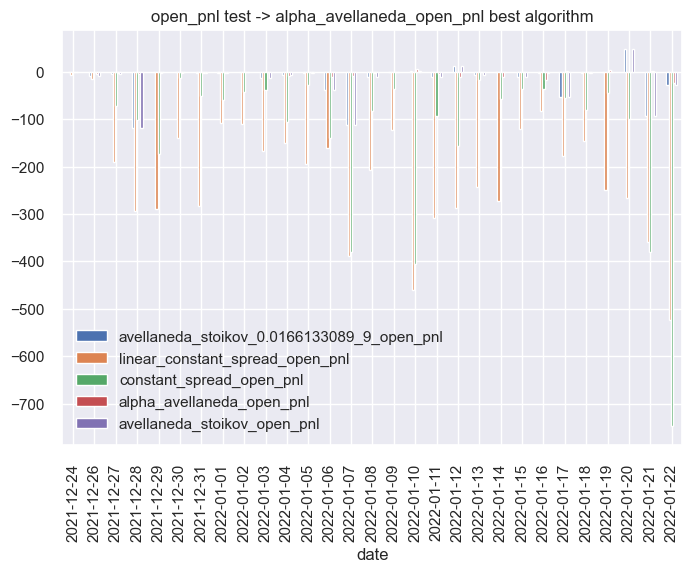

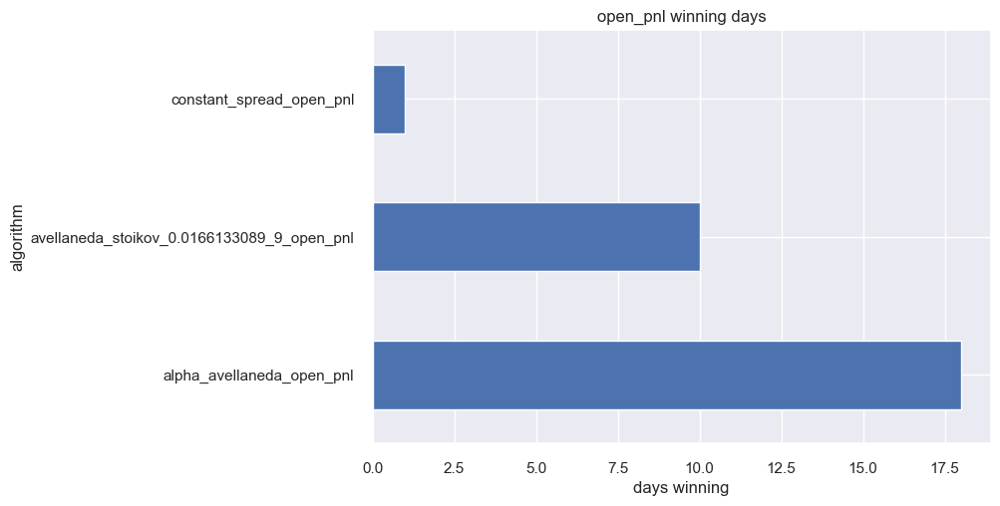

<Figure size 800x550 with 0 Axes>

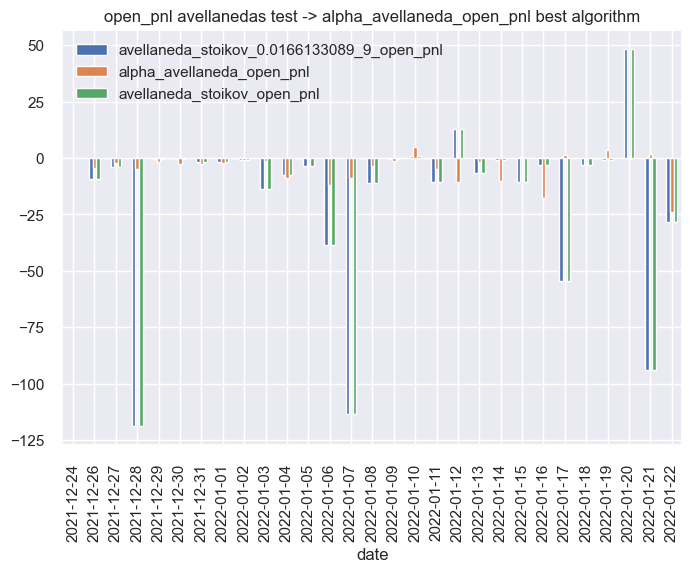

,avellaneda_stoikov_0.0166133089_9_open_pnl,linear_constant_spread_open_pnl,constant_spread_open_pnl,alpha_avellaneda_open_pnl,avellaneda_stoikov_open_pnl
date,,,,,
2021-12-24,-0.134798,-6.057662,-1.279112,0.093669,-0.134798
2021-12-26,-9.472738,-15.602827,-0.814973,-4.265252,-9.472738
2021-12-27,-3.922477,-191.358152,-72.359846,-2.349012,-3.922477
2021-12-28,-118.766242,-294.166463,-100.840252,-4.957117,-118.766242
2021-12-29,-0.352050,-288.869944,-174.356960,-1.746828,-0.352050
2021-12-30,-0.389385,-139.986141,-13.344263,-2.781933,-0.389385
2021-12-31,-1.762249,-282.888979,-52.062010,-2.513987,-1.762249
2022-01-01,-1.965188,-107.198630,-58.649095,-2.266283,-1.965188
2022-01-02,-0.888210,-110.618171,-43.745454,-0.769956,-0.888210


In [51]:
plot_column_results(column_filter='open_pnl')

alpha_avellaneda_close_pnl                     16
avellaneda_stoikov_0.0166133089_9_close_pnl    12
constant_spread_close_pnl                       1
dtype: int64


<Figure size 800x550 with 0 Axes>

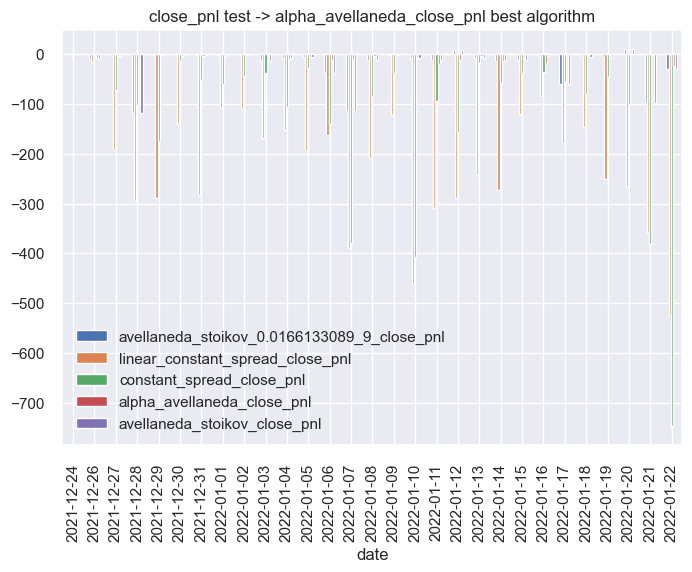

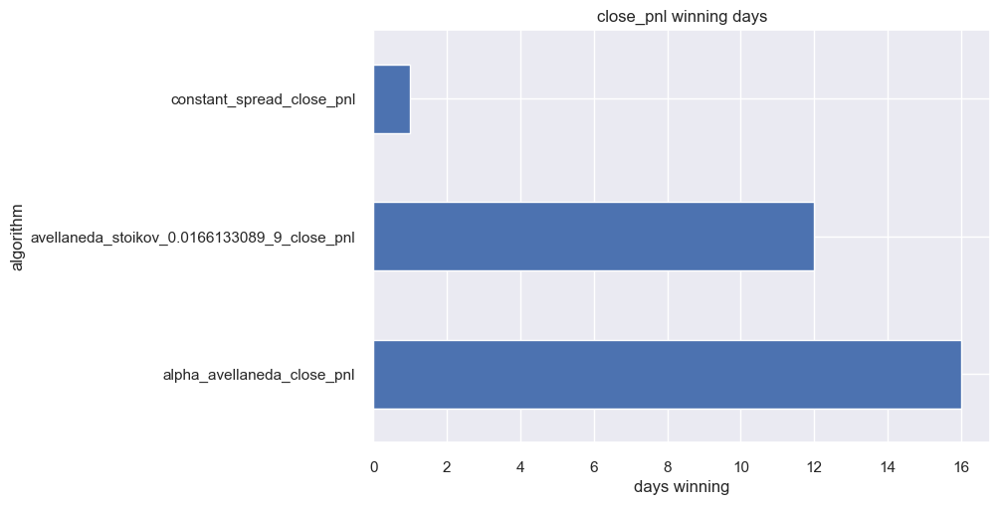

<Figure size 800x550 with 0 Axes>

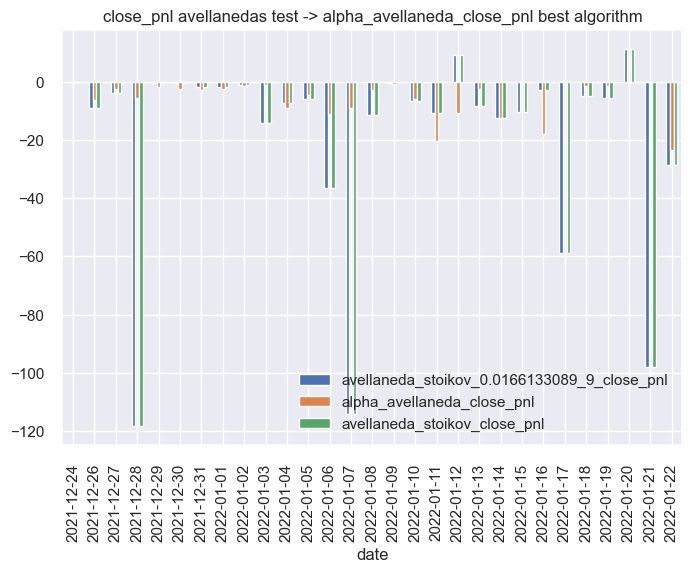

,avellaneda_stoikov_0.0166133089_9_close_pnl,linear_constant_spread_close_pnl,constant_spread_close_pnl,alpha_avellaneda_close_pnl,avellaneda_stoikov_close_pnl
date,,,,,
2021-12-24,-0.256843,-6.110607,-1.404375,-0.174741,-0.256843
2021-12-26,-8.920090,-15.595669,-0.814973,-6.471047,-8.920090
2021-12-27,-3.952739,-191.324338,-72.394001,-2.461978,-3.952739
2021-12-28,-118.246319,-294.303288,-100.818954,-5.630863,-118.246319
2021-12-29,-0.431574,-288.932036,-174.360132,-1.813296,-0.431574
2021-12-30,-0.360293,-139.971471,-13.344263,-2.725681,-0.360293
2021-12-31,-1.909691,-283.210699,-52.192149,-2.978956,-1.909691
2022-01-01,-1.986472,-107.316182,-58.649095,-2.420805,-1.986472
2022-01-02,-1.225893,-110.601675,-43.932963,-1.517309,-1.225893


In [52]:
plot_column_results(column_filter='close_pnl')

### Ratios <a class="anchor" id="ratios"></a>

#### Sharpe <a class="anchor" id="sharpe"></a>

sharpe ratio   =  mean(returns)/std(returns)

avellaneda_stoikov_0.0166133089_9_sharpe    13
alpha_avellaneda_sharpe                     10
constant_spread_sharpe                       6
dtype: int64


<Figure size 800x550 with 0 Axes>

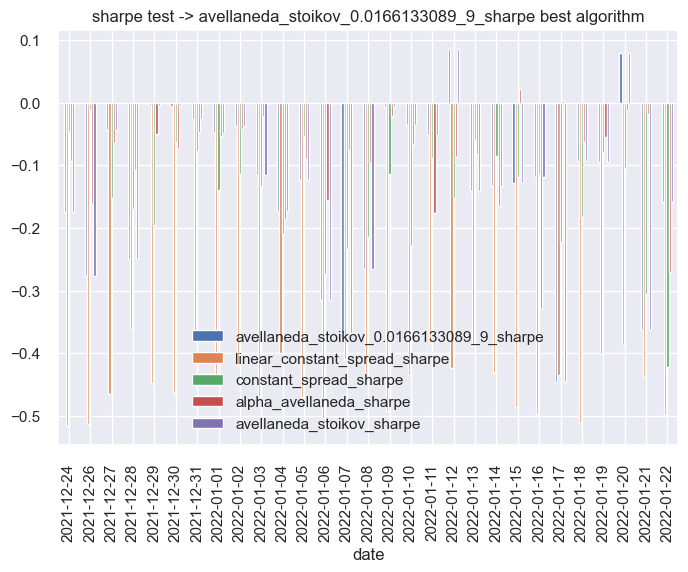

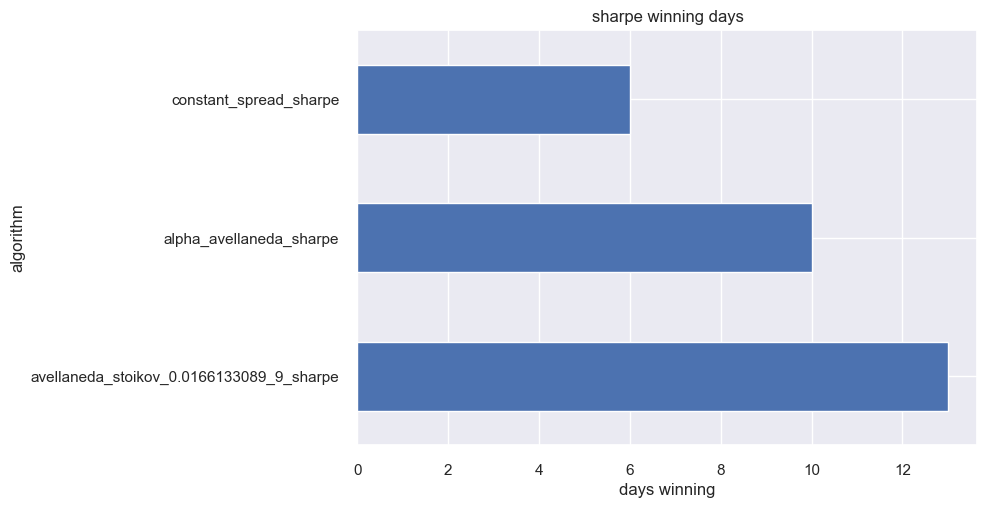

<Figure size 800x550 with 0 Axes>

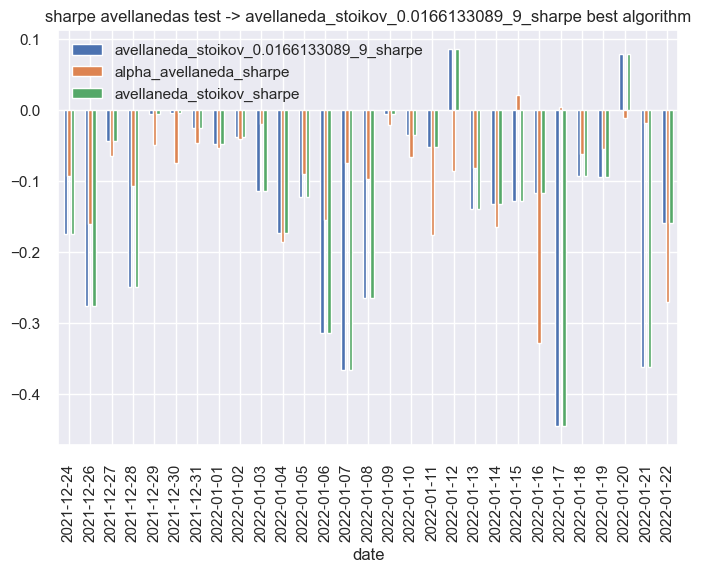

,avellaneda_stoikov_0.0166133089_9_sharpe,linear_constant_spread_sharpe,constant_spread_sharpe,alpha_avellaneda_sharpe,avellaneda_stoikov_sharpe
date,,,,,
2021-12-24,-0.174836,-0.516245,-0.046465,-0.093197,-0.174836
2021-12-26,-0.276817,-0.511873,-0.012016,-0.161088,-0.276817
2021-12-27,-0.043655,-0.464076,-0.152190,-0.065051,-0.043655
2021-12-28,-0.250005,-0.360748,-0.170090,-0.107709,-0.250005
2021-12-29,-0.005905,-0.447342,-0.195637,-0.050103,-0.005905
2021-12-30,-0.004930,-0.463796,-0.062189,-0.074623,-0.004930
2021-12-31,-0.025227,-0.371140,-0.077660,-0.047127,-0.025227
2022-01-01,-0.048887,-0.432513,-0.139594,-0.053793,-0.048887
2022-01-02,-0.037828,-0.418821,-0.112987,-0.041772,-0.037828


In [53]:
plot_column_results(column_filter='sharpe')

#### Pnl map <a class="anchor" id="pnl_map"></a>
PnlToMap  =  OpenPnl/ Mean(Sum(|Inventory|))

alpha_avellaneda_pnl_map                     21
avellaneda_stoikov_0.0166133089_9_pnl_map     8
dtype: int64


<Figure size 800x550 with 0 Axes>

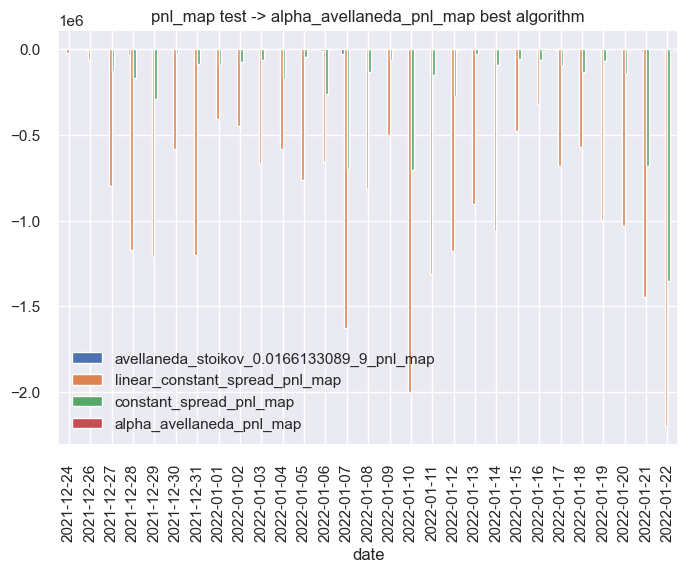

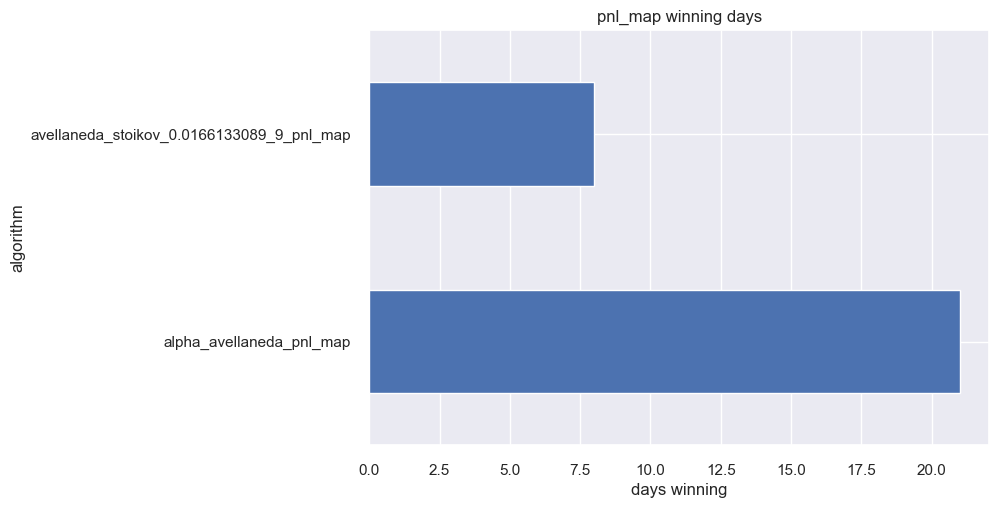

<Figure size 800x550 with 0 Axes>

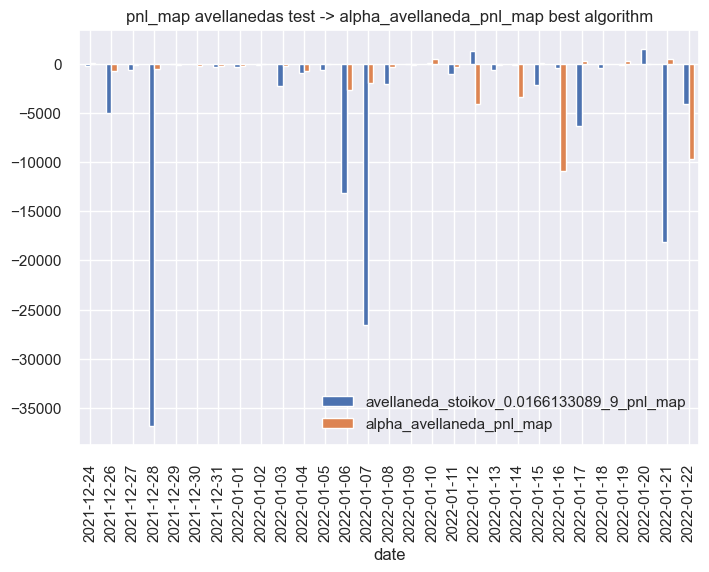

,avellaneda_stoikov_0.0166133089_9_pnl_map,linear_constant_spread_pnl_map,constant_spread_pnl_map,alpha_avellaneda_pnl_map
date,,,,
2021-12-24,-219.666870,-2.549858e+04,-2.050505e+03,49.017863
2021-12-26,-5033.039663,-6.389879e+04,-1.419311e+03,-681.896894
2021-12-27,-603.339202,-7.978490e+05,-1.289486e+05,-97.839701
2021-12-28,-36885.171319,-1.170260e+06,-1.694581e+05,-560.426615
2021-12-29,-42.382487,-1.210979e+06,-2.935832e+05,-105.474743
2021-12-30,-48.988676,-5.849613e+05,-2.272192e+04,-248.626482
2021-12-31,-309.640979,-1.197224e+06,-8.817335e+04,-181.625993
2022-01-01,-315.336830,-4.084600e+05,-9.492489e+04,-163.584609
2022-01-02,-115.210284,-4.500928e+05,-7.566056e+04,-52.677605


In [54]:
plot_column_results(column_filter='pnl_map')

#### Sortino <a class="anchor" id="sortino"></a>
Sortino Ratio  = mean(returns)/std(negative_returns)

avellaneda_stoikov_0.0166133089_9_sortino    13
alpha_avellaneda_sortino                     10
constant_spread_sortino                       6
dtype: int64


<Figure size 800x550 with 0 Axes>

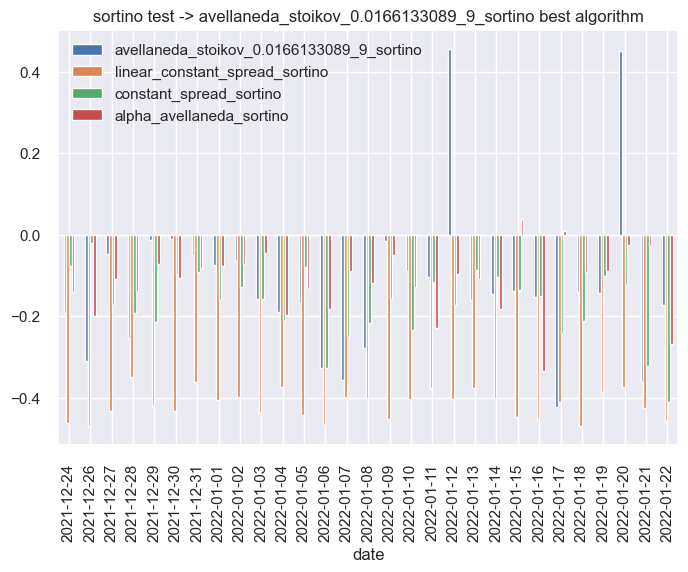

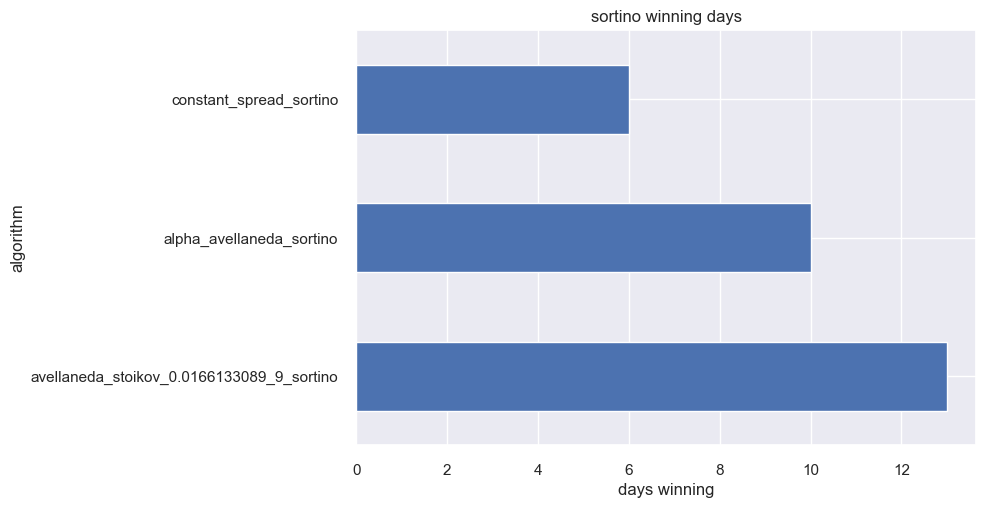

<Figure size 800x550 with 0 Axes>

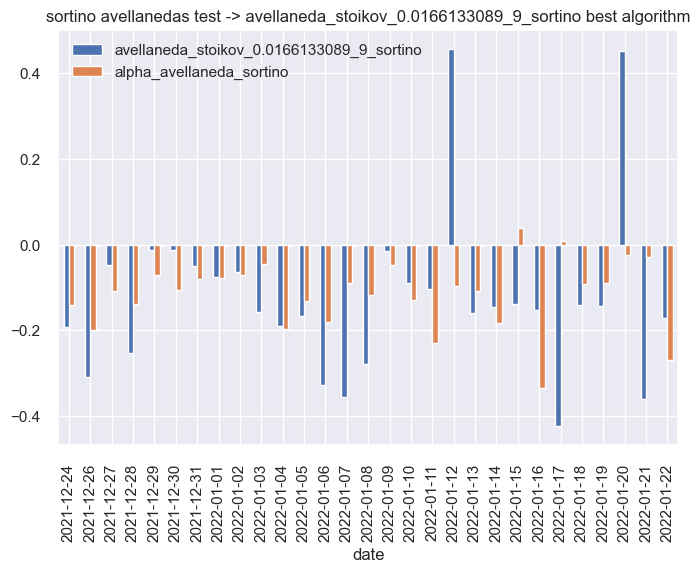

,avellaneda_stoikov_0.0166133089_9_sortino,linear_constant_spread_sortino,constant_spread_sortino,alpha_avellaneda_sortino
date,,,,
2021-12-24,-0.191898,-0.461301,-0.077067,-0.141217
2021-12-26,-0.309219,-0.469574,-0.021024,-0.200040
2021-12-27,-0.047937,-0.433051,-0.171329,-0.107569
2021-12-28,-0.252826,-0.349987,-0.192960,-0.138419
2021-12-29,-0.012859,-0.420592,-0.213976,-0.071123
2021-12-30,-0.011657,-0.432757,-0.095840,-0.106274
2021-12-31,-0.049265,-0.360942,-0.090585,-0.080565
2022-01-01,-0.075444,-0.405331,-0.160521,-0.077050
2022-01-02,-0.064917,-0.397870,-0.129343,-0.070807


In [55]:
plot_column_results(column_filter='sortino')

#### Max Drawdown <a class="anchor" id="dd"></a>
maximum losses we had during the last period , less is better 

alpha_avellaneda_max_drawdown                     22
avellaneda_stoikov_0.0166133089_9_max_drawdown     6
constant_spread_max_drawdown                       1
dtype: int64


<Figure size 800x550 with 0 Axes>

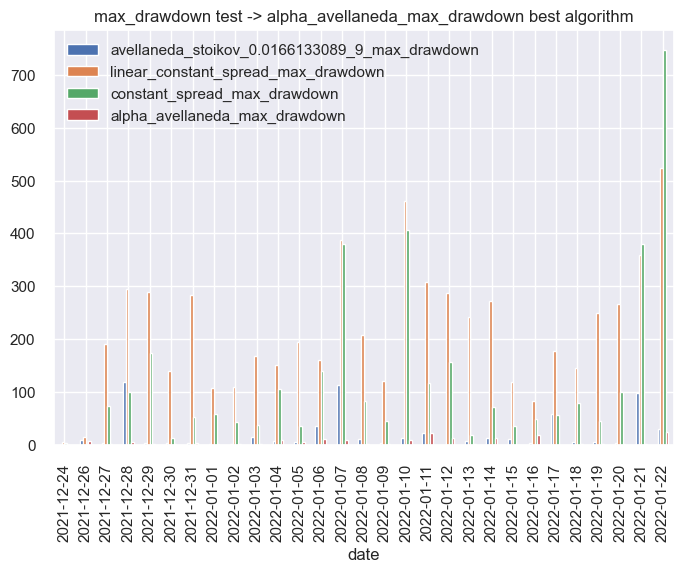

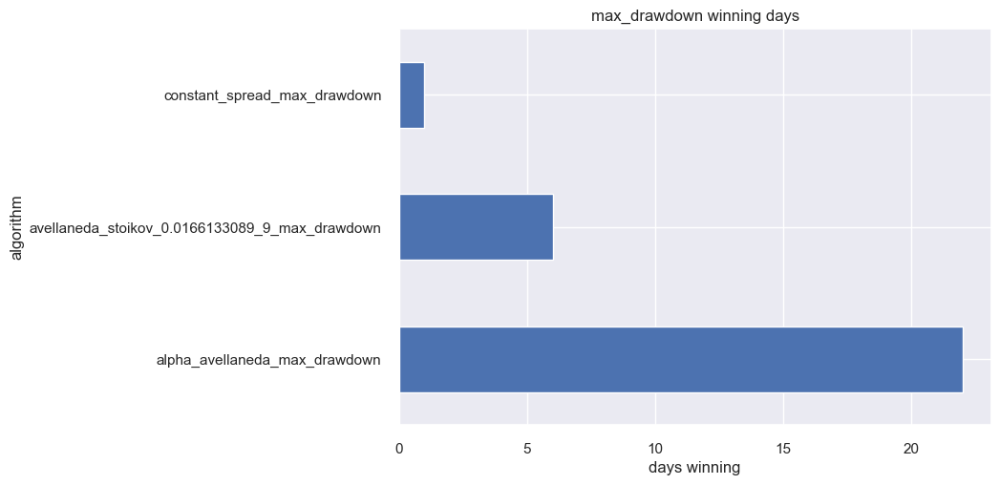

<Figure size 800x550 with 0 Axes>

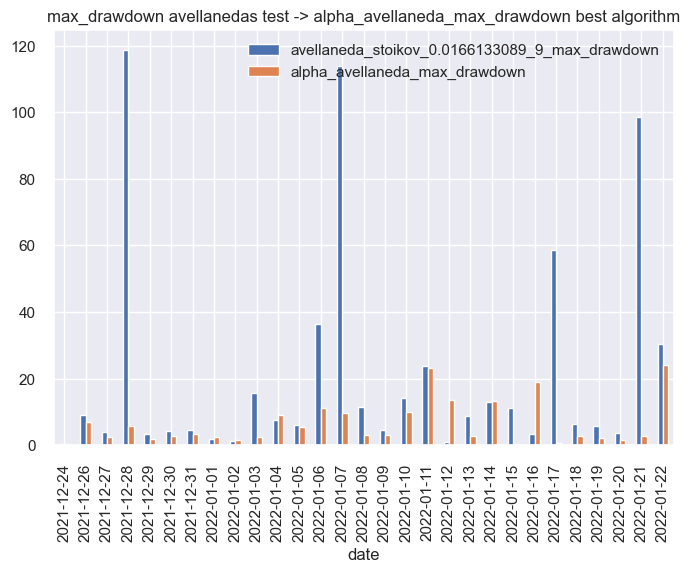

,avellaneda_stoikov_0.0166133089_9_max_drawdown,linear_constant_spread_max_drawdown,constant_spread_max_drawdown,alpha_avellaneda_max_drawdown
date,,,,
2021-12-24,0.335207,6.151874,4.745050,0.318341
2021-12-26,9.142671,15.595669,2.768951,6.978973
2021-12-27,3.977639,191.324338,74.100675,2.462183
2021-12-28,118.807629,294.303288,100.818954,5.822067
2021-12-29,3.203611,288.932036,174.360133,1.920899
2021-12-30,4.207776,139.972394,13.766204,2.870267
2021-12-31,4.494248,283.210699,53.715469,3.442477
2022-01-01,1.992042,107.319735,58.656006,2.426619
2022-01-02,1.317049,110.602352,44.149520,1.577079


In [56]:
plot_column_results(column_filter='max_drawdown')